In [1]:
from PIL import Image
import requests

In [2]:
import numpy as np


In [3]:
import pandas as pd

In [4]:
!pip install --upgrade numpy


Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for numpy from https://files.pythonhosted.org/packages/8b/72/10c1d2d82101c468a28adc35de6c77b308f288cfd0b88e1070f15b98e00c/numpy-2.2.4-cp311-cp311-win_amd64.whl.metadata
  Using cached numpy-2.2.4-cp311-cp311-win_amd64.whl.metadata (60 kB)
Using cached numpy-2.2.4-cp311-cp311-win_amd64.whl (12.9 MB)


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.0 requires FuzzyTM>=0.4.0, which is not installed.
tables 3.8.0 requires blosc2~=2.0.0, which is not installed.
tables 3.8.0 requires cython>=0.29.21, which is not installed.
gradio 4.19.2 requires numpy~=1.0, but you have numpy 2.2.4 which is incompatible.
tensorflow-intel 2.16.1 requires ml-dtypes~=0.3.1, but you have ml-dtypes 0.4.1 which is incompatible.
tensorflow-intel 2.16.1 requires numpy<2.0.0,>=1.23.5; python_version <= "3.11", but you have numpy 2.2.4 which is incompatible.
tensorflow-intel 2.16.1 requires tensorboard<2.17,>=2.16, but you have tensorboard 2.18.0 which is incompatible.
numba 0.57.1 requires numpy<1.25,>=1.21, but you have numpy 2.2.4 which is incompatible.
scipy 

In [5]:
!pip uninstall numpy scipy pandas -y

Found existing installation: numpy 2.2.4
Uninstalling numpy-2.2.4:
  Successfully uninstalled numpy-2.2.4
Found existing installation: scipy 1.11.1
Uninstalling scipy-1.11.1:


ERROR: Exception:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\shutil.py", line 825, in move
    os.rename(src, real_dst)
PermissionError: [WinError 5] Access is denied: 'c:\\programdata\\anaconda3\\lib\\site-packages\\scipy' -> 'C:\\Users\\Pooja\\AppData\\Local\\Temp\\pip-uninstall-_k1_hnqw'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\pip\_internal\cli\base_command.py", line 180, in exc_logging_wrapper
    status = run_func(*args)
             ^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\pip\_internal\commands\uninstall.py", line 105, in run
    uninstall_pathset = req.uninstall(
                        ^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\pip\_internal\req\req_install.py", line 687, in uninstall
    uninstalled_pathset.remove(auto_confirm, verbose)
  File "C:\ProgramData\anaconda3\Lib\site-package

In [6]:
!pip install numpy scipy pandas

Defaulting to user installation because normal site-packages is not writeable


In [7]:
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import math
import time
import re
import os
import seaborn as sns
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity  
from sklearn.metrics import pairwise_distances
from matplotlib import gridspec
from scipy.sparse import hstack
import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

In [8]:
data = pd.read_csv(r"C:\Users\Pooja\OneDrive\Desktop\tops_fashion.csv", encoding="ISO-8859-1")

In [9]:
print ('Number of data points : ', data.shape[0], \
       'Number of features/variables:', data.shape[1])

Number of data points :  10713 Number of features/variables: 17


In [10]:
data.columns

Index(['asin', 'availability', 'availability_type', 'brand', 'color',
       'editorial_reivew', 'editorial_review', 'formatted_price',
       'large_image_url', 'manufacturer', 'medium_image_url', 'model',
       'product_type_name', 'publisher', 'reviews', 'small_image_url',
       'title'],
      dtype='object')

In [11]:
data = data[['asin', 'brand', 'color', 'medium_image_url', 'product_type_name', 'title', 'formatted_price']]

In [12]:
print ('Number of data points : ', data.shape[0], \
       'Number of features:', data.shape[1])
data.head()

Number of data points :  10713 Number of features: 7


,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
0,B075CK82VN,FISACE,NaN,https://images-na.ssl-images-amazon.com/images...,SHIRT,FISACE Women Ombre Long Sleeve Round Neck Spli...,NaN
1,B075CG1KY3,YiRong Fashion T-Shirt,Brown,https://images-na.ssl-images-amazon.com/images...,SHIRT,YiRong Irregular loose round neckline of pure ...,$39.99
2,B075CDQPYV,Fashion Story,NaN,https://images-na.ssl-images-amazon.com/images...,SHIRT,Fashion Story Womens Off Shoulder Blouses Flor...,NaN
3,B075CB9YZV,WIWIQS,NaN,https://images-na.ssl-images-amazon.com/images...,SHIRT,WIWIQS Womens T Shirts Big Girls Irregular Hem...,NaN
4,B075C8RRBJ,signaturetshirts,Mint,https://images-na.ssl-images-amazon.com/images...,SHIRT,"SignatureTshirts Women's Tank-Top,Aloha Beache...",NaN


In [13]:
print(data['product_type_name'].describe())

count     10697
unique       16
top       SHIRT
freq      10344
Name: product_type_name, dtype: object


In [14]:
print(data['product_type_name'].unique())

['SHIRT' 'DRESS' nan 'APPAREL' 'SWEATER' 'OUTERWEAR' 'MISC_OTHER'
 'ACCESSORY' 'PANTS' 'POWERSPORTS_PROTECTIVE_GEAR' 'HAT' 'SKIRT'
 'SPORTING_GOODS' 'SLEEPWEAR' 'UNDERWEAR' 'SHORTS' 'BABY_COSTUME']


In [15]:
product_type_count = Counter(list(data['product_type_name']))
product_type_count.most_common(10)

[('SHIRT', 10344),
 ('APPAREL', 78),
 ('ACCESSORY', 73),
 ('DRESS', 71),
 ('SWEATER', 33),
 ('SLEEPWEAR', 29),
 ('POWERSPORTS_PROTECTIVE_GEAR', 26),
 (nan, 16),
 ('SKIRT', 11),
 ('OUTERWEAR', 8)]

In [16]:
print(data['brand'].describe())

count        10687
unique        1707
top       XiaoShop
freq           110
Name: brand, dtype: object


In [17]:
brand_count = Counter(list(data['brand']))
brand_count.most_common(10)

[('XiaoShop', 110),
 ('Domple', 103),
 ('Reiss', 102),
 ('Capricho', 101),
 ('Be Unique Me', 100),
 ('All Causes', 100),
 ('RUIJIE', 97),
 ('Alion', 97),
 ('WeHeart', 94),
 ('ainr', 93)]

In [18]:
print(data['color'].describe())

count      3761
unique      646
top       Black
freq        648
Name: color, dtype: object


In [19]:
color_count = Counter(list(data['color']))
color_count.most_common(10)

[(nan, 6952),
 ('Black', 648),
 ('White', 378),
 ('Blue', 197),
 ('Pink', 105),
 ('*', 105),
 ('Red', 103),
 ('Navy', 95),
 ('Grey', 81),
 ('Purple', 64)]

In [20]:
print(data['formatted_price'].describe())

count        2159
unique        478
top       $44.99 
freq          131
Name: formatted_price, dtype: object


In [21]:
price_count = Counter(list(data['formatted_price']))
price_count.most_common(10)

[(nan, 8554),
 ('$44.99 ', 131),
 ('$65.99 ', 93),
 ('$19.99 ', 86),
 ('$54.99 ', 72),
 ('$9.99 ', 58),
 ('$14.99 ', 49),
 ('$29.99 ', 43),
 ('$87.99 ', 38),
 ('$109.99 ', 37)]

In [22]:
print(data['title'].describe())

count                                                 10697
unique                                                10293
top       Victoria Scoop Neck Front Lace Floral High-Low...
freq                                                     40
Name: title, dtype: object


In [23]:
data.to_pickle('pickels/180k_apparel_data')

In [24]:
data = data.loc[~data['formatted_price'].isnull()]
print('Number of data points After eliminating price=NULL :', data.shape[0])

Number of data points After eliminating price=NULL : 2159


In [25]:
data =data.loc[~data['color'].isnull()]
print('Number of data points After eliminating color=NULL :', data.shape[0])

Number of data points After eliminating color=NULL : 2158


In [26]:
data.to_pickle('pickels/28k_apparel_data')

In [27]:
data = pd.read_pickle('pickels/28k_apparel_data')
print(sum(data.duplicated('title')))

217


In [28]:
data = pd.read_pickle('pickels/28k_apparel_data')

In [29]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
1,B075CG1KY3,YiRong Fashion T-Shirt,Brown,https://images-na.ssl-images-amazon.com/images...,SHIRT,YiRong Irregular loose round neckline of pure ...,$39.99
43,B075C1C6Y1,Rachel Kate,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,shirts for teen girls,$19.99
53,B075BT5JKZ,MKP Sexy Crop Top,"Black, White",https://images-na.ssl-images-amazon.com/images...,SHIRT,Women Sexy Fashion The Eye Hand Printed Black ...,$8.50
54,B075BSV439,MKP Sexy Crop Top,"Black, White",https://images-na.ssl-images-amazon.com/images...,SHIRT,Women Sexy Fashion The Flower Printed Black Ha...,$8.50
57,B075BSMDY9,Avenue hill,Moka,https://images-na.ssl-images-amazon.com/images...,SHIRT,Womens Cut Off Shoulder Long Sleeve Loose Fit ...,$30.00


In [30]:
data_sorted = data[data['title'].apply(lambda x: isinstance(x, str) and len(x.split()) > 4)]

print("After removal of products with short descriptions:", data_sorted.shape[0])

After removal of products with short descriptions: 2126


In [31]:
data_sorted.sort_values('title',inplace=True, ascending=False)
data_sorted.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
3265,B0756RHHHV,Have,Mustard Yellow and Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens button up shirt with sheer detail,$19.99
10451,B074RGHJR3,Nanon,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,thistle purple Lao Laos Sleeveless Blouse Clas...,$47.00
10548,B074RB9NDV,Nanon,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,thistle purple Lao Laos Sleeveless Blouse Clas...,$47.00
10438,B074RH4HFS,Nanon,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,purple Lao Laos Sleeveless Blouse V Neckline F...,$47.00
4095,B07558S4B6,modbod,Sunset,https://images-na.ssl-images-amazon.com/images...,SHIRT,"modbod | Women's Signature Tank Top | Modal, C...",$10.98


In [32]:
indices = []
for i,row in data_sorted.iterrows():
    indices.append(i)

In [33]:
import itertools
stage1_dedupe_asins = []
i = 0
j = 0
num_data_points = data_sorted.shape[0]
while i < num_data_points and j < num_data_points:
    
    previous_i = i

     
    a = data['title'].loc[indices[i]].split()

    
    j = i+1
    while j < num_data_points:

        
        b = data['title'].loc[indices[j]].split()

        
        length = max(len(a), len(b))

        
        count  = 0

        
        for k in itertools.zip_longest(a,b): 
            if (k[0] == k[1]):
                count += 1

        
        
        if (length - count) > 2:

            stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[i]])

            
            if j == num_data_points-1: stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[j]])

        
            i = j
            break
        else:
            j += 1
    if previous_i == i:
        break

In [34]:
data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

In [35]:
data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

In [36]:
data.to_pickle('pickels/17k_apperal_data')

In [37]:
data = pd.read_pickle('pickels/17k_apperal_data')

In [38]:
indices = []
for i,row in data.iterrows():
    indices.append(i)

stage2_dedupe_asins = []
while len(indices)!=0:
    i = indices.pop()
    stage2_dedupe_asins.append(data['asin'].loc[i])
    
    a = data['title'].loc[i].split()
    
    for j in indices:
        
        b = data['title'].loc[j].split()
        
        
        length = max(len(a),len(b))
        
        
        count  = 0

        for k in itertools.zip_longest(a,b): 
            if (k[0]==k[1]):
                count += 1

        
        if (length - count) < 3:
            indices.remove(j)

In [39]:
data = data.loc[data['asin'].isin(stage2_dedupe_asins)]

In [40]:
print('Number of data points after stage two of dedupe: ',data.shape[0])

Number of data points after stage two of dedupe:  1089


In [41]:
data.to_pickle('pickels/16k_apperal_data')

In [42]:
data = pd.read_pickle('pickels/16k_apperal_data')

In [43]:
stop_words = set(stopwords.words('english'))
print ('list of stop words:', stop_words)

def nlp_preprocessing(total_text, index, column):
    if type(total_text) is not int:
        string = ""
        for words in total_text.split():
           
            word = ("".join(e for e in words if e.isalnum()))
            word = word.lower()
            
            if not word in stop_words:
                string += word + " "
        data[column][index] = string

list of stop words: {'all', 'between', "shan't", "hasn't", 'won', 'by', 'nor', 'in', 'just', 'didn', 'no', 'her', 'not', 'are', 'don', 'aren', 'down', "doesn't", 'have', "you're", "they've", "we'll", 'very', 'each', 'the', 'into', 'why', 'yourself', 'needn', 'only', 'same', 'so', 'there', "we're", 'during', 'but', 'himself', 'will', "aren't", 'those', 'ours', 'she', 'before', 'him', 'haven', "mightn't", 'hers', 'then', 'yours', "weren't", "she'd", "shouldn't", 'ma', "i'm", 'wasn', 's', 'shan', 'these', 'after', 'should', 'too', 'such', 'mustn', 'hadn', 'itself', "she's", 'shouldn', 'doesn', 'out', "they'll", 'we', 'because', 'doing', 've', 'who', 'does', 'mightn', 'what', 'they', 'were', 'when', 'is', 'with', 't', 'some', "wasn't", 'than', 'was', "we've", 'how', 'i', 'whom', "won't", 'theirs', "wouldn't", 'over', "they're", 'herself', 'our', 'been', 'themselves', 'ain', 'if', 'y', "haven't", 'other', "couldn't", 'it', 'until', 'hasn', 'own', 'again', "we'd", 'and', "you'd", 'yourselves

In [44]:
import time

start_time = time.time() 

for index, row in data.iterrows():
    nlp_preprocessing(row['title'], index, 'title')

print(time.time() - start_time, "seconds")


0.5400419235229492 seconds


In [45]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
1,B075CG1KY3,YiRong Fashion T-Shirt,Brown,https://images-na.ssl-images-amazon.com/images...,SHIRT,yirong irregular loose round neckline pure col...,$39.99
53,B075BT5JKZ,MKP Sexy Crop Top,"Black, White",https://images-na.ssl-images-amazon.com/images...,SHIRT,women sexy fashion eye hand printed black halt...,$8.50
58,B075BSL8SF,Avenue hill,Moka,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens cut shoulder long sleeve loose fit swea...,$30.00
78,B075BPCS6X,SPACER,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,white fawn hairy sweater tee black xlarge,$24.99
89,B075BNLH2G,Fresh Produce,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,fresh produce sunset sky pullover white one si...,$59.00


In [46]:
data.to_pickle('pickels/16k_apperal_data_preprocessed')

In [47]:
from nltk.stem.porter import *
stemmer = PorterStemmer()
print(stemmer.stem('arguing'))
print(stemmer.stem('fishing'))

argu
fish


In [48]:
data = pd.read_pickle('pickels/16k_apperal_data_preprocessed')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
1,B075CG1KY3,YiRong Fashion T-Shirt,Brown,https://images-na.ssl-images-amazon.com/images...,SHIRT,yirong irregular loose round neckline pure col...,$39.99
53,B075BT5JKZ,MKP Sexy Crop Top,"Black, White",https://images-na.ssl-images-amazon.com/images...,SHIRT,women sexy fashion eye hand printed black halt...,$8.50
58,B075BSL8SF,Avenue hill,Moka,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens cut shoulder long sleeve loose fit swea...,$30.00
78,B075BPCS6X,SPACER,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,white fawn hairy sweater tee black xlarge,$24.99
89,B075BNLH2G,Fresh Produce,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,fresh produce sunset sky pullover white one si...,$59.00


In [49]:
def display_img(url,ax,fig):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    plt.imshow(img)
  

def plot_heatmap(keys, values, labels, url, text):
        
        gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[4,1]) 
        fig = plt.figure(figsize=(25,3))
        
        ax = plt.subplot(gs[0])
        ax = sns.heatmap(np.array([values]), annot=np.array([labels]))
        ax.set_xticklabels(keys) 
        ax.set_title(text)
        
        ax = plt.subplot(gs[1])
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        
    
        display_img(url, ax, fig)
        
    
        plt.show()
    
def plot_heatmap_image(doc_id, vec1, vec2, url, text, model):

   
    intersection = set(vec1.keys()) & set(vec2.keys()) 

   
    for i in vec2:
        if i not in intersection:
            vec2[i]=0

   
    keys = list(vec2.keys())
    
    values = [vec2[x] for x in vec2.keys()]
    

    if model == 'bag_of_words':
        labels = values
    elif model == 'tfidf':
        labels = []
        for x in vec2.keys():
            
            if x in  tfidf_title_vectorizer.vocabulary_:
                labels.append(tfidf_title_features[doc_id, tfidf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)
    elif model == 'idf':
        labels = []
        for x in vec2.keys():
           
            if x in  idf_title_vectorizer.vocabulary_:
                labels.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)

    plot_heatmap(keys, values, labels, url, text)



def text_to_vector(text):
    word = re.compile(r'\w+')
    words = word.findall(text)

    return Counter(words) 



def get_result(doc_id, content_a, content_b, url, model):
    text1 = content_a
    text2 = content_b
    
    
    vector1 = text_to_vector(text1)

   
    vector2 = text_to_vector(text2)

    plot_heatmap_image(doc_id, vector1, vector2, url, text2, model)

In [50]:
from sklearn.feature_extraction.text import CountVectorizer
title_vectorizer = CountVectorizer()
title_features   = title_vectorizer.fit_transform(data['title'])
title_features.get_shape()

(1089, 1856)

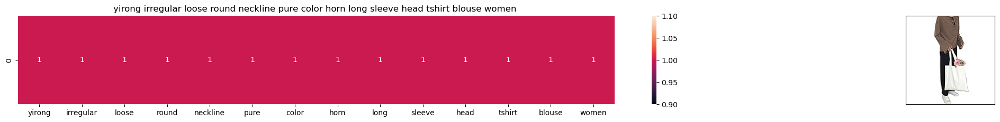

ASIN : B075CG1KY3
Brand: YiRong Fashion T-Shirt
Title: yirong irregular loose round neckline pure color horn long sleeve head tshirt blouse women 
Euclidean similarity with the query image: 0.0


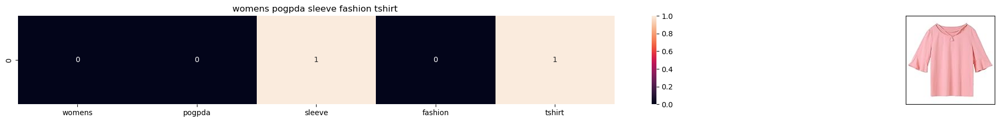

ASIN : B074VX8Y8D
Brand: SNOW
Title: womens pogpda sleeve fashion tshirt 
Euclidean similarity with the query image: 3.872983346207417


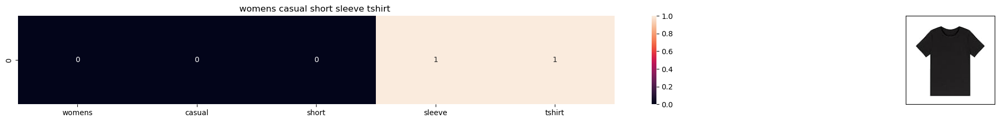

ASIN : B074T9KG9Q
Brand: Rain
Title: womens casual short sleeve tshirt 
Euclidean similarity with the query image: 3.872983346207417


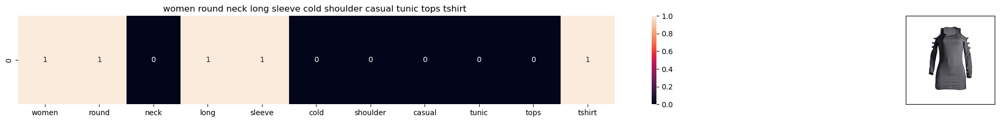

ASIN : B07542K3BB
Brand: YF
Title: women round neck long sleeve cold shoulder casual tunic tops tshirt 
Euclidean similarity with the query image: 3.872983346207417


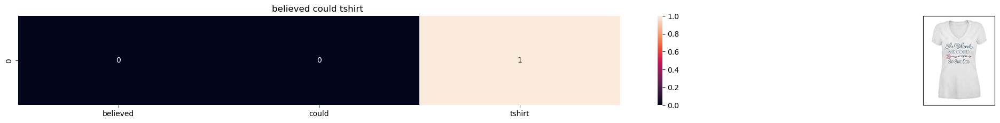

ASIN : B07568NZX4
Brand: Rustic Grace
Title: believed could tshirt 
Euclidean similarity with the query image: 3.872983346207417


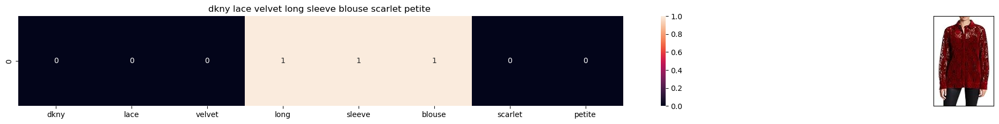

ASIN : B074S3KNBN
Brand: DKNY
Title: dkny lace velvet long sleeve blouse scarlet petite 
Euclidean similarity with the query image: 4.0


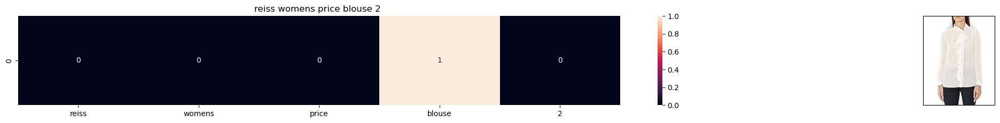

ASIN : B07579BJ3H
Brand: Reiss
Title: reiss womens price blouse 2 
Euclidean similarity with the query image: 4.0


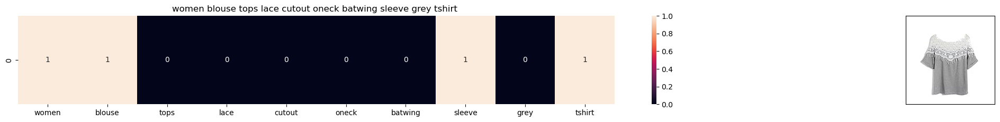

ASIN : B0759BFJ9S
Brand: ECYC
Title: women blouse tops lace cutout oneck batwing sleeve grey tshirt 
Euclidean similarity with the query image: 4.0


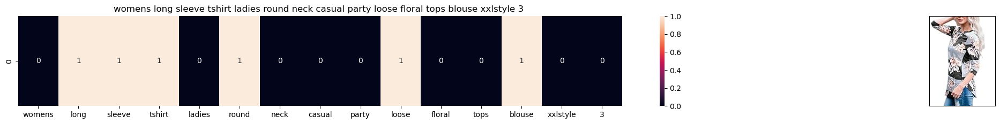

ASIN : B0756YKY75
Brand: Lantch
Title: womens long sleeve tshirt ladies round neck casual party loose floral tops blouse xxlstyle 3 
Euclidean similarity with the query image: 4.0


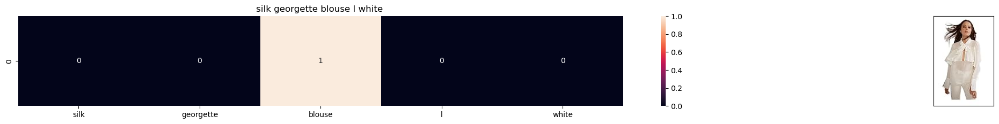

ASIN : B074R9MRKY
Brand: Cynthia Rowley
Title: silk georgette blouse l white 
Euclidean similarity with the query image: 4.0


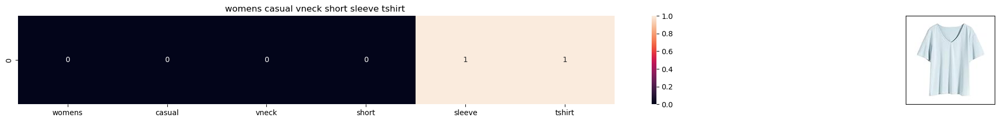

ASIN : B074V45DCX
Brand: Rain
Title: womens casual vneck short sleeve tshirt 
Euclidean similarity with the query image: 4.0


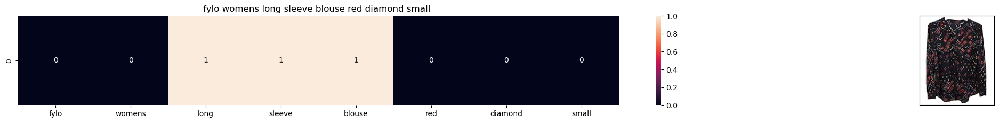

ASIN : B07531SBSJ
Brand: Fylo
Title: fylo womens long sleeve blouse red diamond small 
Euclidean similarity with the query image: 4.0


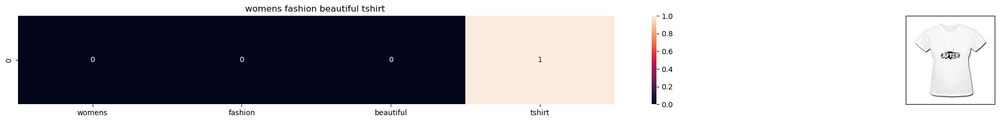

ASIN : B074VMNZN9
Brand: simple
Title: womens fashion beautiful tshirt 
Euclidean similarity with the query image: 4.0


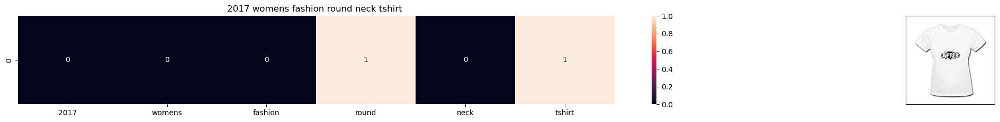

ASIN : B074VWLBMV
Brand: Fradarice
Title: 2017 womens fashion round neck tshirt 
Euclidean similarity with the query image: 4.0


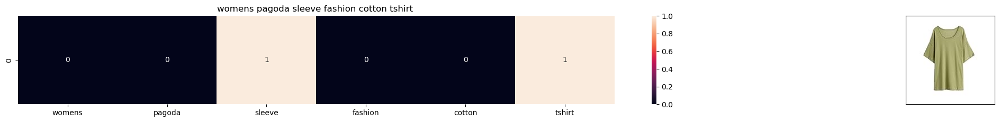

ASIN : B074W25L13
Brand: SNOW
Title: womens pagoda sleeve fashion cotton tshirt 
Euclidean similarity with the query image: 4.0


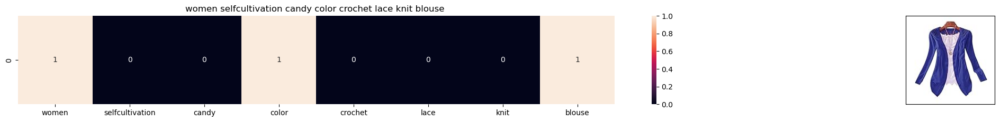

ASIN : B075446WC9
Brand: Rbwinner
Title: women selfcultivation candy color crochet lace knit blouse 
Euclidean similarity with the query image: 4.0


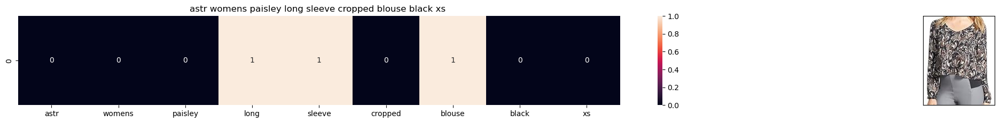

ASIN : B074TV61MZ
Brand: ASTR
Title: astr womens paisley long sleeve cropped blouse black xs 
Euclidean similarity with the query image: 4.123105625617661


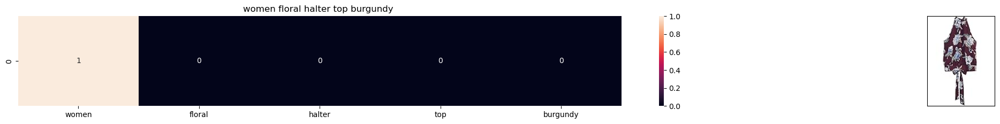

ASIN : B07527W8NX
Brand: Fashion Magazine
Title: women floral halter top burgundy 
Euclidean similarity with the query image: 4.123105625617661


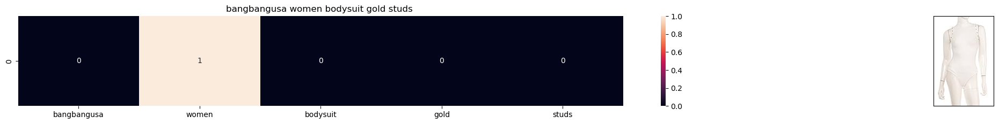

ASIN : B075193QK5
Brand: Solution Clothing
Title: bangbangusa women bodysuit gold studs 
Euclidean similarity with the query image: 4.123105625617661


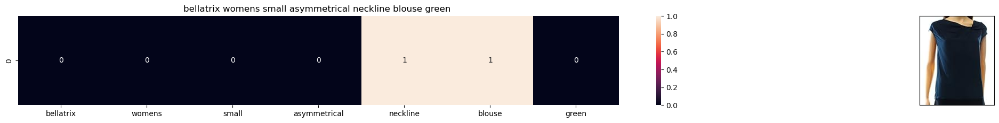

ASIN : B074TTCZ1L
Brand: bellatrix
Title: bellatrix womens small asymmetrical neckline blouse green 
Euclidean similarity with the query image: 4.123105625617661


In [51]:
def bag_of_words_model(doc_id, num_results):
    
    if doc_id < 0 or doc_id >= title_features.shape[0]:
        print(f"Error: doc_id {doc_id} is out of range.")
        return

    
    pairwise_dist = pairwise_distances(title_features, title_features[doc_id])

    
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])

 
    for i in range(len(indices)):
        get_result(indices[i], data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], 
                   data['medium_image_url'].loc[df_indices[i]], 'bag_of_words')
        print('ASIN :', data['asin'].loc[df_indices[i]])
        print('Brand:', data['brand'].loc[df_indices[i]])
        print('Title:', data['title'].loc[df_indices[i]])
        print('Euclidean similarity with the query image:', pdists[i])
        print('=' * 60)

bag_of_words_model(0, 20)

In [52]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_title_vectorizer = TfidfVectorizer(min_df=1)

tfidf_title_features = tfidf_title_vectorizer.fit_transform(data['title'])

In [53]:
print("Max valid index for tfidf_title_features:", tfidf_title_features.shape[0] - 1)
print("Max valid index for data:", data.shape[0] - 1)

Max valid index for tfidf_title_features: 1088
Max valid index for data: 1088


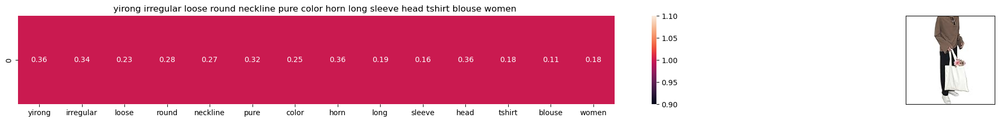

ASIN : B075CG1KY3
BRAND : YiRong Fashion T-Shirt
Euclidean distance from the given image : 0.0


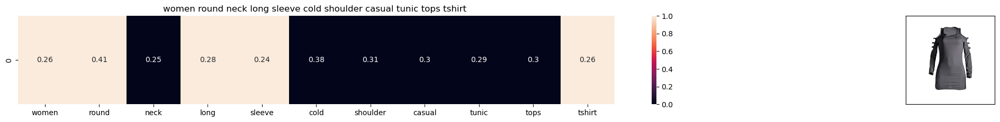

ASIN : B07542K3BB
BRAND : YF
Euclidean distance from the given image : 1.1823793084964935


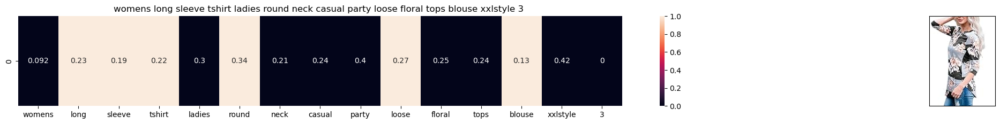

ASIN : B0756YKY75
BRAND : Lantch
Euclidean distance from the given image : 1.197637997564262


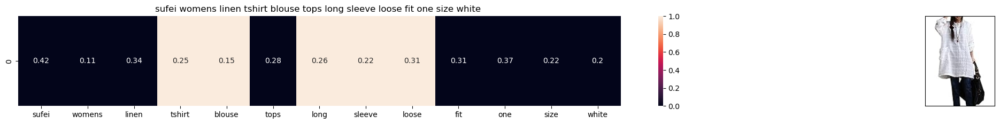

ASIN : B074SPFNSW
BRAND : Sufei
Euclidean distance from the given image : 1.251592431331035


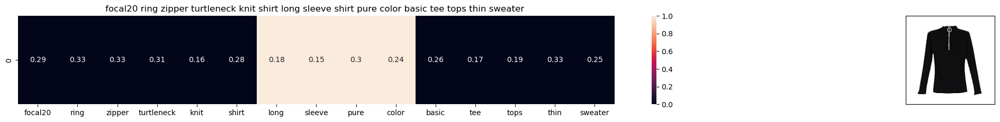

ASIN : B074TDBRG9
BRAND : Focal20
Euclidean distance from the given image : 1.2542743840848947


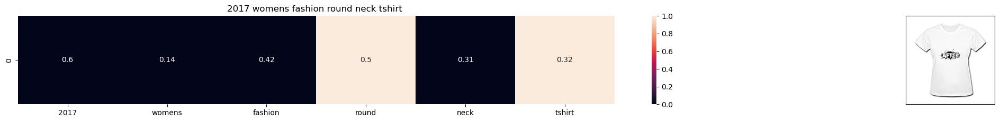

ASIN : B074VWLBMV
BRAND : Fradarice
Euclidean distance from the given image : 1.264722086055394


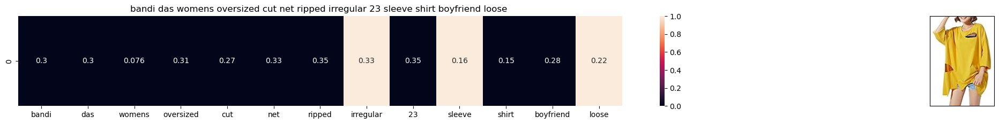

ASIN : B074V7TY2B
BRAND : bandi das
Euclidean distance from the given image : 1.2748625637596995


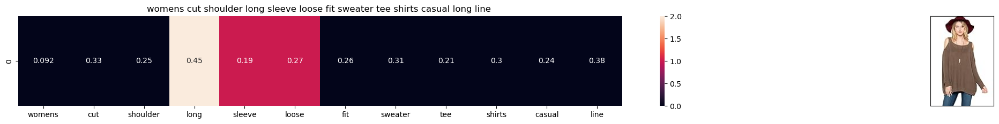

ASIN : B075BSL8SF
BRAND : Avenue hill
Euclidean distance from the given image : 1.2834332890786582


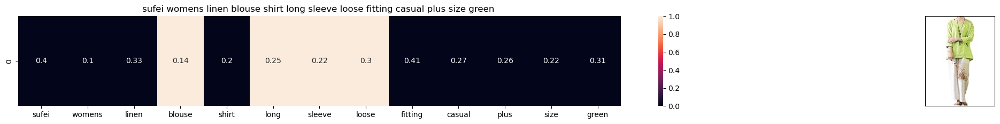

ASIN : B074SVS1HY
BRAND : Sufei
Euclidean distance from the given image : 1.2913463946976969


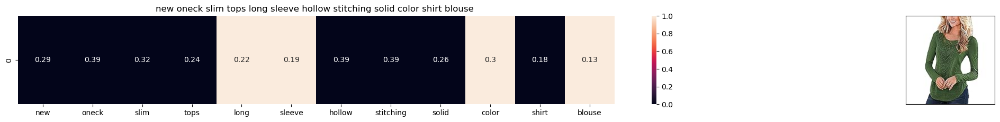

ASIN : B0754WQ2WZ
BRAND : Rbwinner
Euclidean distance from the given image : 1.294462338901679


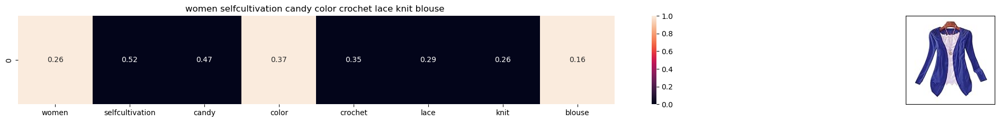

ASIN : B075446WC9
BRAND : Rbwinner
Euclidean distance from the given image : 1.2968262540157307


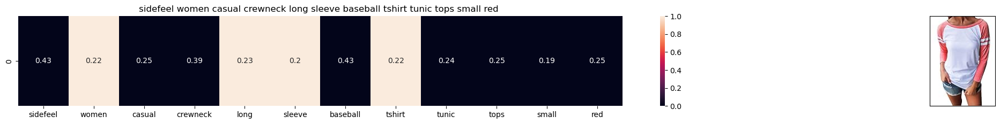

ASIN : B074V6JC9V
BRAND : Sidefeel
Euclidean distance from the given image : 1.299973637812736


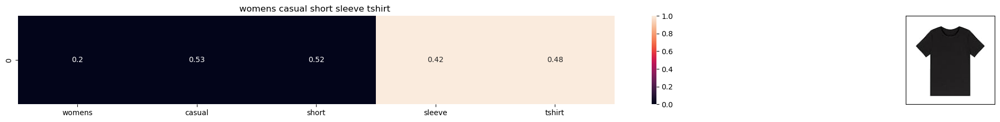

ASIN : B074T9KG9Q
BRAND : Rain
Euclidean distance from the given image : 1.3001128011643028


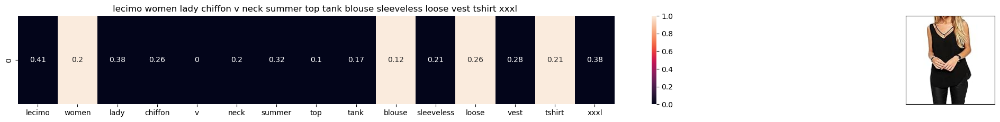

ASIN : B075B13FYX
BRAND : lecimo
Euclidean distance from the given image : 1.3074373231436893


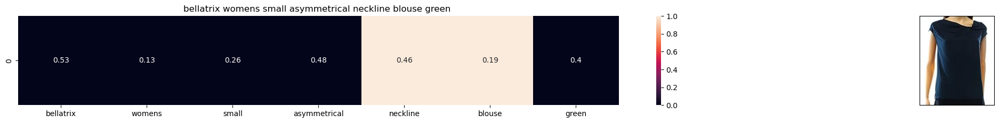

ASIN : B074TTCZ1L
BRAND : bellatrix
Euclidean distance from the given image : 1.3093439402476774


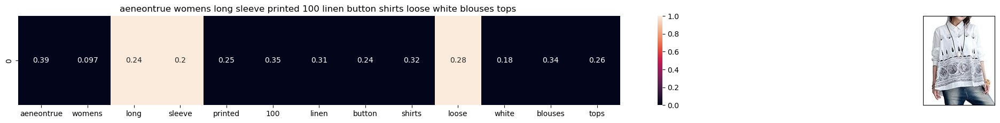

ASIN : B074TZFMFN
BRAND : Aeneontrue
Euclidean distance from the given image : 1.3105684760620087


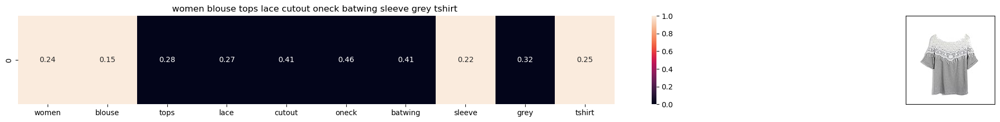

ASIN : B0759BFJ9S
BRAND : ECYC
Euclidean distance from the given image : 1.3111038782757334


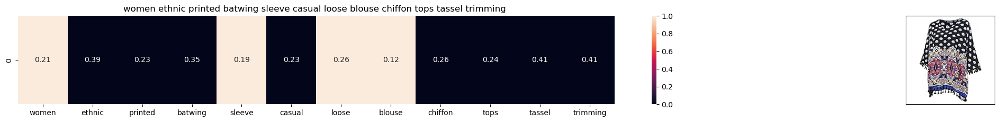

ASIN : B0756XX78Q
BRAND : Yiwa
Euclidean distance from the given image : 1.312385731417825


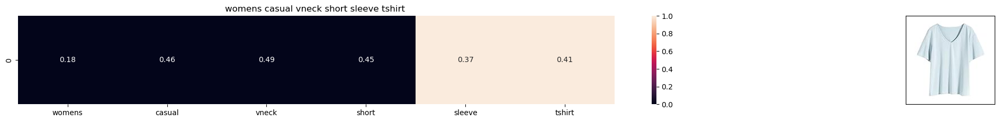

ASIN : B074V45DCX
BRAND : Rain
Euclidean distance from the given image : 1.3153180951250938


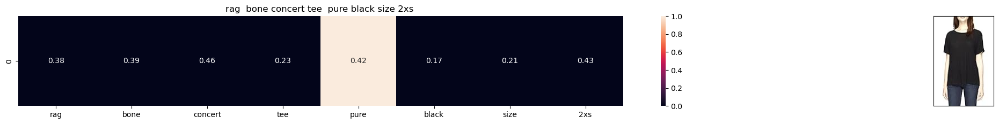

ASIN : B0753LRD5X
BRAND : rag & bone
Euclidean distance from the given image : 1.3161435239098123


In [54]:
def tfidf_model(doc_id, num_results):
   
    if doc_id < 0 or doc_id >= tfidf_title_features.shape[0]:
        print(f"Error: doc_id {doc_id} is out of range.")
        return

    
    pairwise_dist = pairwise_distances(tfidf_title_features, tfidf_title_features[doc_id])

   
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])

  
    for i in range(len(indices)):
        get_result(
            indices[i],
            data['title'].loc[df_indices[0]],
            data['title'].loc[df_indices[i]],
            data['medium_image_url'].loc[df_indices[i]],
            'tfidf'
        )
        print('ASIN :', data['asin'].loc[df_indices[i]])
        print('BRAND :', data['brand'].loc[df_indices[i]])
        print('Euclidean distance from the given image :', pdists[i])
        print('=' * 125)


tfidf_model(0, 20)

In [55]:
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])


In [56]:
def n_containing(word):
    
    return sum(1 for blob in data['title'] if word in blob.split())

def idf(word):
    
    return math.log(data.shape[0] / (n_containing(word)))

In [57]:
idf_title_features = idf_title_features.astype(float)

for i in idf_title_vectorizer.vocabulary_.keys():
   
    idf_val = idf(i)
    
   
    for j in idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:
        
       
        idf_title_features[j,idf_title_vectorizer.vocabulary_[i]] = idf_val

In [58]:
print("Max valid index for idf_title_features:", idf_title_features.shape[0] - 1)
print("Max valid index for data:", data.shape[0] - 1)

Max valid index for idf_title_features: 1088
Max valid index for data: 1088


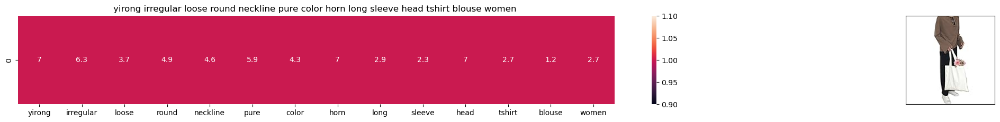

ASIN : B075CG1KY3
Brand : YiRong Fashion T-Shirt
Euclidean distance from the given image: 0.0


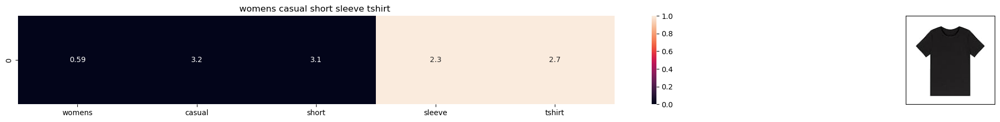

ASIN : B074T9KG9Q
Brand : Rain
Euclidean distance from the given image: 18.3151192362956


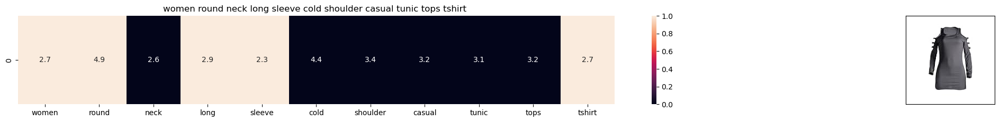

ASIN : B07542K3BB
Brand : YF
Euclidean distance from the given image: 18.517170221534833


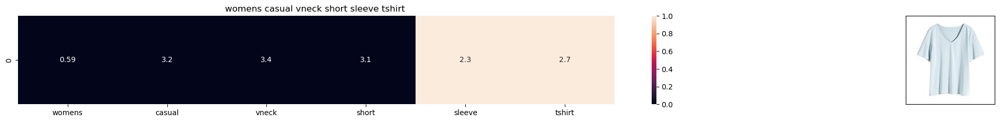

ASIN : B074V45DCX
Brand : Rain
Euclidean distance from the given image: 18.634944257095565


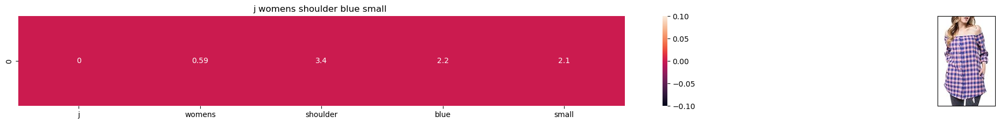

ASIN : B07583CQFT
Brand : Very J
Euclidean distance from the given image: 18.69766782810807


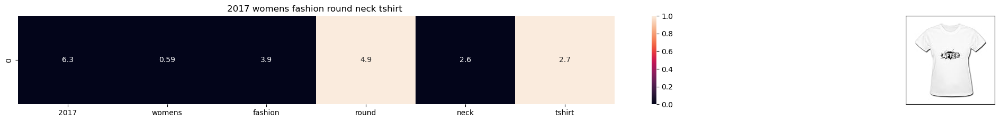

ASIN : B074VWLBMV
Brand : Fradarice
Euclidean distance from the given image: 18.923285212200987


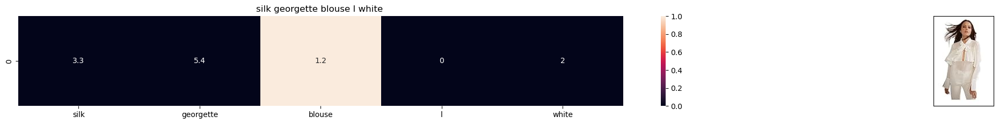

ASIN : B074R9MRKY
Brand : Cynthia Rowley
Euclidean distance from the given image: 19.26051447605659


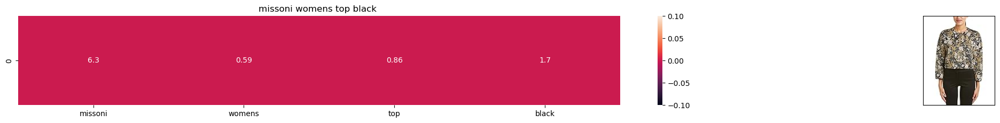

ASIN : B074TSFJHM
Brand : M Missoni
Euclidean distance from the given image: 19.288894470272606


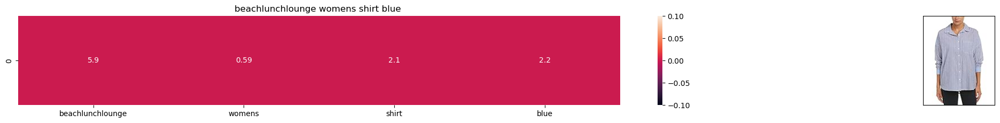

ASIN : B074SZ54KJ
Brand : Beach Lunch Lounge
Euclidean distance from the given image: 19.3077251593331


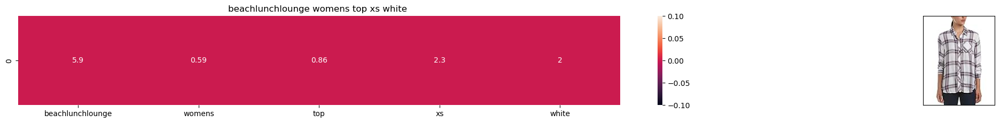

ASIN : B0753KYMLQ
Brand : Beach Lunch Lounge
Euclidean distance from the given image: 19.330586925714943


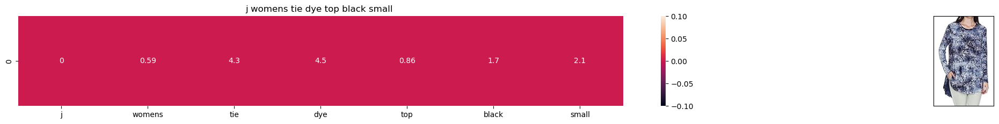

ASIN : B075831F14
Brand : Very J
Euclidean distance from the given image: 19.37975098575857


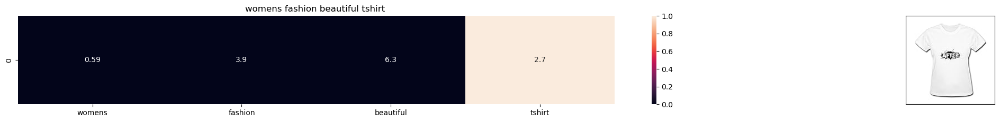

ASIN : B074VMNZN9
Brand : simple
Euclidean distance from the given image: 19.382184301794403


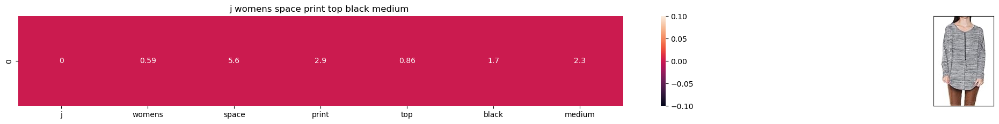

ASIN : B0757ZPH1T
Brand : Very J
Euclidean distance from the given image: 19.435755582667095


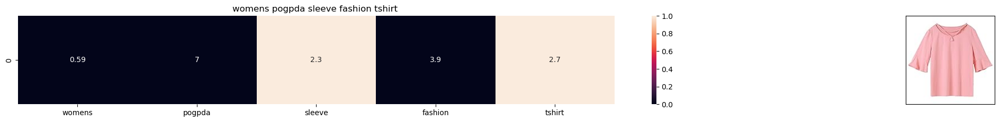

ASIN : B074VX8Y8D
Brand : SNOW
Euclidean distance from the given image: 19.479632138541486


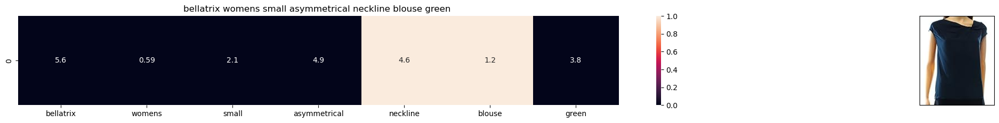

ASIN : B074TTCZ1L
Brand : bellatrix
Euclidean distance from the given image: 19.510512463201927


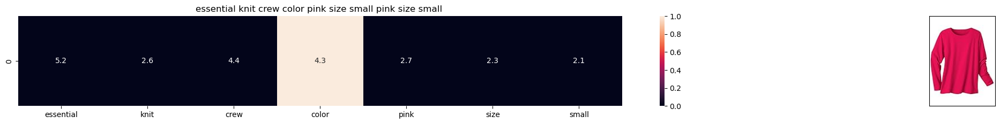

ASIN : B0752R2PSM
Brand : Carol Wright Gifts
Euclidean distance from the given image: 19.516424137981062


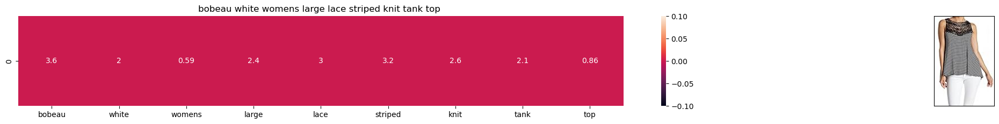

ASIN : B0758TYBLZ
Brand : Bobeau
Euclidean distance from the given image: 19.563741368482088


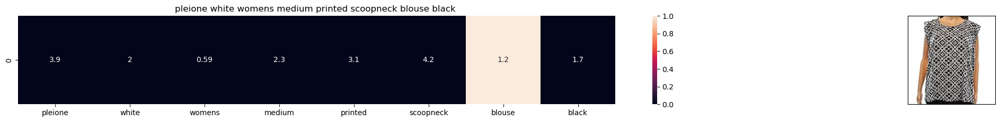

ASIN : B074VB3LTP
Brand : Pleione
Euclidean distance from the given image: 19.566837070739208


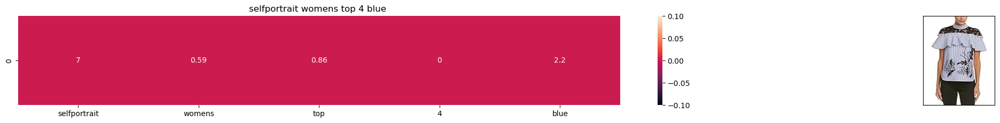

ASIN : B0753LB49H
Brand : Self-Portrait
Euclidean distance from the given image: 19.57317413628853


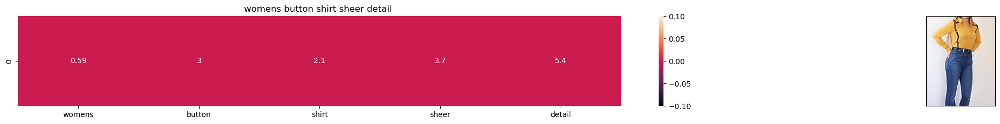

ASIN : B0756RHHHV
Brand : Have
Euclidean distance from the given image: 19.62582974902241


In [59]:
def idf_model(doc_id, num_results):
    
    if doc_id < 0 or doc_id >= idf_title_features.shape[0]:
        print(f"Error: doc_id {doc_id} is out of range.")
        return

  
    pairwise_dist = pairwise_distances(idf_title_features, idf_title_features[doc_id])

   
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])

   
    for i in range(len(indices)):
        get_result(
            indices[i],
            data['title'].loc[df_indices[0]],
            data['title'].loc[df_indices[i]],
            data['medium_image_url'].loc[df_indices[i]],
            'idf'
        )
        print('ASIN :', data['asin'].loc[df_indices[i]])
        print('Brand :', data['brand'].loc[df_indices[i]])
        print('Euclidean distance from the given image:', pdists[i])
        print('=' * 125)


idf_model(0, 20)

In [60]:
from gensim.models import KeyedVectors
import pickle

model_path = "C:\GoogleNews-vectors-negative300.bin\GoogleNews-vectors-negative300.bin"


model = KeyedVectors.load_word2vec_format(model_path, binary=True)


print(model['king'])  


corpus_words = ['word1', 'word2', 'word3']
corpus_vectors = {word: model[word] for word in corpus_words if word in model}


with open('corpus_vectors.pkl', 'wb') as f:
    pickle.dump(corpus_vectors, f)


[ 1.25976562e-01  2.97851562e-02  8.60595703e-03  1.39648438e-01
 -2.56347656e-02 -3.61328125e-02  1.11816406e-01 -1.98242188e-01
  5.12695312e-02  3.63281250e-01 -2.42187500e-01 -3.02734375e-01
 -1.77734375e-01 -2.49023438e-02 -1.67968750e-01 -1.69921875e-01
  3.46679688e-02  5.21850586e-03  4.63867188e-02  1.28906250e-01
  1.36718750e-01  1.12792969e-01  5.95703125e-02  1.36718750e-01
  1.01074219e-01 -1.76757812e-01 -2.51953125e-01  5.98144531e-02
  3.41796875e-01 -3.11279297e-02  1.04492188e-01  6.17675781e-02
  1.24511719e-01  4.00390625e-01 -3.22265625e-01  8.39843750e-02
  3.90625000e-02  5.85937500e-03  7.03125000e-02  1.72851562e-01
  1.38671875e-01 -2.31445312e-01  2.83203125e-01  1.42578125e-01
  3.41796875e-01 -2.39257812e-02 -1.09863281e-01  3.32031250e-02
 -5.46875000e-02  1.53198242e-02 -1.62109375e-01  1.58203125e-01
 -2.59765625e-01  2.01416016e-02 -1.63085938e-01  1.35803223e-03
 -1.44531250e-01 -5.68847656e-02  4.29687500e-02 -2.46582031e-02
  1.85546875e-01  4.47265

In [61]:
def get_word_vec(sentence, doc_id, m_name):
  
    vec = []
    for i in sentence.split():
        if i in vocab:
            if m_name == 'weighted' and i in  idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]] * model[i])
            elif m_name == 'avg':
                vec.append(model[i])
        else:
           
            vec.append(np.zeros(shape=(300,)))
  
    return  np.array(vec)

def get_distance(vec1, vec2):
  
    
    final_dist = []
    
    for i in vec1:
        dist = []
        for j in vec2:
            
            dist.append(np.linalg.norm(i-j))
        final_dist.append(np.array(dist))
    
    return np.array(final_dist)


def heat_map_w2v(sentence1, sentence2, url, doc_id1, doc_id2, model):
   
    
    
    s1_vec = get_word_vec(sentence1, doc_id1, model)
    
    s2_vec = get_word_vec(sentence2, doc_id2, model)

    
    s1_s2_dist = get_distance(s1_vec, s2_vec)

    
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1],height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    
    ax = sns.heatmap(np.round(s1_s2_dist,4), annot=True)
   
    ax.set_xticklabels(sentence2.split())
    
    ax.set_yticklabels(sentence1.split())
   
    ax.set_title(sentence2)
    
    ax = plt.subplot(gs[1])
   
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    display_img(url, ax, fig)
    
    plt.show()

In [62]:
vocab = model.index_to_key

def build_avg_vec(sentence, num_features, doc_id, m_name):
    featureVec = np.zeros((num_features,), dtype="float32")
    nwords = 0
    
    for word in sentence.split():
        nwords += 1
        if word in vocab:
            if m_name == 'weighted' and word in idf_title_vectorizer.vocabulary_:
                featureVec = np.add(featureVec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[word]] * model[word])
            elif m_name == 'avg':
                featureVec = np.add(featureVec, model[word])
    if nwords > 0:
        featureVec = np.divide(featureVec, nwords)
    
    return featureVec


In [63]:
doc_id = 0
w2v_title = []

for i in data['title']:
    w2v_title.append(build_avg_vec(i, 300, doc_id,'avg'))
    doc_id += 1


w2v_title = np.array(w2v_title)

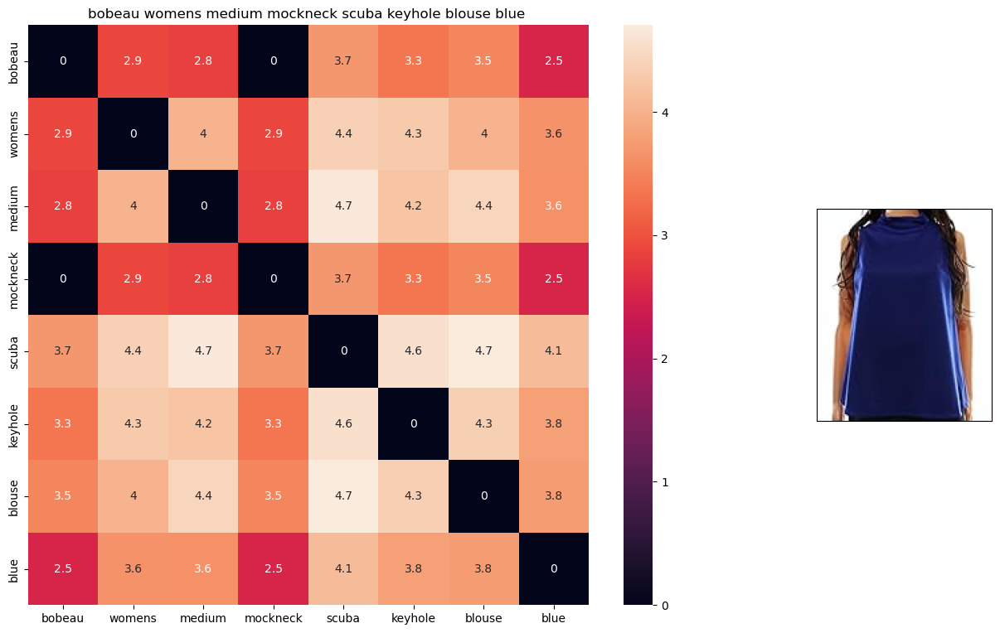

ASIN : B074STMD37
BRAND : Bobeau
Euclidean distance from given input image : 0.0


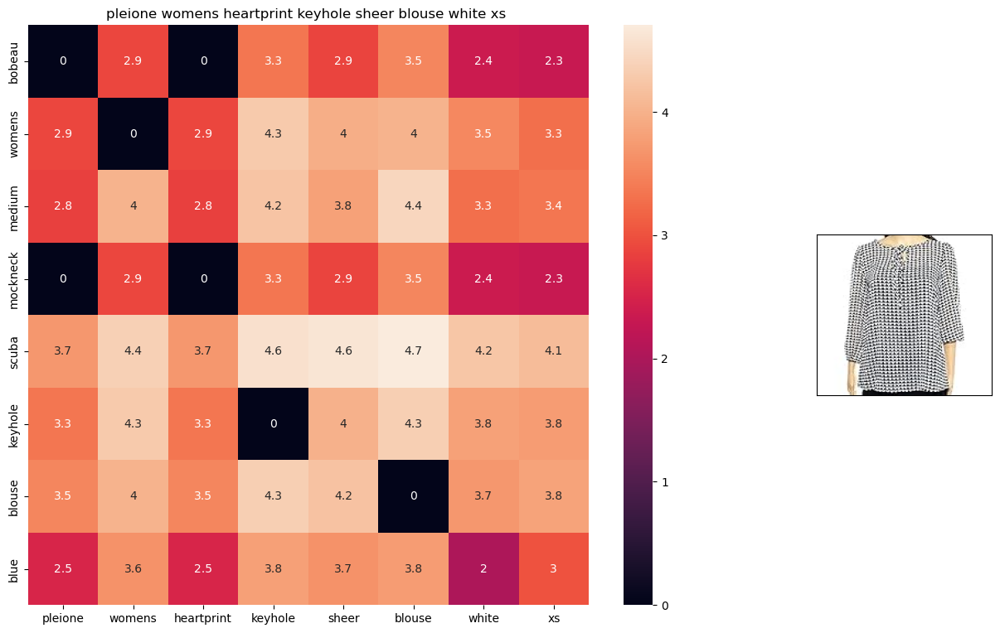

ASIN : B0759M7KG8
BRAND : Pleione
Euclidean distance from given input image : 0.73141843


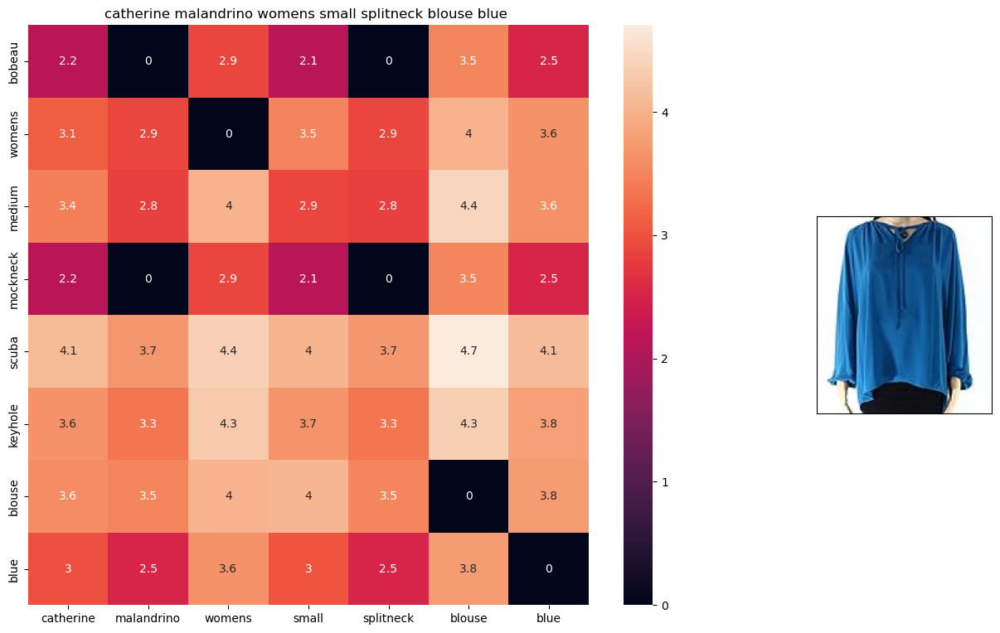

ASIN : B0756KFH85
BRAND : Catherine Malandrino
Euclidean distance from given input image : 0.7382188


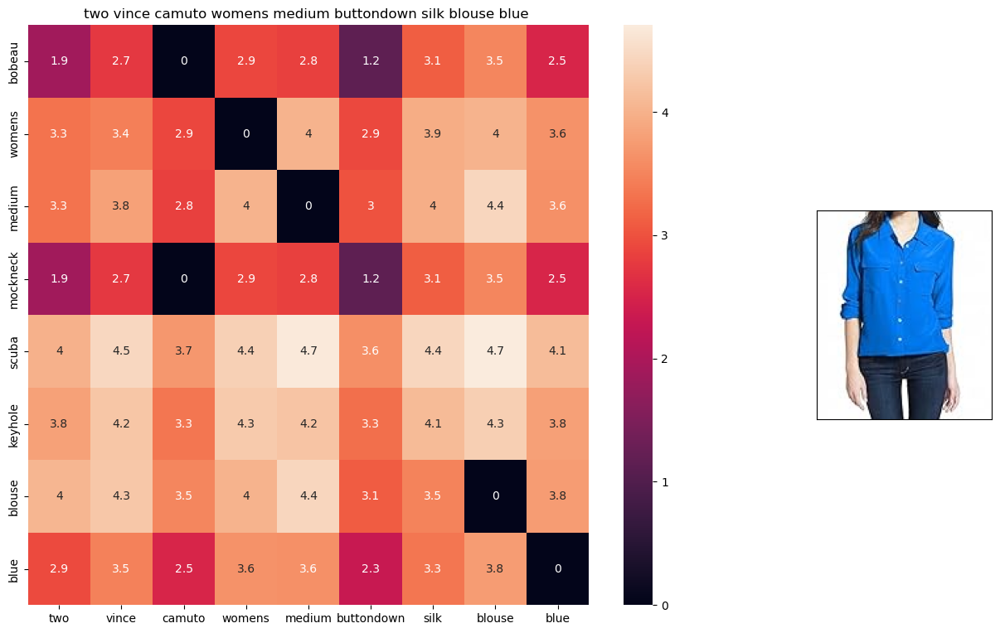

ASIN : B0758G2WFJ
BRAND : Two by Vince Camuto
Euclidean distance from given input image : 0.7585773


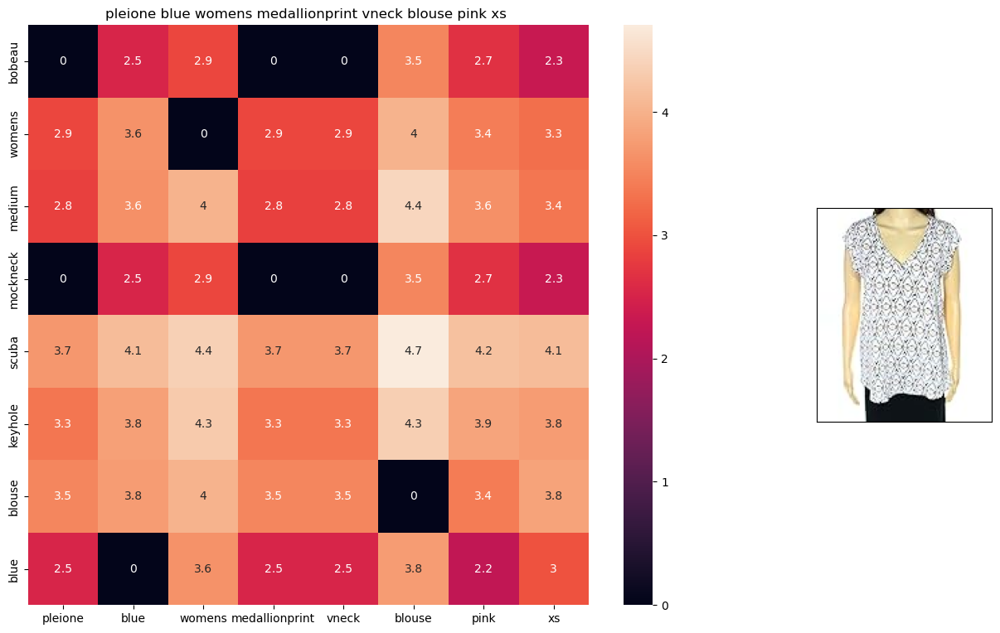

ASIN : B074VCV167
BRAND : Pleione
Euclidean distance from given input image : 0.7640499


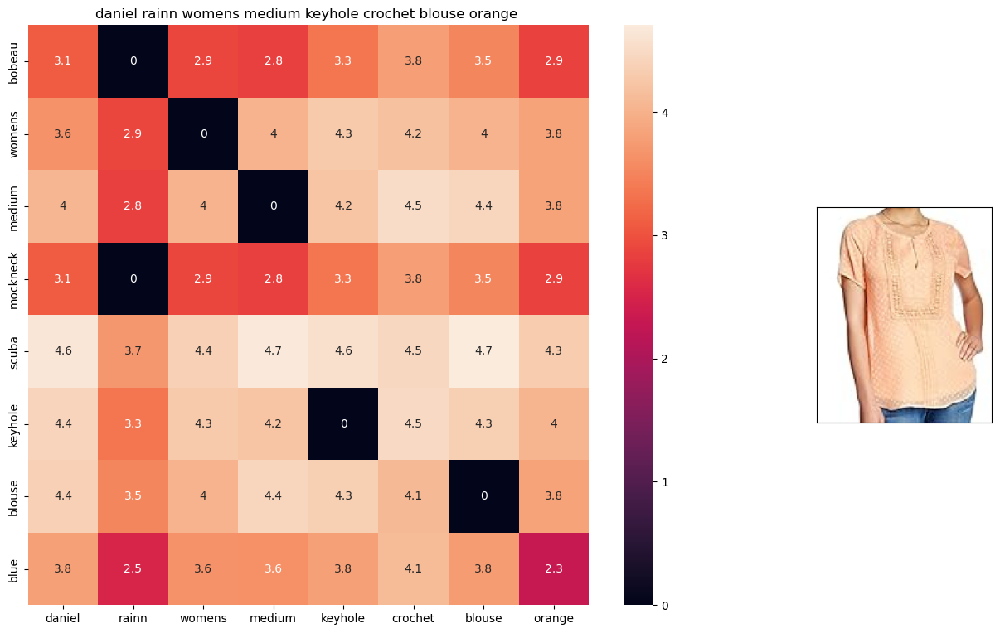

ASIN : B074QVK3LP
BRAND : Daniel Rainn
Euclidean distance from given input image : 0.7722336


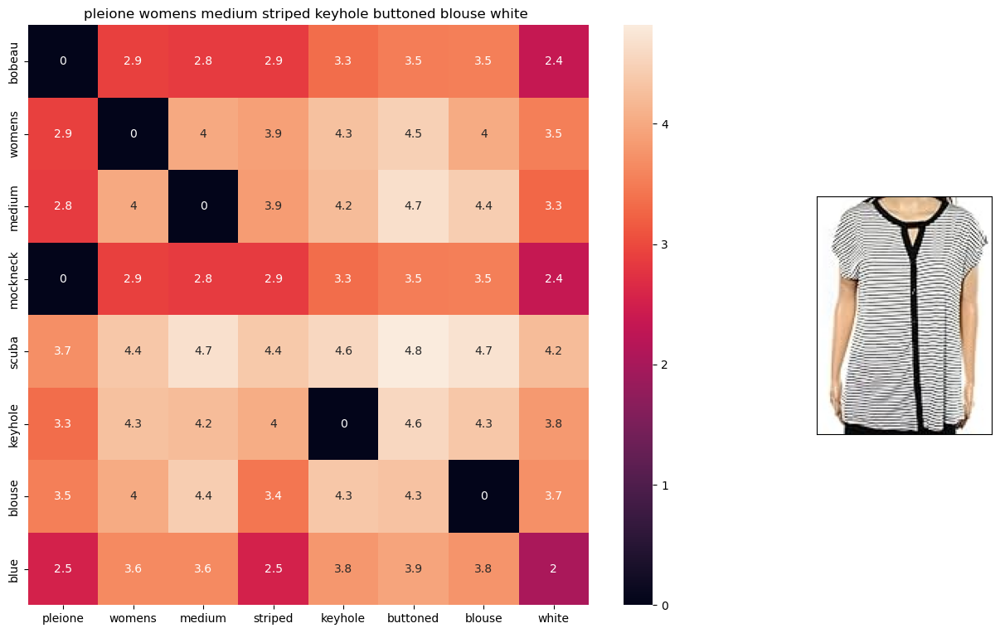

ASIN : B074TYSVLM
BRAND : Pleione
Euclidean distance from given input image : 0.78267074


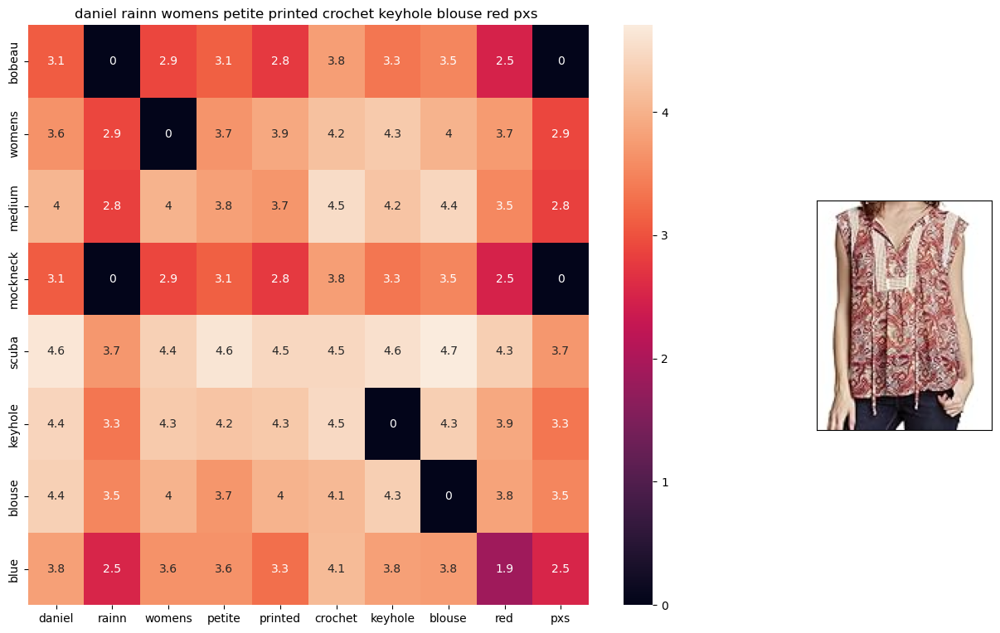

ASIN : B074QW4Y3V
BRAND : Daniel Rainn
Euclidean distance from given input image : 0.78596103


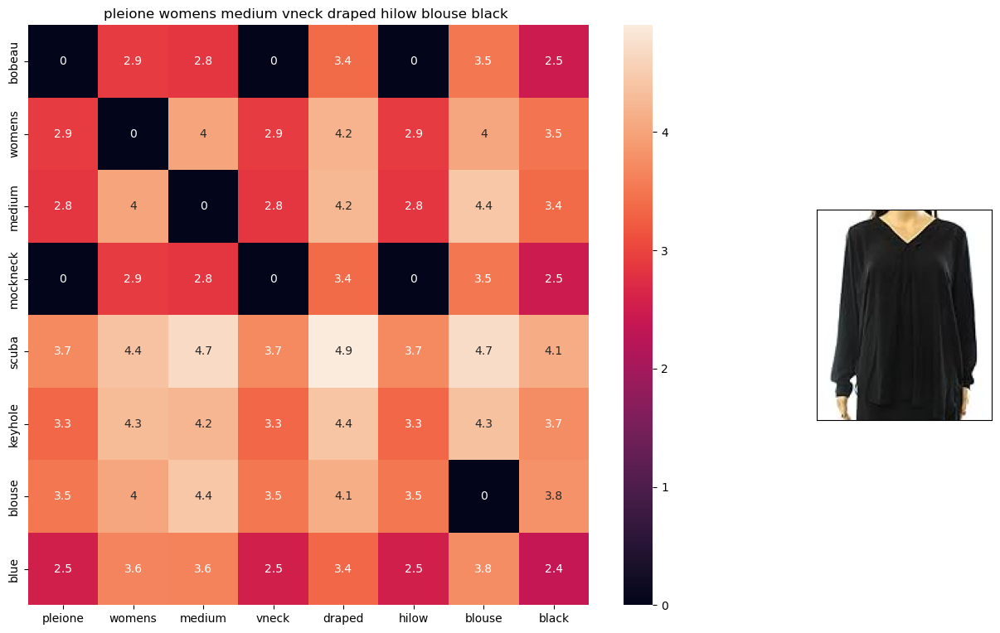

ASIN : B074T25BN7
BRAND : Pleione
Euclidean distance from given input image : 0.785995


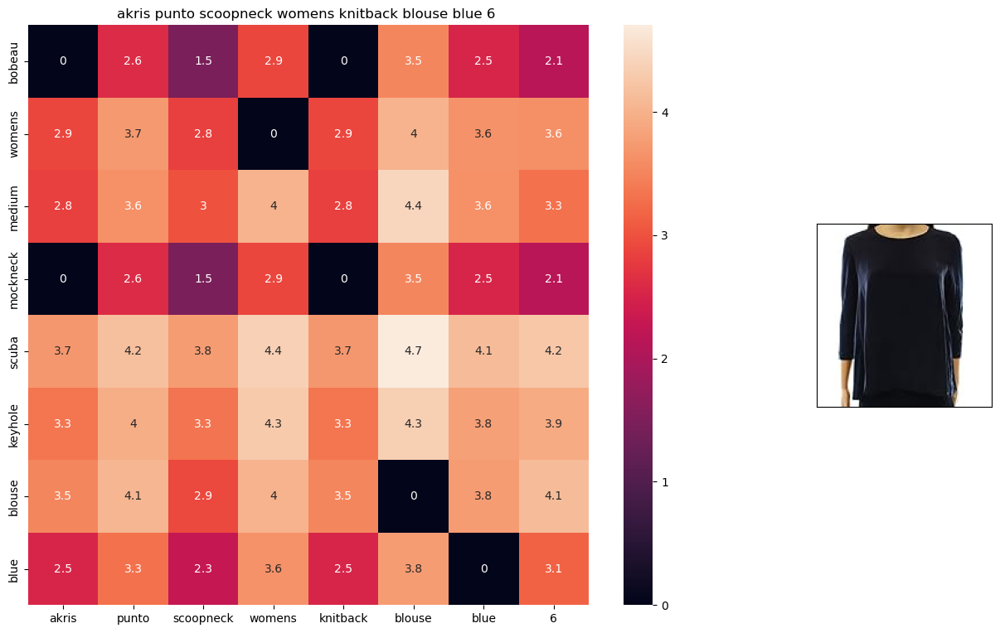

ASIN : B074TYSXSN
BRAND : Akris Punto
Euclidean distance from given input image : 0.787011


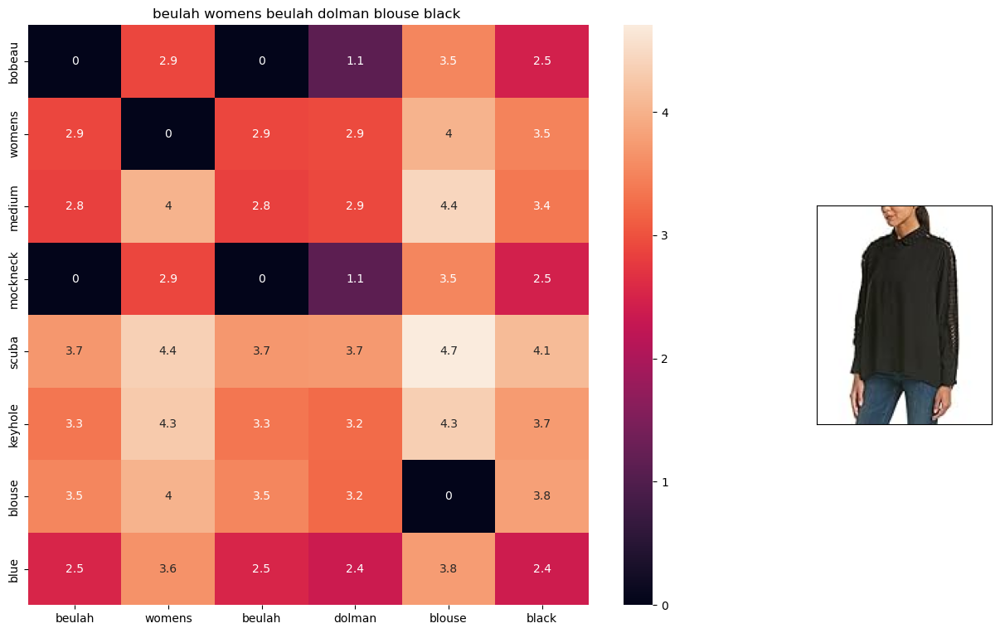

ASIN : B074RNWHL2
BRAND : Beulah
Euclidean distance from given input image : 0.789773


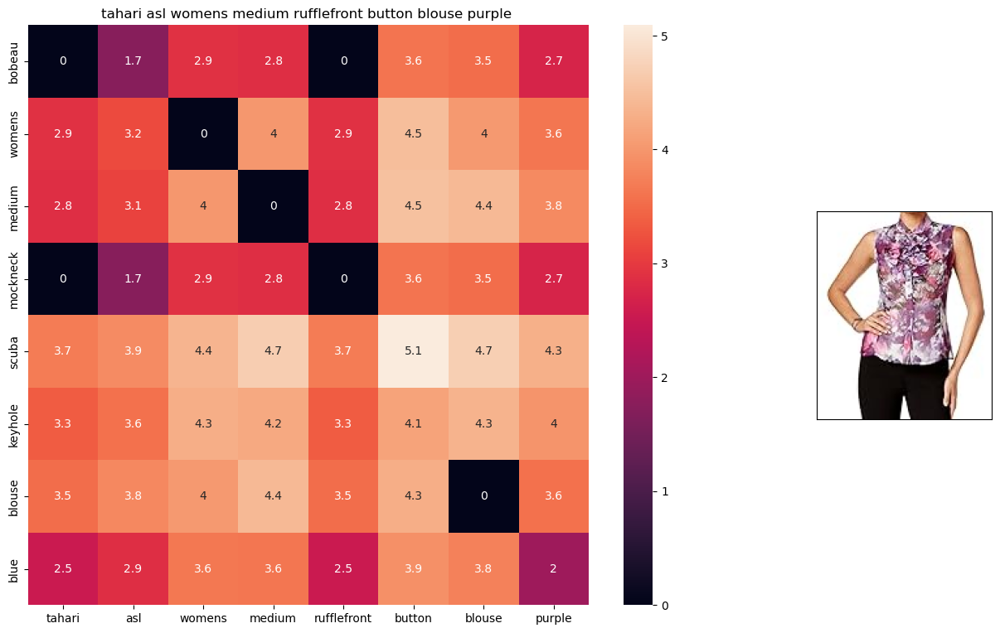

ASIN : B074ZJL9CB
BRAND : Tahari ASL
Euclidean distance from given input image : 0.79862326


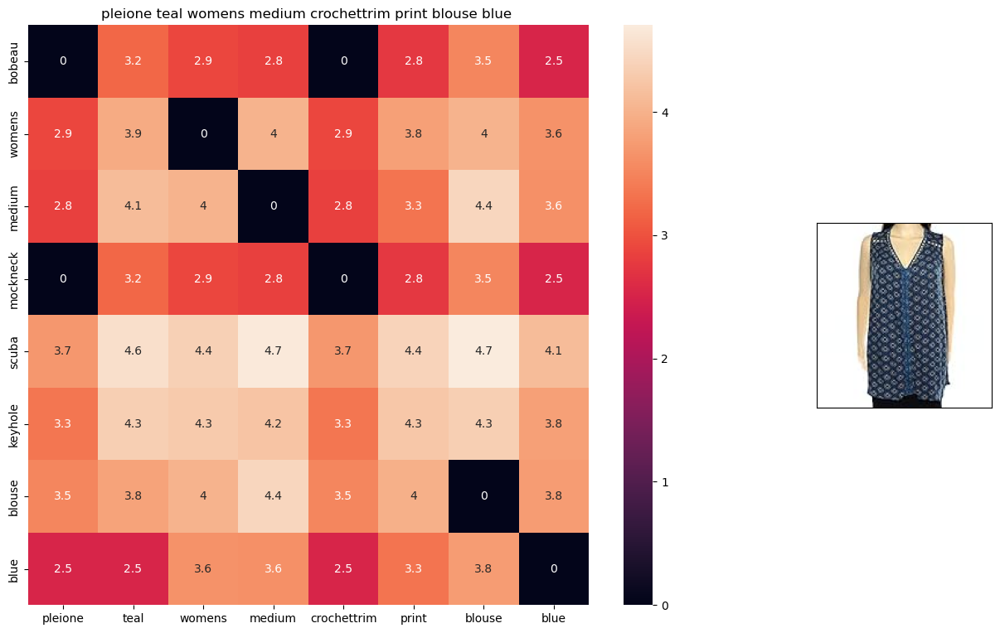

ASIN : B0753KBF1F
BRAND : Pleione
Euclidean distance from given input image : 0.8025882


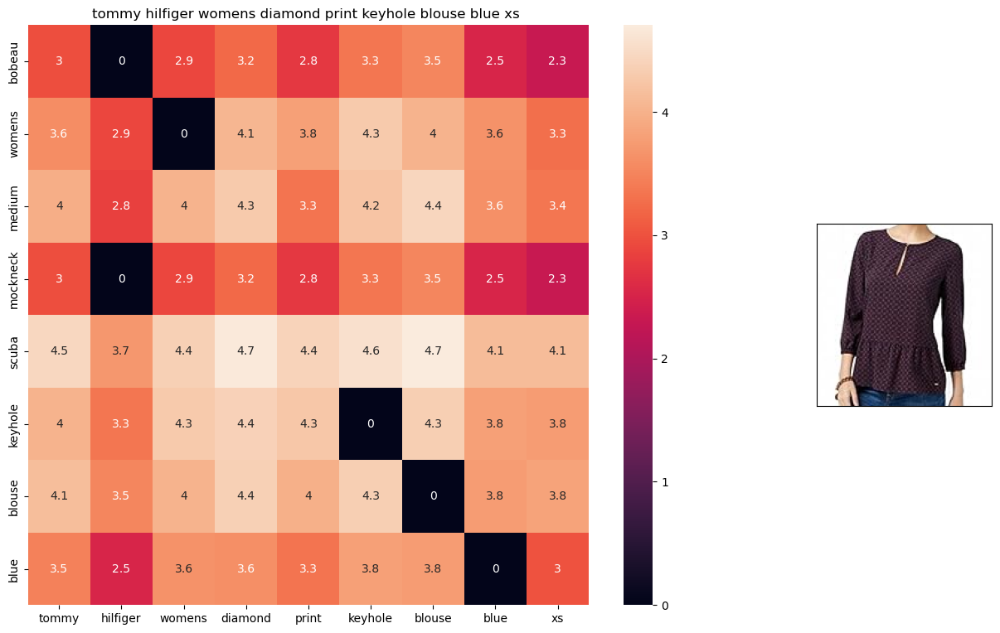

ASIN : B0759QV89G
BRAND : Tommy Hilfiger
Euclidean distance from given input image : 0.80310166


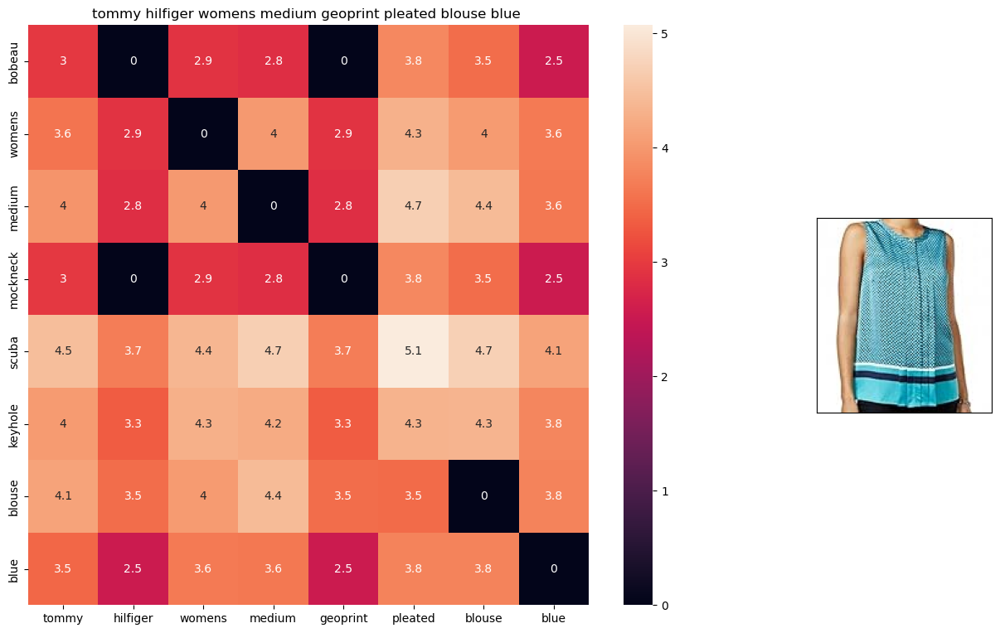

ASIN : B074WCLJT1
BRAND : Tommy Hilfiger
Euclidean distance from given input image : 0.8057548


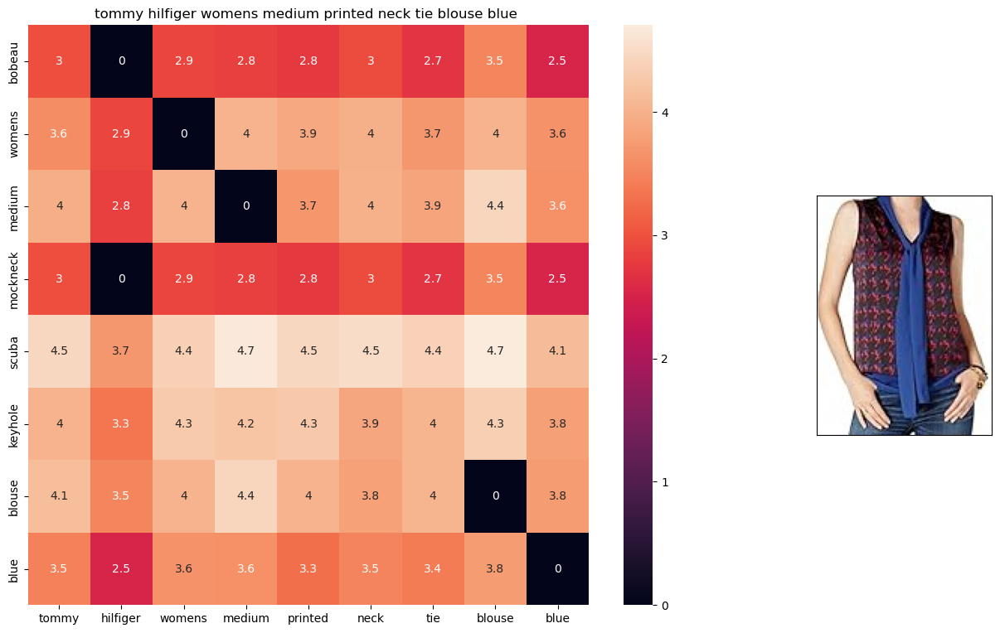

ASIN : B0752RTNNM
BRAND : Tommy Hilfiger
Euclidean distance from given input image : 0.8073798


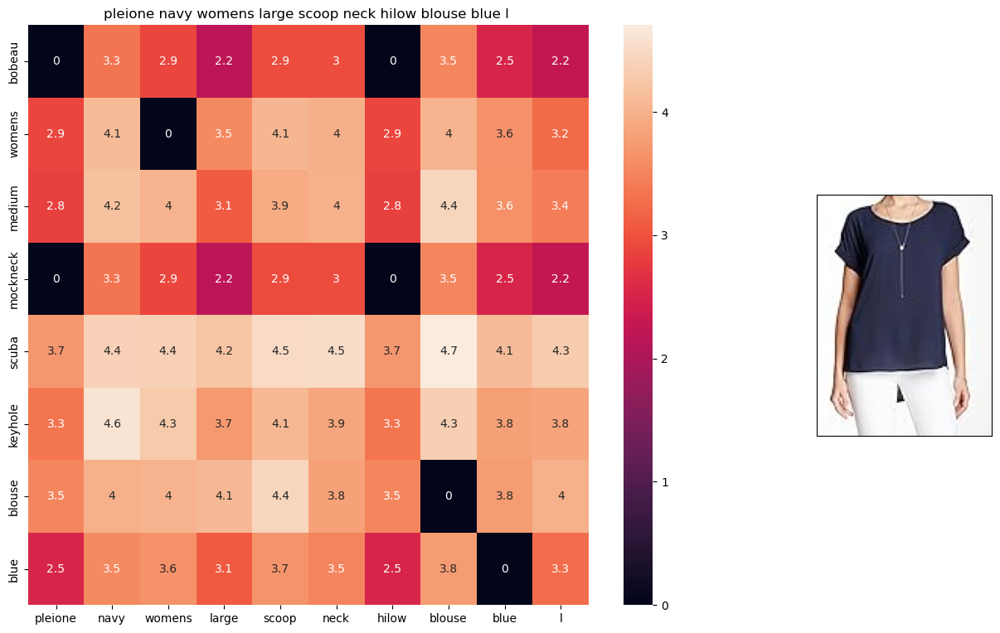

ASIN : B07573YBRB
BRAND : Pleione
Euclidean distance from given input image : 0.80952096


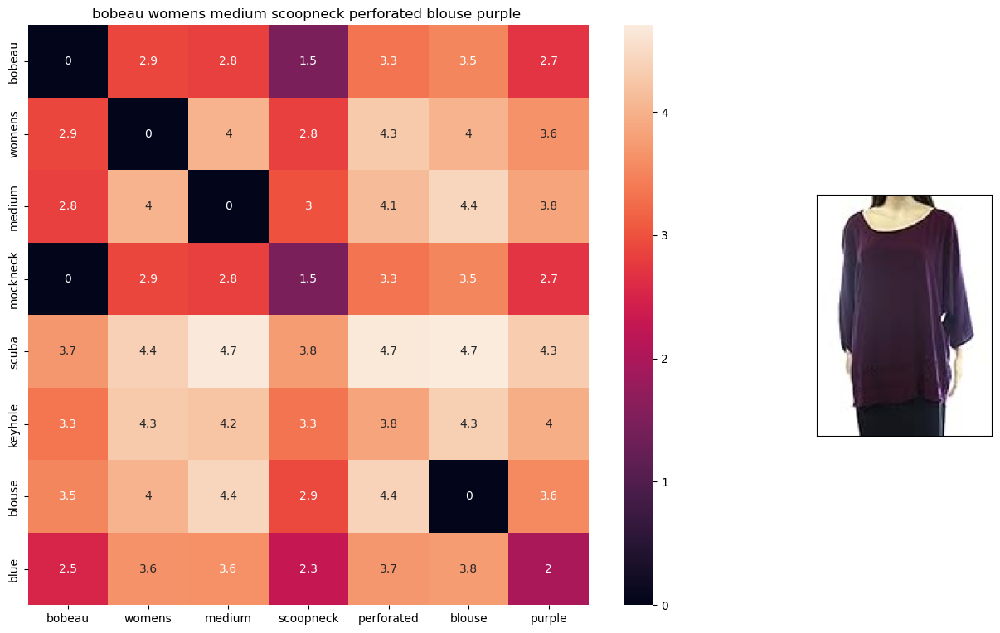

ASIN : B074ZQ52JX
BRAND : Bobeau
Euclidean distance from given input image : 0.8168987


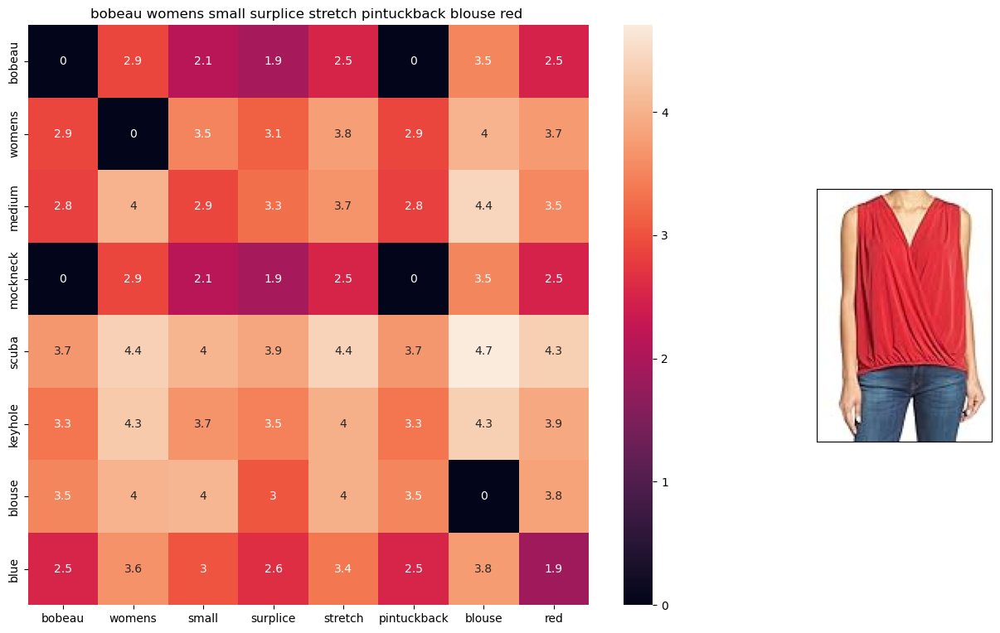

ASIN : B0754MNX2K
BRAND : Bobeau
Euclidean distance from given input image : 0.8188042


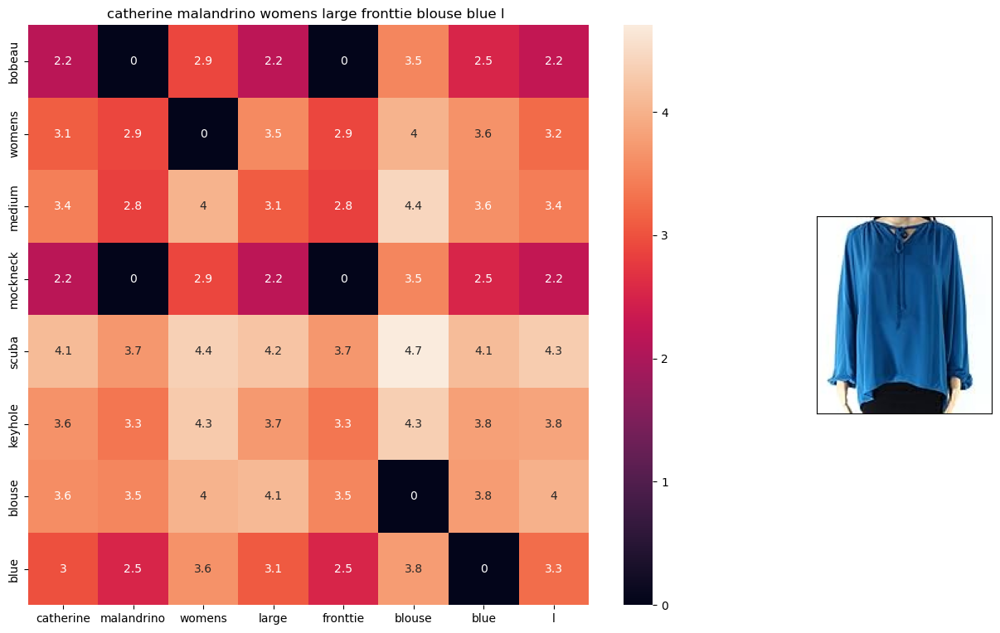

ASIN : B0756KPWFZ
BRAND : Catherine Malandrino
Euclidean distance from given input image : 0.8233896


In [64]:
def avg_w2v_model(doc_id, num_results):

    if doc_id >= len(w2v_title) or doc_id < 0:
        print(f"Error: doc_id {doc_id} is out of bounds. Please provide a value between 0 and {len(w2v_title) - 1}.")
        return

   
    pairwise_dist = pairwise_distances(w2v_title, w2v_title[doc_id].reshape(1, -1))

   
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])

  
    for i in range(len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'avg')
        print('ASIN :', data['asin'].loc[df_indices[i]])
        print('BRAND :', data['brand'].loc[df_indices[i]])
        print('Euclidean distance from given input image :', pdists[i])
        print('=' * 125)


avg_w2v_model(999, 20)

In [65]:
doc_id = 0
w2v_title_weight = []

for i in data['title']:
    w2v_title_weight.append(build_avg_vec(i, 300, doc_id,'weighted'))
    doc_id += 1

w2v_title_weight = np.array(w2v_title_weight)

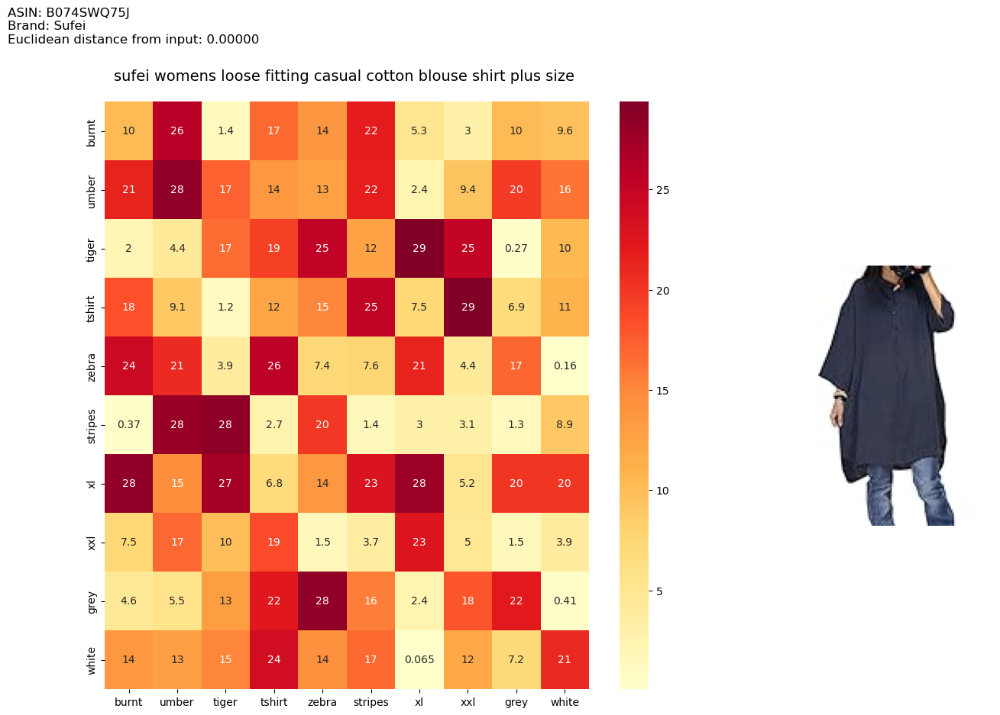

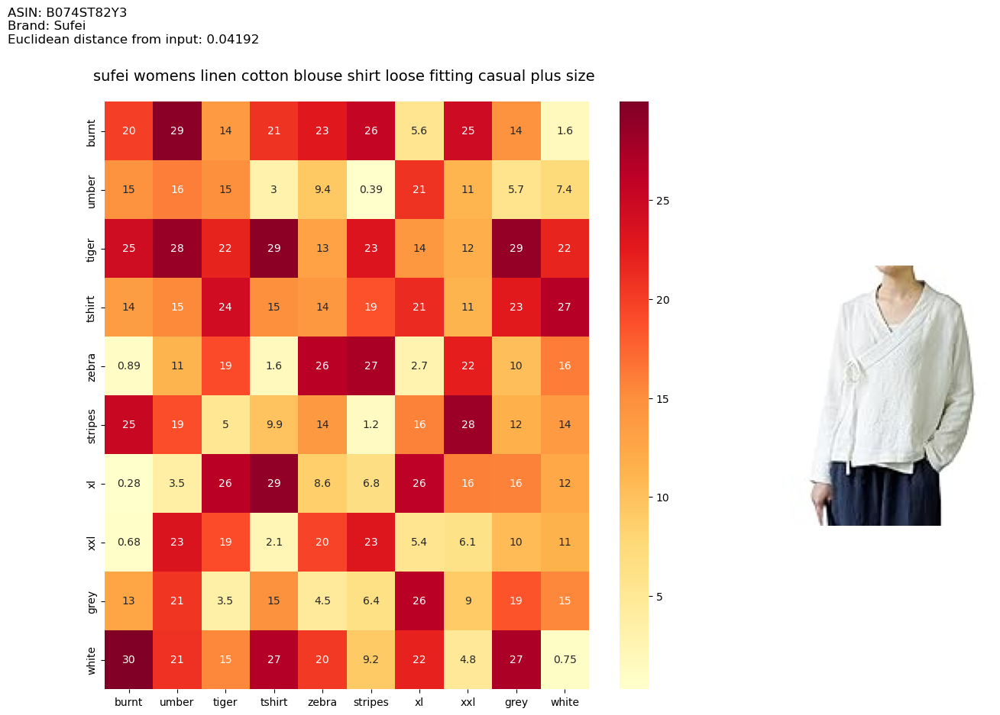

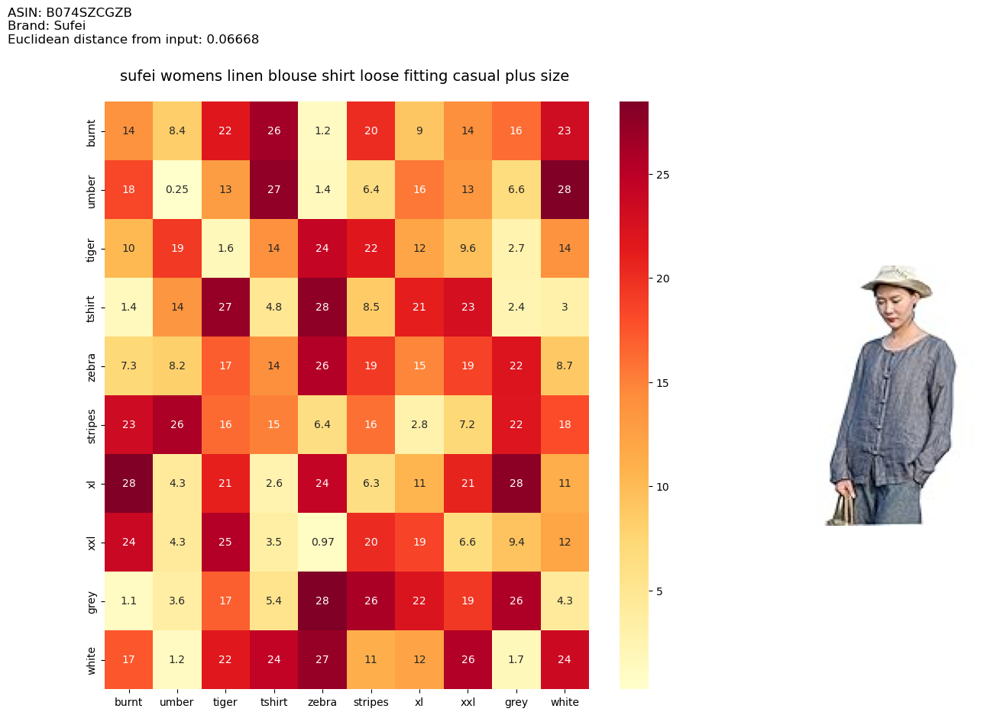

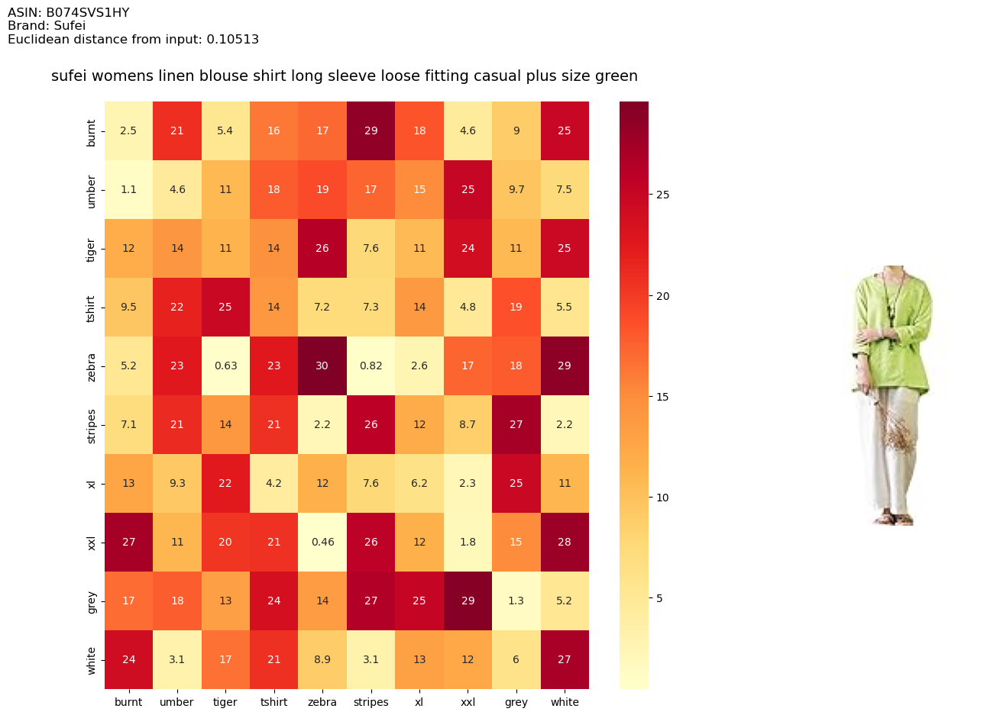

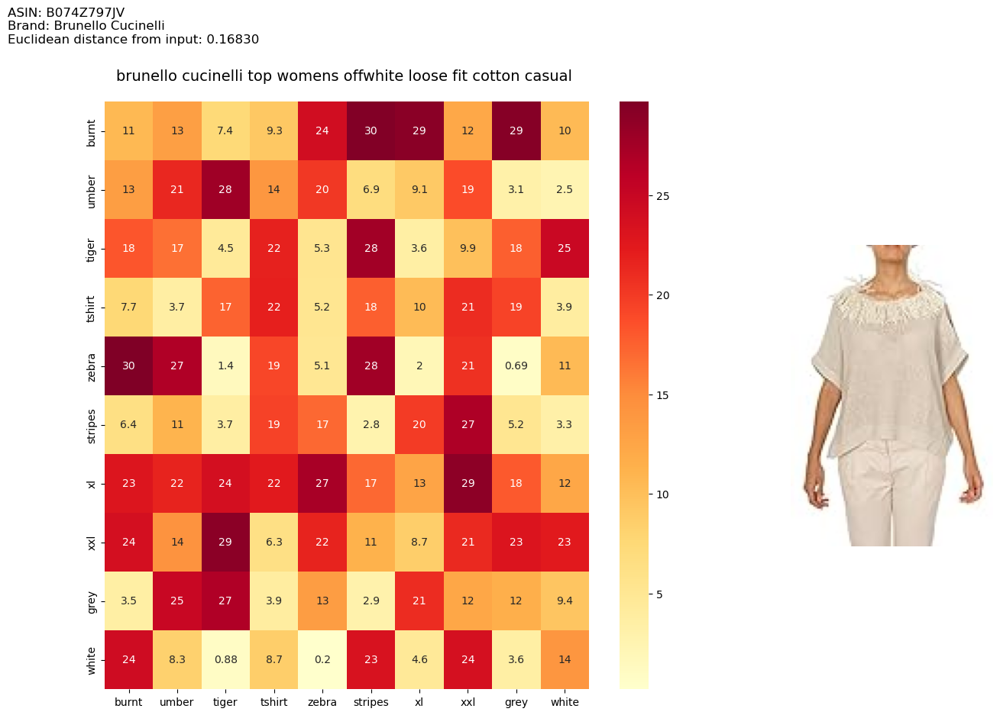

...

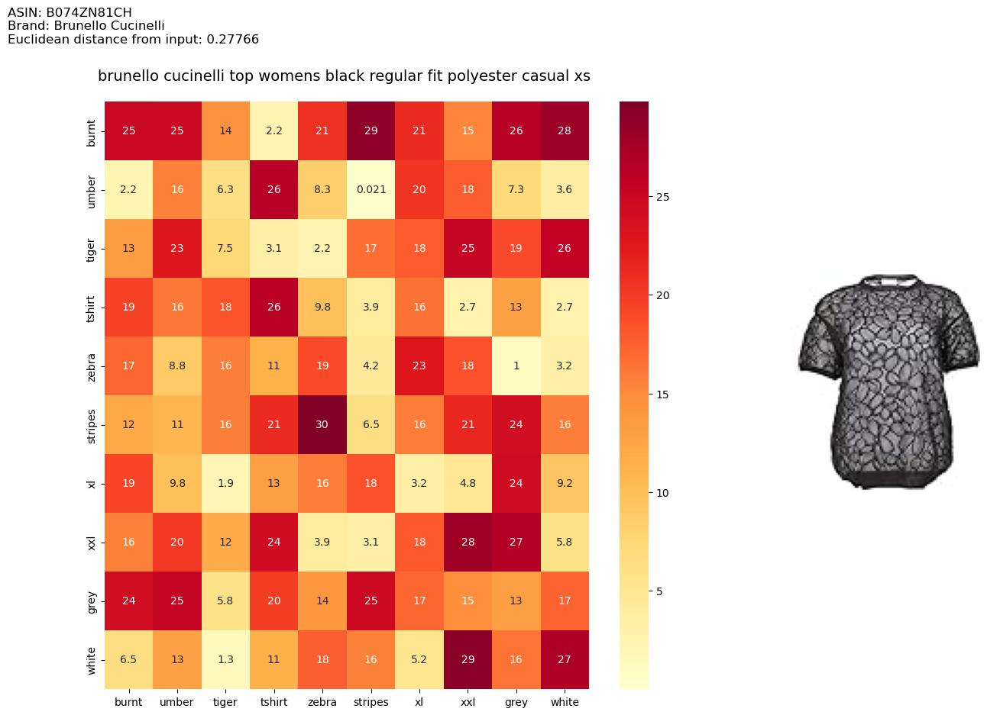

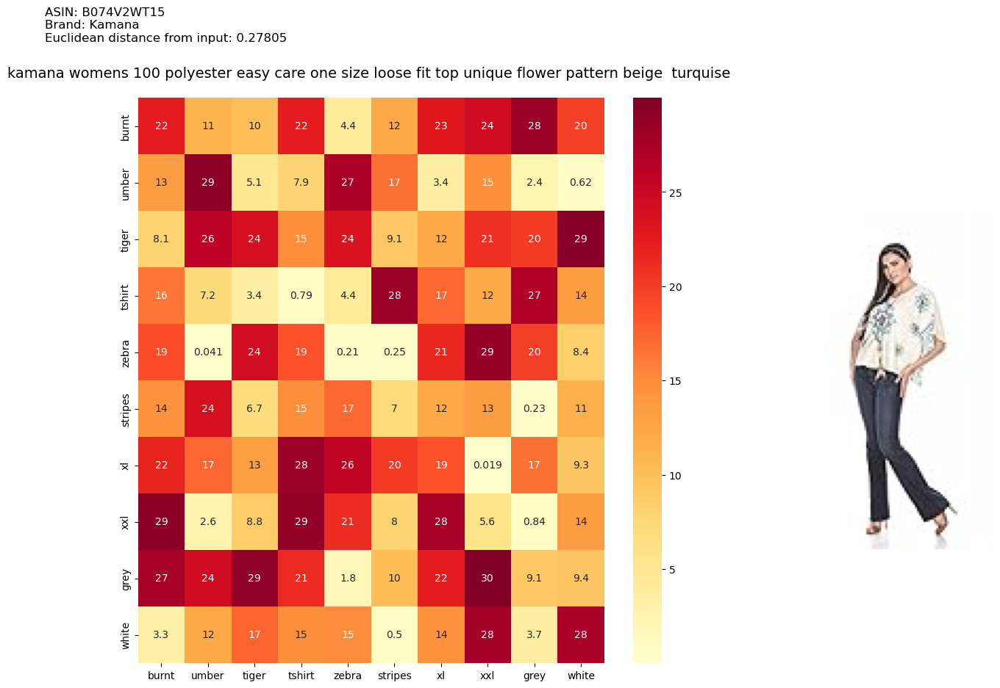

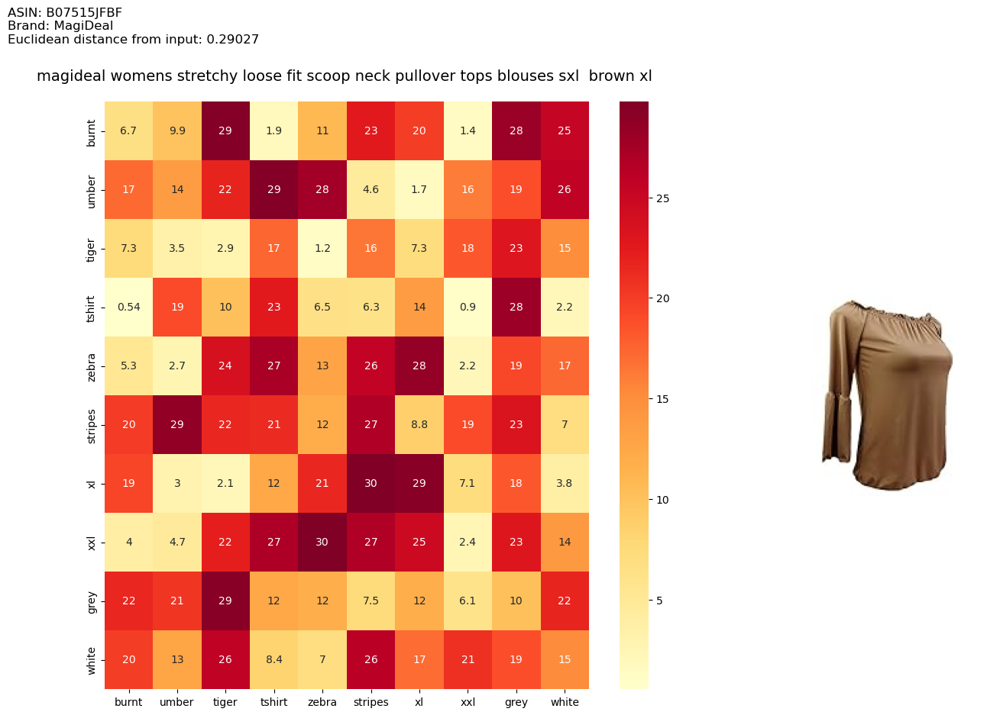

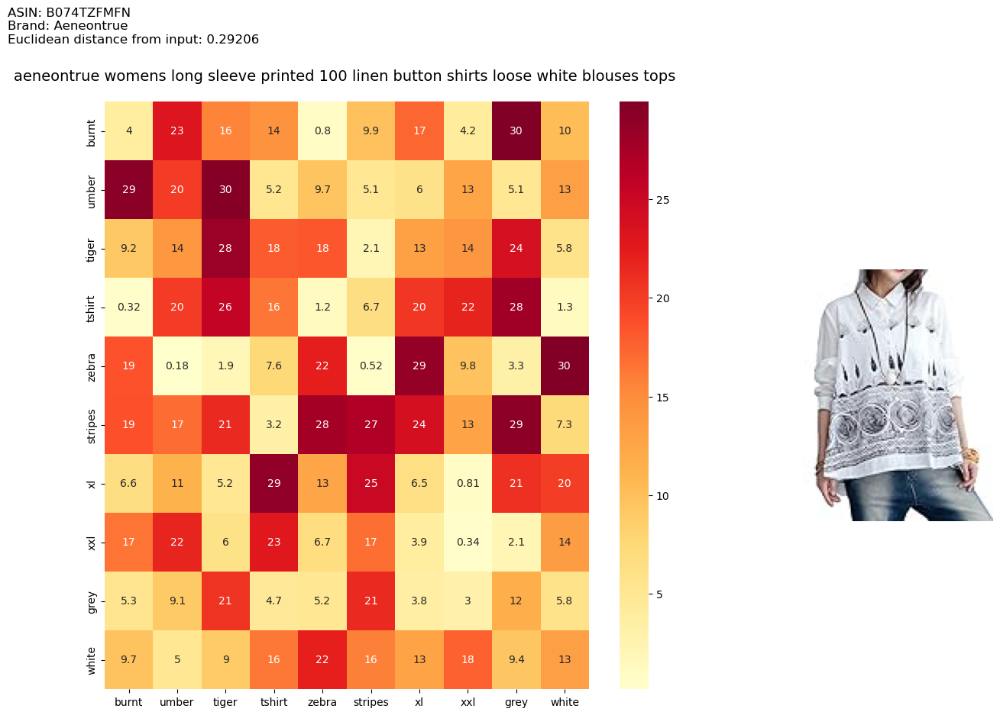

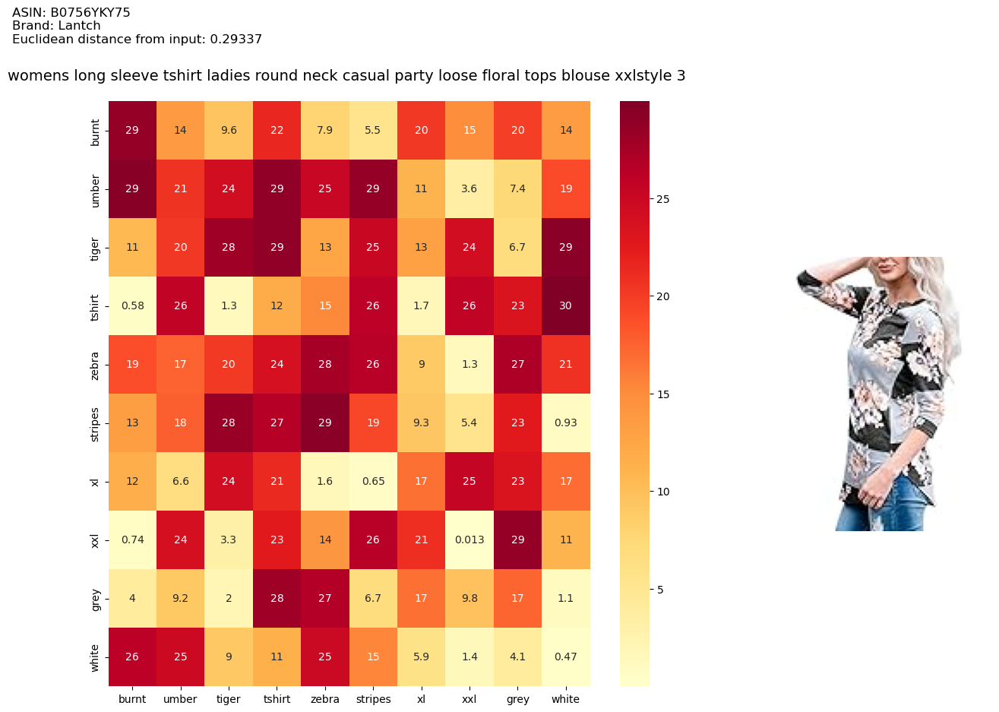

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import pairwise_distances
from PIL import Image
import requests
from io import BytesIO

doc_id = 0
w2v_title_weight = []
for i in data['title']:
    w2v_title_weight.append(build_avg_vec(i, 300, doc_id, 'weighted'))
    doc_id += 1
w2v_title_weight = np.array(w2v_title_weight)


def weighted_w2v_model(doc_id, num_results):
    
    pairwise_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1, -1), metric='cosine')
    
    
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])
    
   
    for i in range(len(indices)):
        title = data['title'].loc[df_indices[i]]
        brand = data['brand'].loc[df_indices[i]]
        asin = data['asin'].loc[df_indices[i]]
        distance = pdists[i]
        image_url = data['medium_image_url'].loc[df_indices[i]]
        
        
        heatmap_data = np.random.rand(10, 10) * 30
        heatmap_labels = ['burnt', 'umber', 'tiger', 'tshirt', 'zebra', 'stripes', 'xl', 'xxl', 'grey', 'white']
        
      
        fig, ax = plt.subplots(1, 2, figsize=(15, 10), gridspec_kw={'width_ratios': [3, 1]})
        fig.patch.set_facecolor('white')
        
        
        sns.heatmap(heatmap_data, annot=True, cmap='YlOrRd', cbar=True, xticklabels=heatmap_labels, yticklabels=heatmap_labels, ax=ax[0])
        ax[0].set_title(f"{title}", fontsize=14, color='black', pad=20)
        ax[0].text(-0.2, 1.1, f"ASIN: {asin}\nBrand: {brand}\nEuclidean distance from input: {distance:.5f}",
                   fontsize=12, color='black', transform=ax[0].transAxes)
        
        
        try:
            response = requests.get(image_url)
            img = Image.open(BytesIO(response.content))
            ax[1].imshow(img)
            ax[1].axis('off')
        except:
            ax[1].text(0.5, 0.5, 'Image not available', ha='center', va='center', fontsize=12, color='black')
            ax[1].axis('off')
        
        plt.show()
        print('=' * 125)


weighted_w2v_model(989, 20)

In [67]:
data['brand'].fillna(value="Not given", inplace=True )

brands = [x.replace(" ", "-") for x in data['brand'].values]
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features)).tocsr()

In [68]:
def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    

    s1_vec = get_word_vec(sentance1, doc_id1, model)

    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], 
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] 
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] 
    
    
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
   
    plotly.offline.iplot(table, filename='simple_table')
    
   
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    
    ax1 = plt.subplot(gs[:, :-5])
    
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    
    ax1.set_xticklabels(sentance2.split())
   
    ax1.set_yticklabels(sentance1.split())
    
    ax1.set_title(sentance2)

    ax2 = plt.subplot(gs[:, 10:16])
    
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    
    display_img(url, ax2, fig)
    
    plt.show()

In [69]:
data['brand'].fillna(value="Not given", inplace=True )

brands = [x.replace(" ", "-") for x in data['brand'].values]
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features)).tocsr()

In [70]:
def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    
    s1_vec = get_word_vec(sentance1, doc_id1, model)
    
    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], 
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] 
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] 
    
   
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
    
    plotly.offline.iplot(table, filename='simple_table')
    
    
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    ax1 = plt.subplot(gs[:, :-5])
    
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    
    ax1.set_xticklabels(sentance2.split())
    
    ax1.set_yticklabels(sentance1.split())
   
    ax1.set_title(sentance2)

   
    ax2 = plt.subplot(gs[:, 10:16])
   
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
   
    display_img(url, ax2, fig)
    
    plt.show()

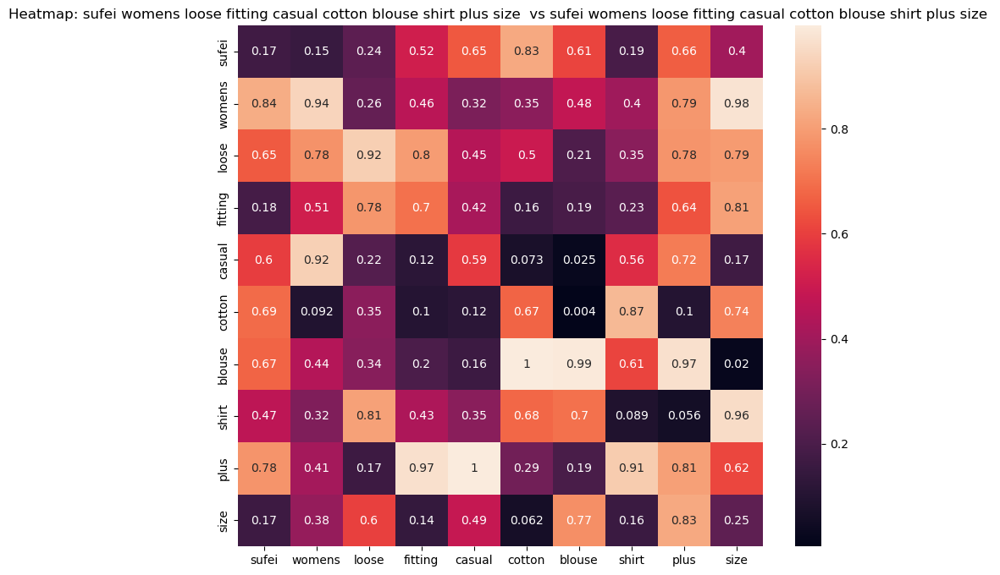

ASIN : B074SWQ75J
Brand : Sufei
euclidean distance from input : 0.0


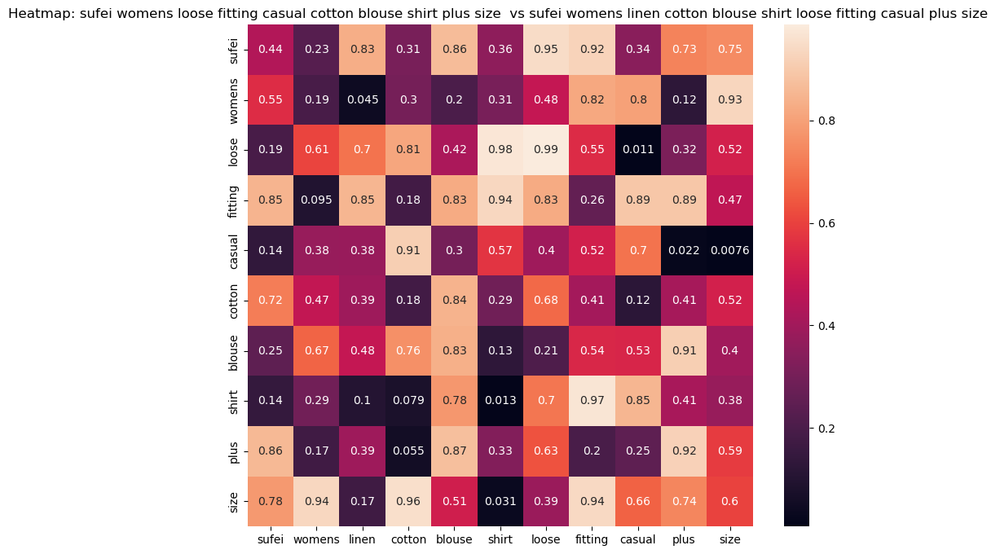

ASIN : B074ST82Y3
Brand : Sufei
euclidean distance from input : 1.2784048559088377


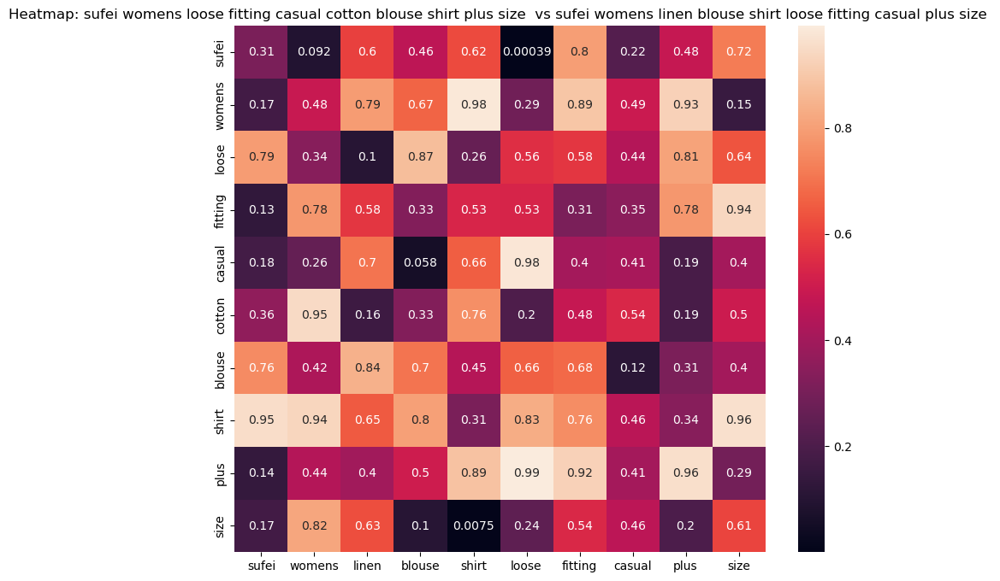

ASIN : B074SZCGZB
Brand : Sufei
euclidean distance from input : 1.383702087583032


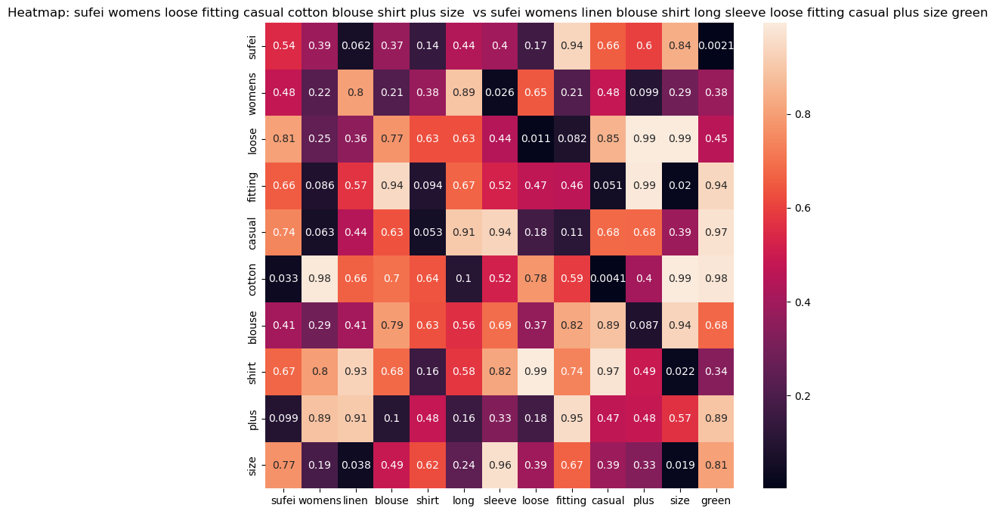

ASIN : B074SVS1HY
Brand : Sufei
euclidean distance from input : 1.5153261186499265


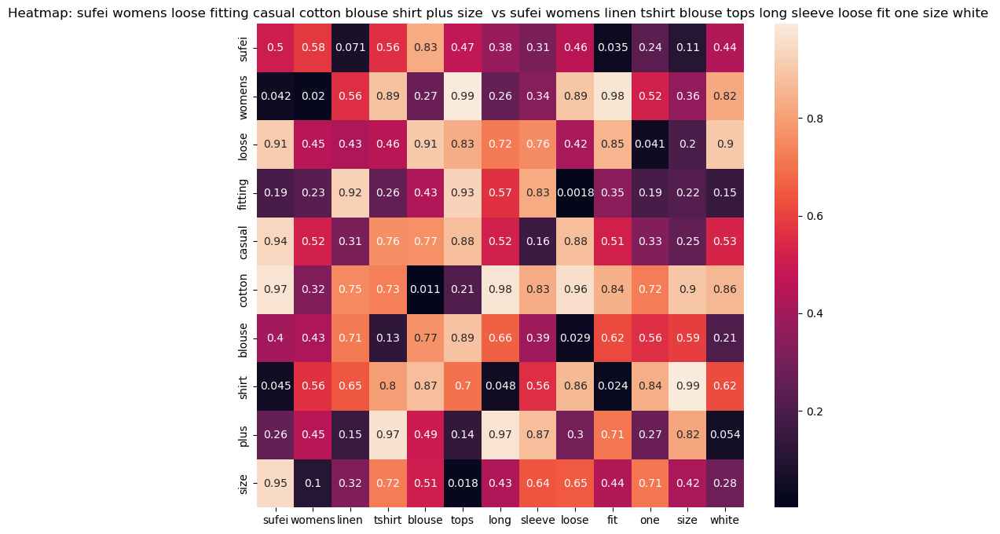

ASIN : B074SPFNSW
Brand : Sufei
euclidean distance from input : 1.7669850351233152


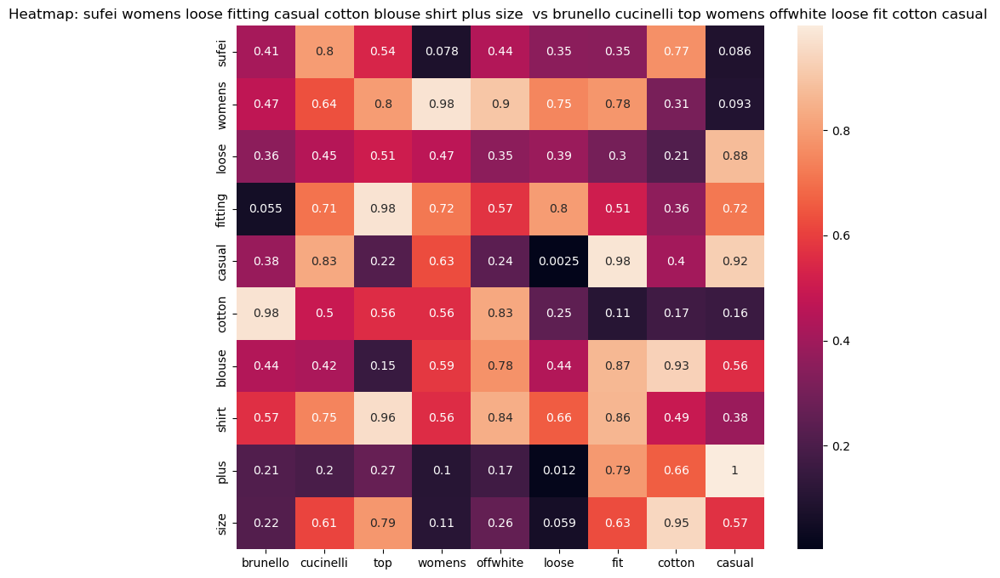

ASIN : B074Z797JV
Brand : Brunello Cucinelli
euclidean distance from input : 2.088513381755266


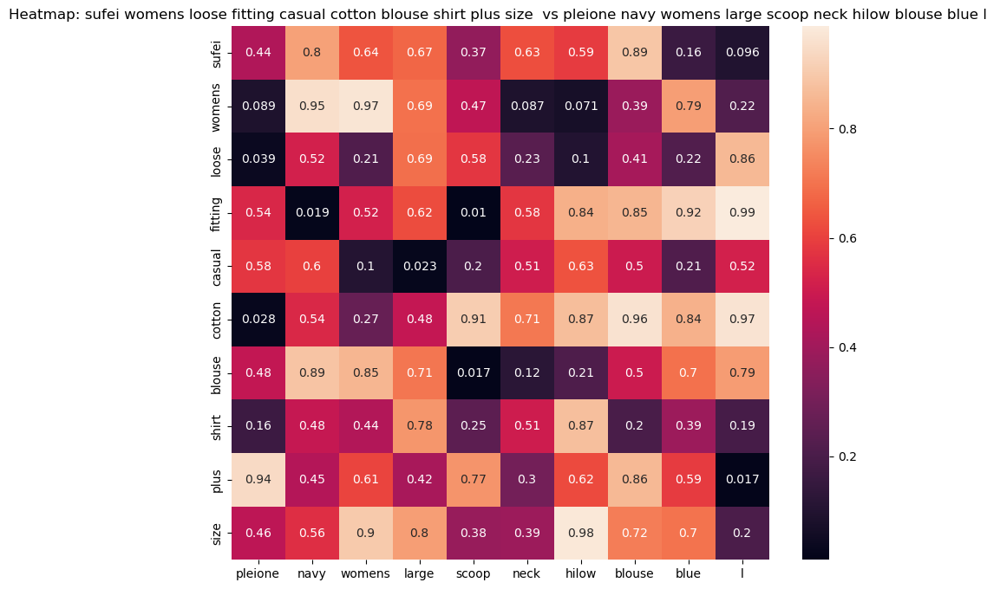

ASIN : B07573YBRB
Brand : Pleione
euclidean distance from input : 2.259215355100122


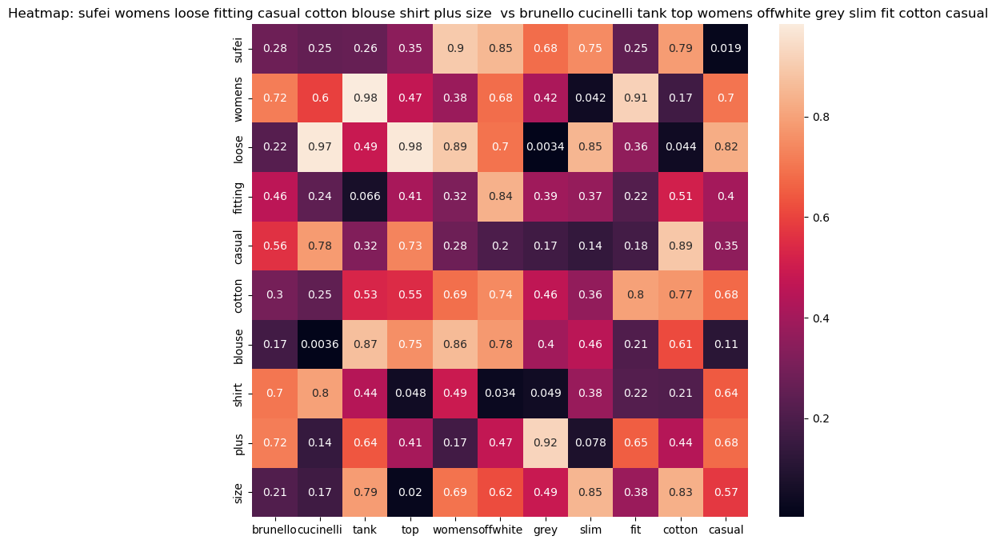

ASIN : B074Z7TJJW
Brand : Brunello Cucinelli
euclidean distance from input : 2.308324630534563


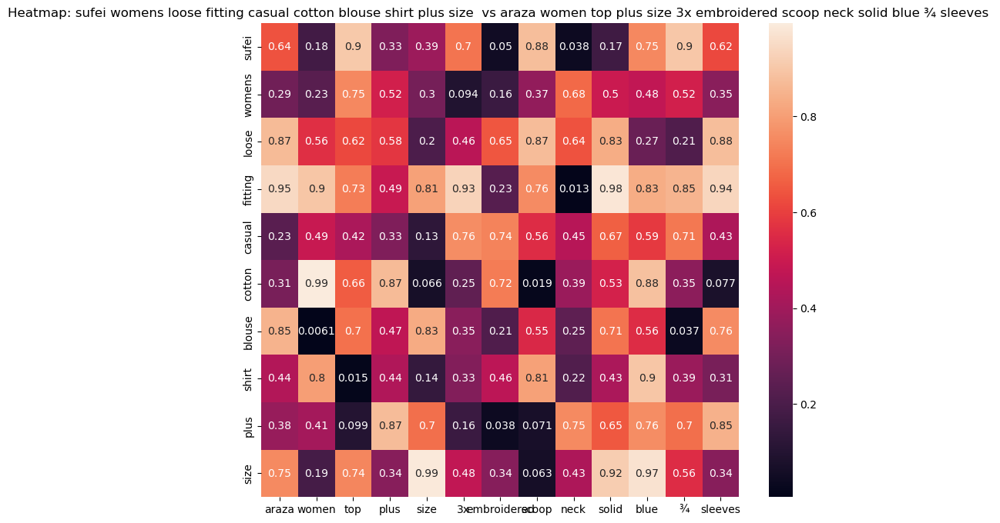

ASIN : B0759WWM6H
Brand : ARAZA
euclidean distance from input : 2.315251159848657


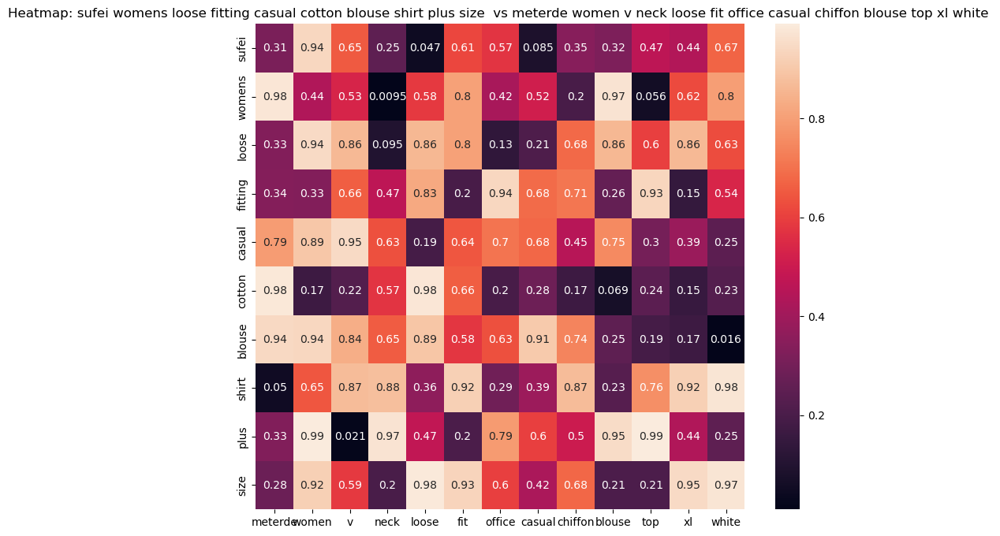

ASIN : B0758DTQ8S
Brand : METERDE
euclidean distance from input : 2.3208119466661548


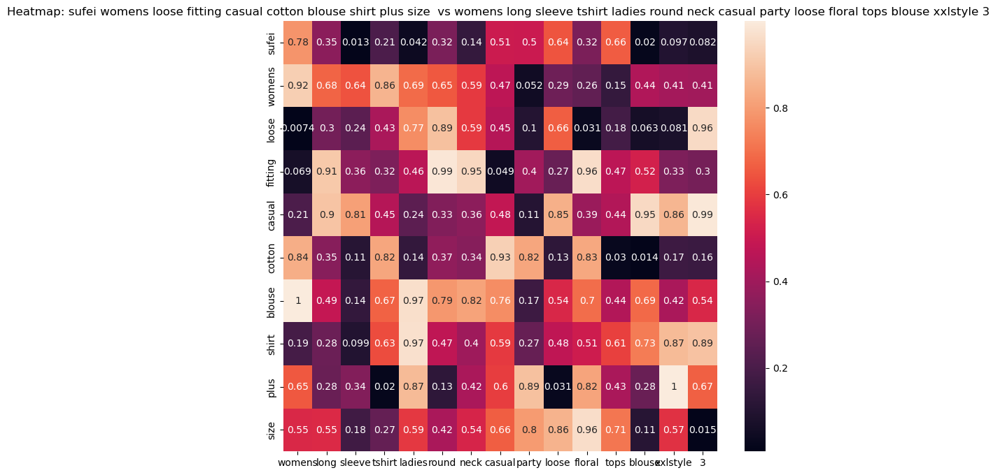

ASIN : B0756YKY75
Brand : Lantch
euclidean distance from input : 2.3262779235839846


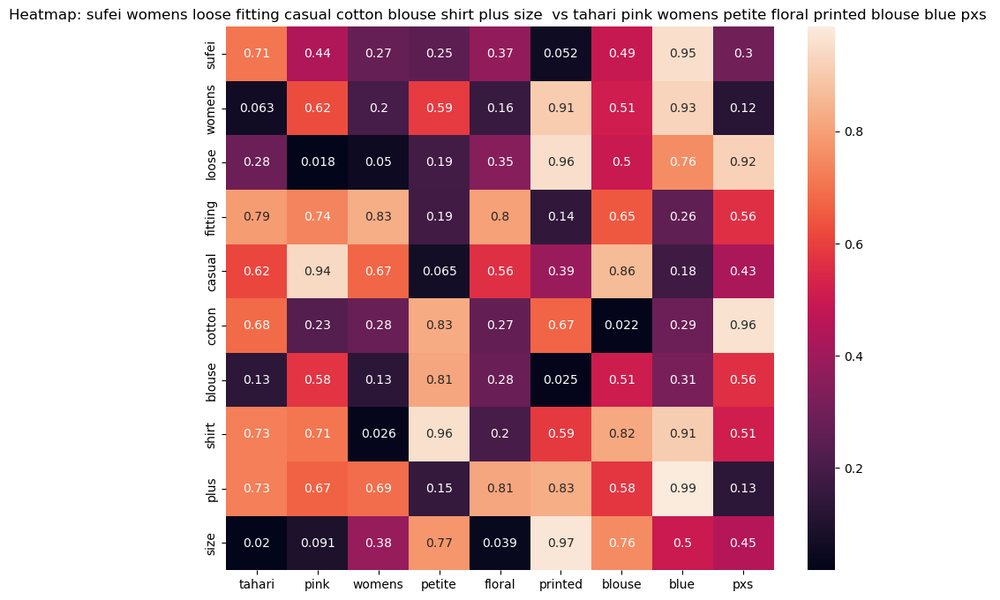

ASIN : B074TP53WS
Brand : T Tahari
euclidean distance from input : 2.3267606737036375


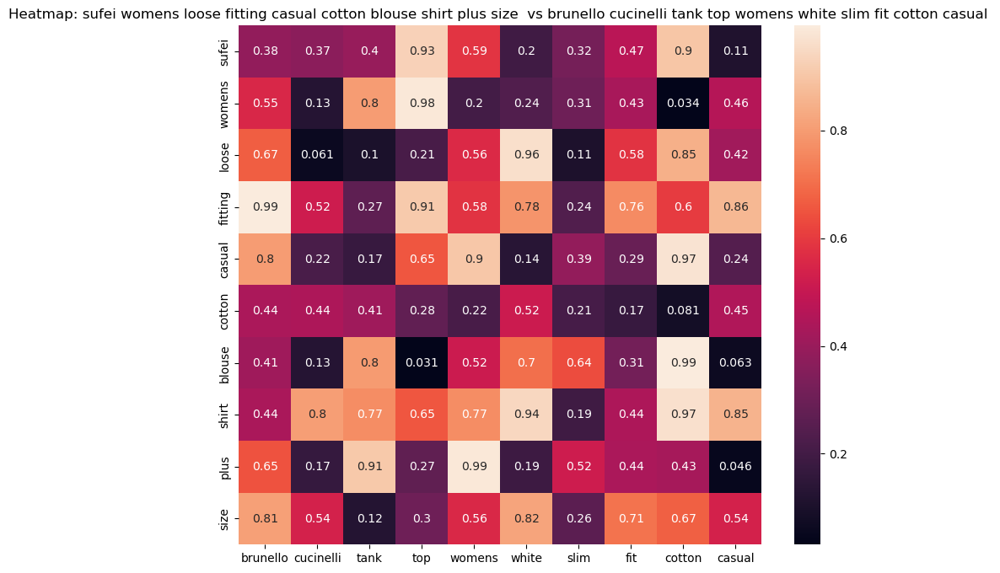

ASIN : B074Z6LW87
Brand : Brunello Cucinelli
euclidean distance from input : 2.339738567149553


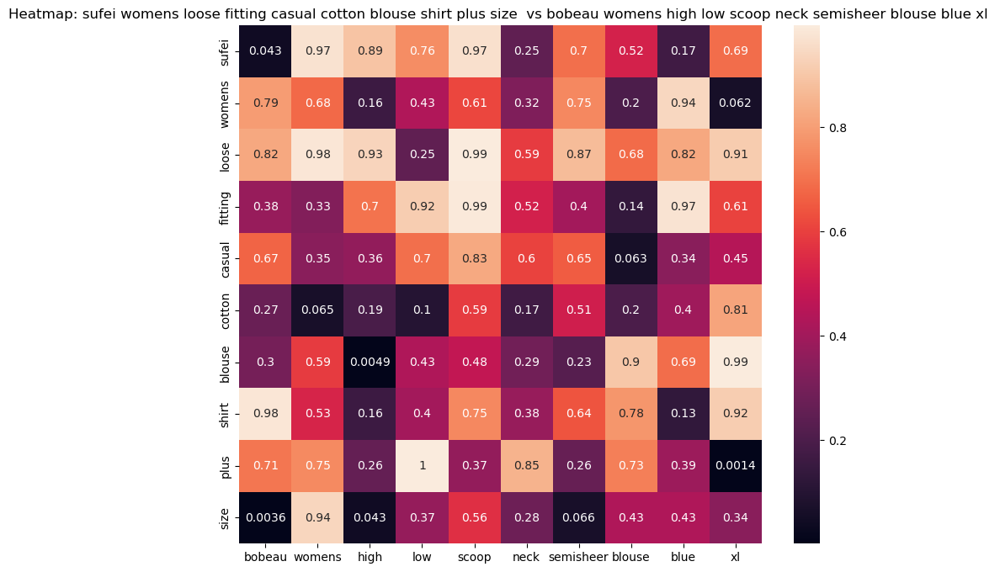

ASIN : B074TW39SC
Brand : Bobeau
euclidean distance from input : 2.344893837155786


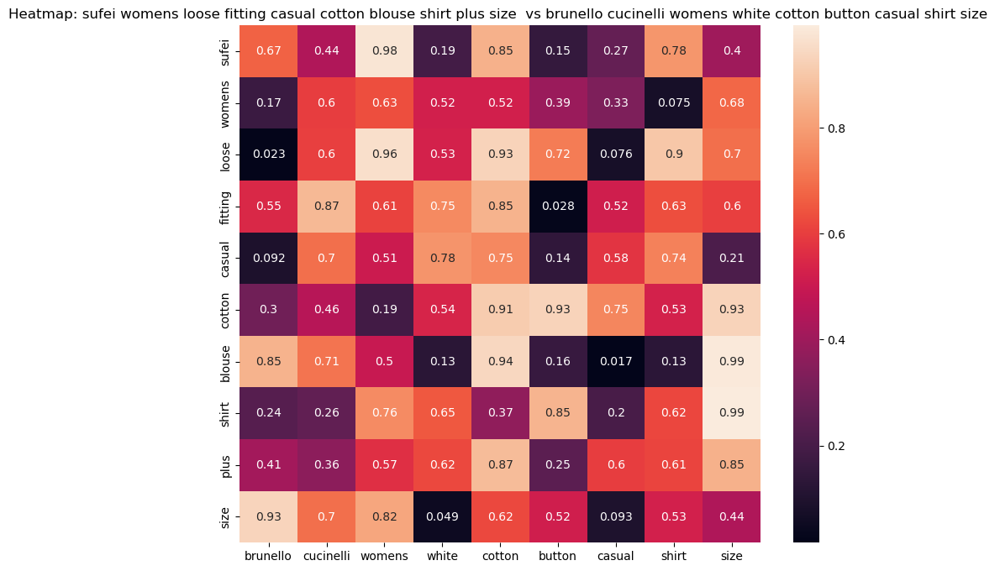

ASIN : B07589BNKL
Brand : Brunello Cucinelli
euclidean distance from input : 2.3514697149156665


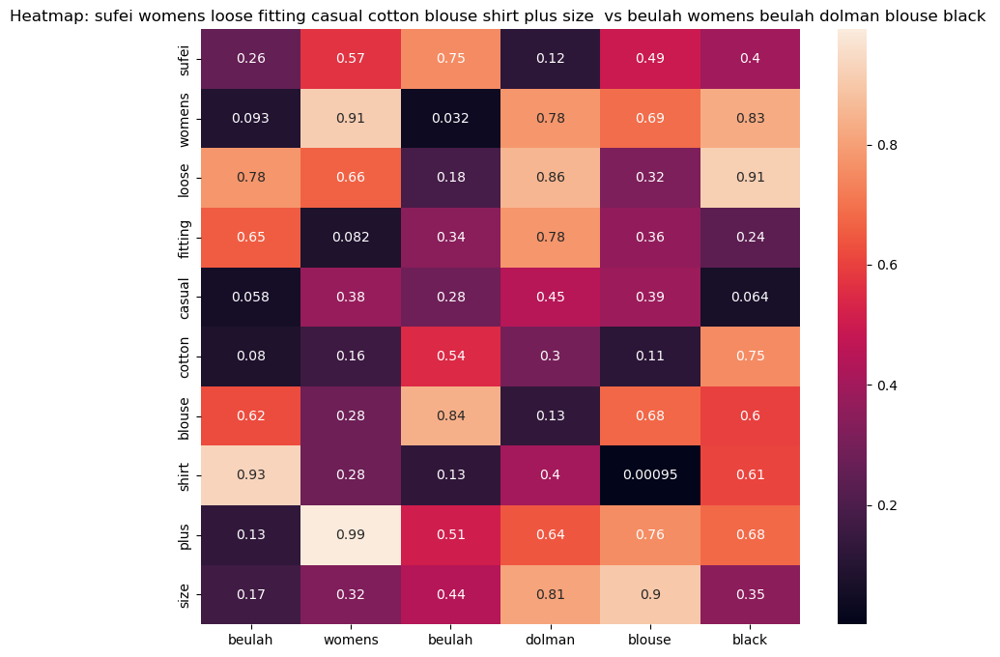

ASIN : B074RNWHL2
Brand : Beulah
euclidean distance from input : 2.362429714202881


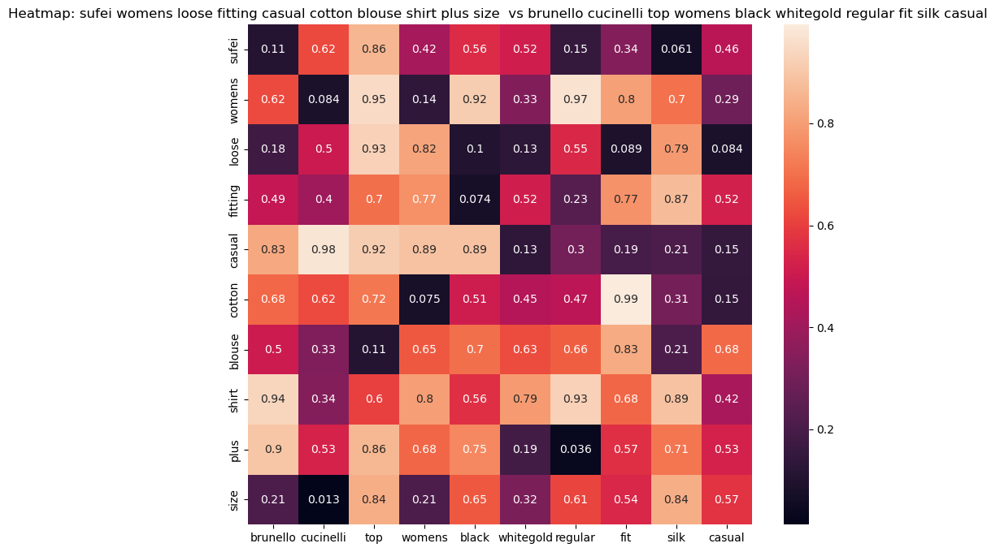

ASIN : B074ZHSCK2
Brand : Brunello Cucinelli
euclidean distance from input : 2.3834634855150316


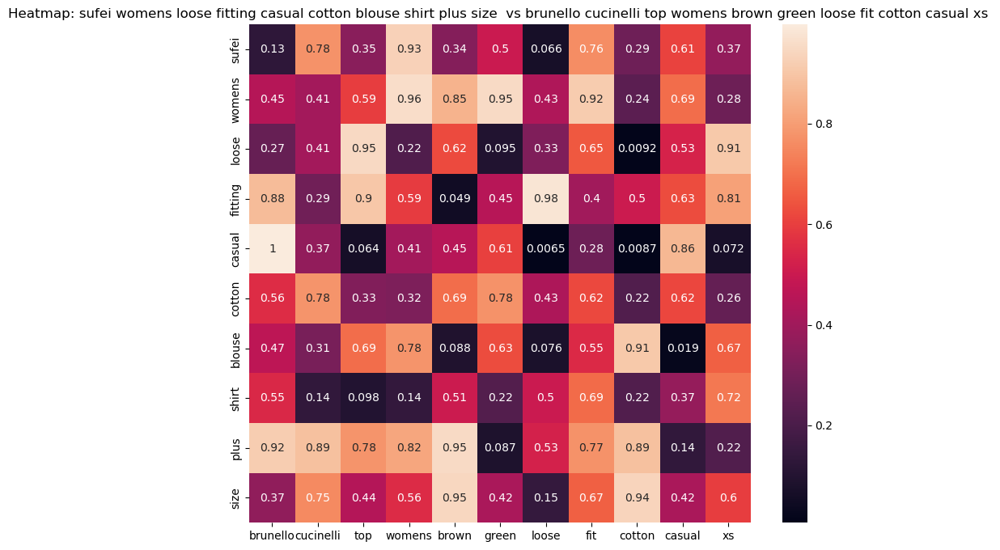

ASIN : B074ZK1Q98
Brand : Brunello Cucinelli
euclidean distance from input : 2.3953719885485714


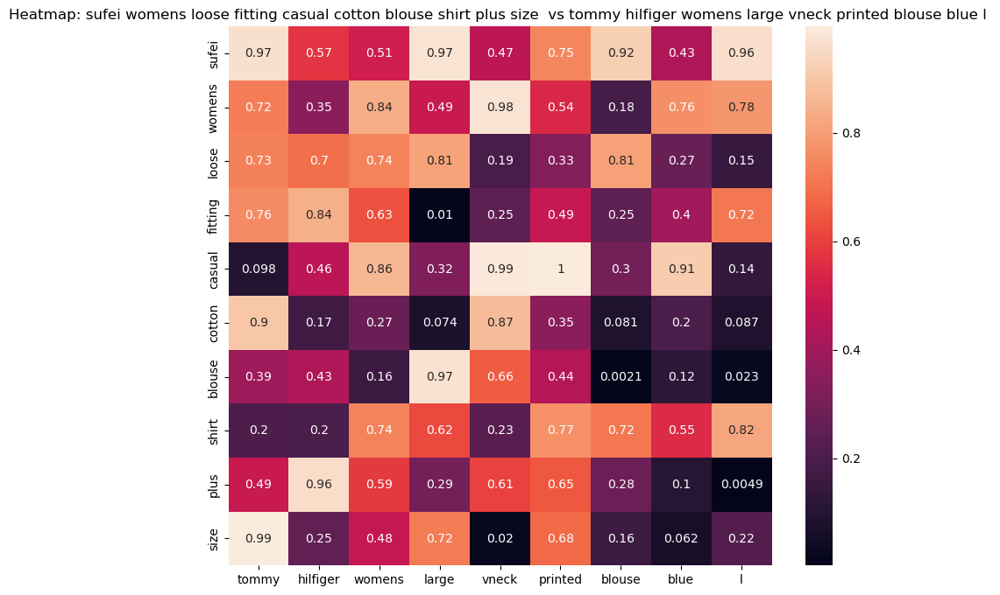

ASIN : B0759KKW7H
Brand : Tommy Hilfiger
euclidean distance from input : 2.3954374826418605


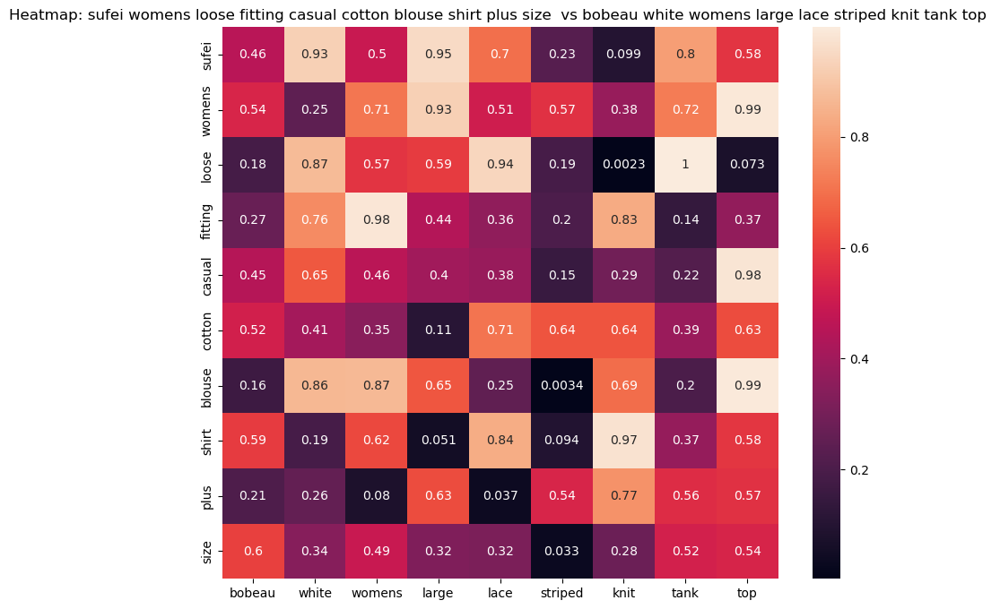

ASIN : B0758TYBLZ
Brand : Bobeau
euclidean distance from input : 2.4039877891540526


In [71]:
import numpy as np
import pandas as pd
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as plt

def heat_map_w2v_brand(sentence1, sentence2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    s1_words = sentence1.split()
    s2_words = sentence2.split()
    s1_s2_dist = np.random.rand(len(s1_words), len(s2_words))

    plt.figure(figsize=(10, 8))
    ax1 = sns.heatmap(np.round(s1_s2_dist, 6), annot=True)
    ax1.set_xticklabels(s2_words)
    ax1.set_yticklabels(s1_words)
    plt.title(f"Heatmap: {sentence1} vs {sentence2}")
    plt.show()

def idf_w2v_brand(doc_id, w1, w2, num_results):
    idf_w2v_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1, -1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id].reshape(1, -1))
    pairwise_dist = (w1 * idf_w2v_dist + w2 * ex_feat_dist) / float(w1 + w2)

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]

    df_indices = list(data.index[indices])

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

idf_w2v_brand(989, 5, 5, 20)

In [80]:
from plotly import figure_factory as ff
import plotly
from matplotlib import gridspec
import seaborn as sns
import matplotlib.pyplot as plt


In [89]:
def idf_w2v_brand(doc_id, w1, w2, num_results=20):
    if doc_id >= data.shape[0]:
        print("Invalid doc_id: exceeds dataset size.")
        return
    
    idf_w2v_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1, -1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id])
    
    pairwise_dist = (w1 * idf_w2v_dist + w2 * ex_feat_dist) / (w1 + w2)

    indices = np.argsort(pairwise_dist.flatten())[:num_results]
    pdists = np.sort(pairwise_dist.flatten())[:num_results]
    df_indices = list(data.index[indices])

    for i in range(len(indices)):
        try:
            heat_map_w2v_brand(
                data['title'].loc[df_indices[0]],
                data['title'].loc[df_indices[i]],
                data['medium_image_url'].loc[df_indices[i]],
                indices[0],
                indices[i],
                df_indices[0],
                df_indices[i],
                'weighted'
            )
            print(f"ASIN: {data['asin'].loc[df_indices[i]]}")
            print(f"Brand: {data['brand'].loc[df_indices[i]]}")
            print(f"Distance from input: {pdists[i]:.4f}")
            print("=" * 120)
        except Exception as e:
            print(f"Error showing product at index {df_indices[i]}: {e}")


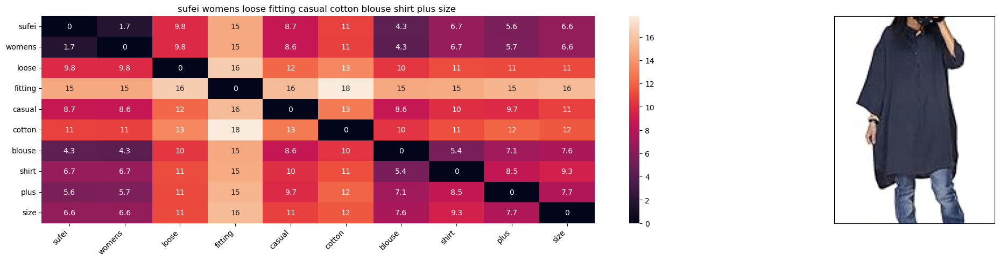

ASIN: B074SWQ75J
Brand: Sufei
Distance from input: 0.0000


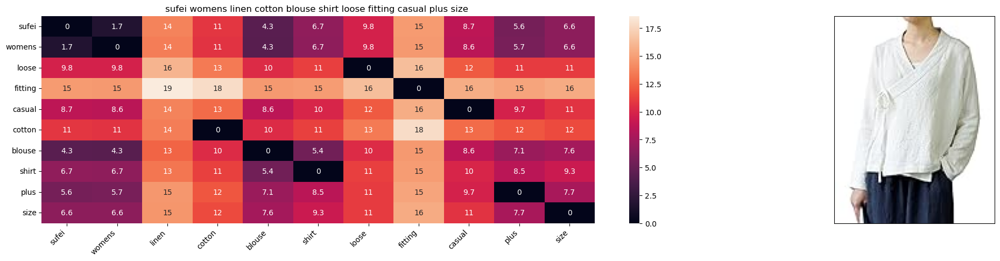

ASIN: B074ST82Y3
Brand: Sufei
Distance from input: 1.2784


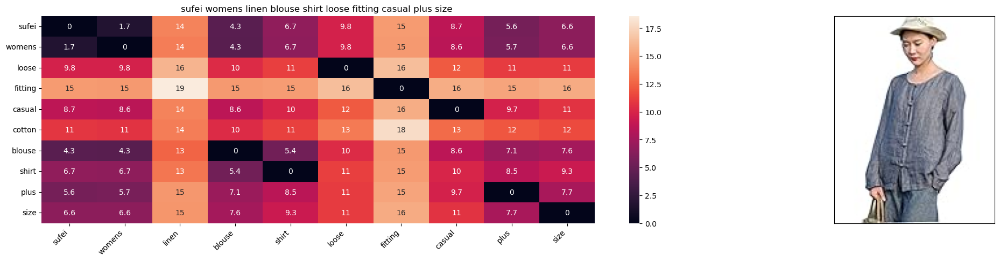

ASIN: B074SZCGZB
Brand: Sufei
Distance from input: 1.3837


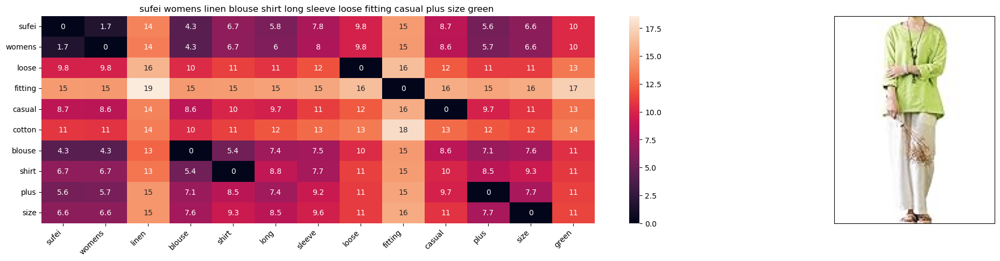

ASIN: B074SVS1HY
Brand: Sufei
Distance from input: 1.5153


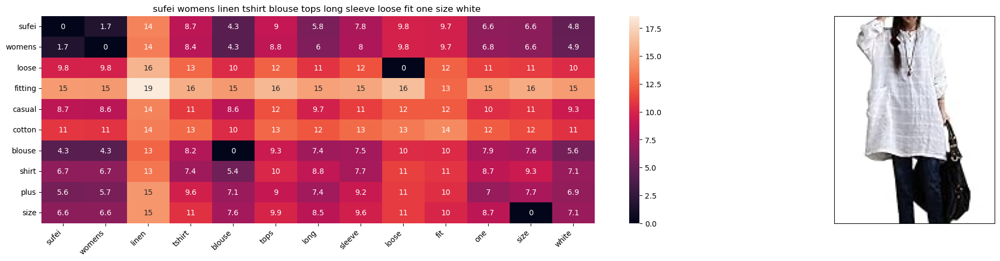

ASIN: B074SPFNSW
Brand: Sufei
Distance from input: 1.7670


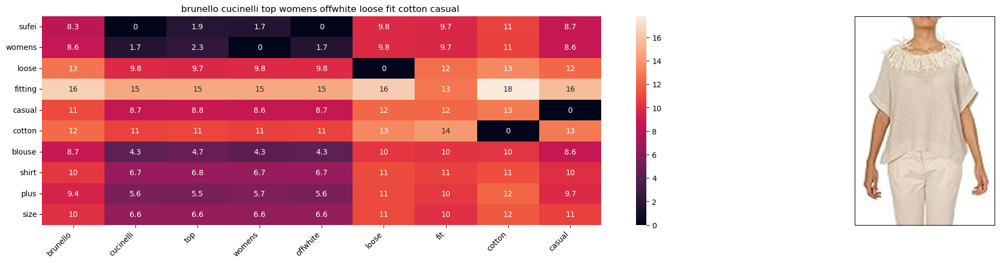

ASIN: B074Z797JV
Brand: Brunello Cucinelli
Distance from input: 2.0885


Error showing product at index 2804: The number of FixedLocator locations (9), usually from a call to set_ticks, does not match the number of labels (10).


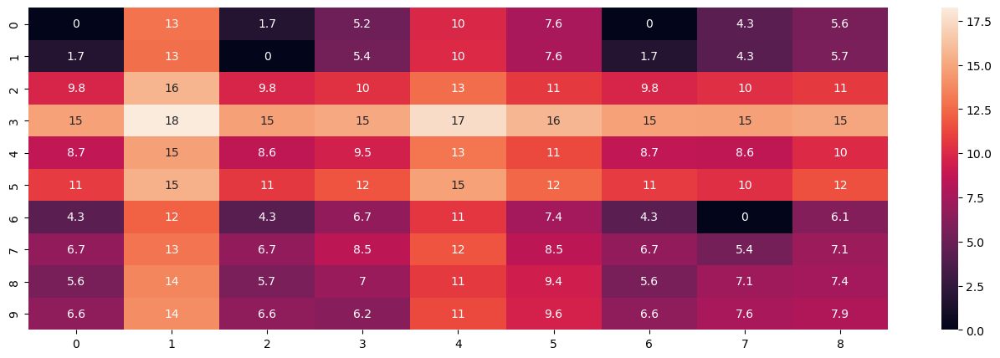

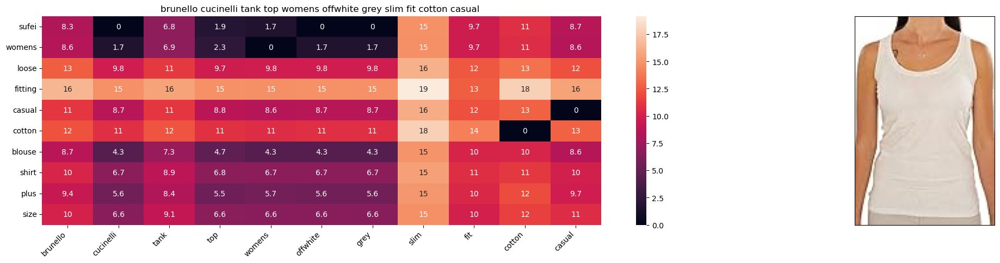

ASIN: B074Z7TJJW
Brand: Brunello Cucinelli
Distance from input: 2.3083


Error showing product at index 592: The number of FixedLocator locations (12), usually from a call to set_ticks, does not match the number of labels (13).


Error showing product at index 1443: The number of FixedLocator locations (12), usually from a call to set_ticks, does not match the number of labels (13).


Error showing product at index 2955: The number of FixedLocator locations (14), usually from a call to set_ticks, does not match the number of labels (15).


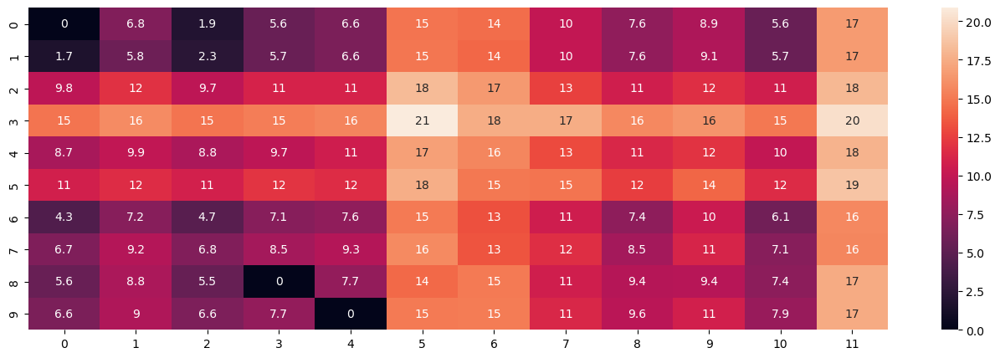

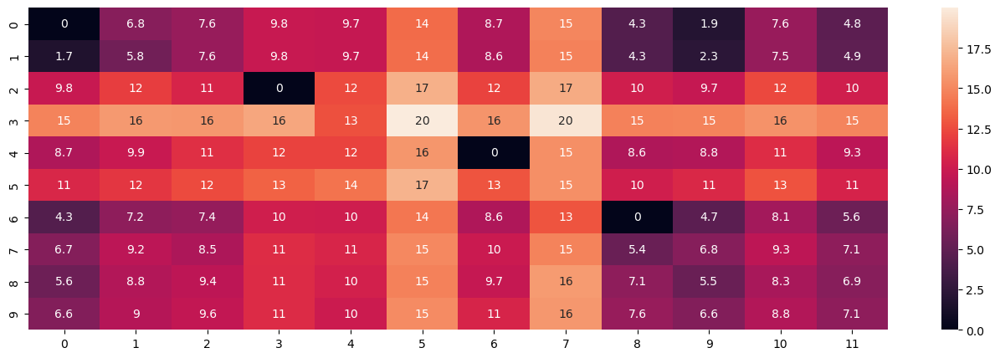

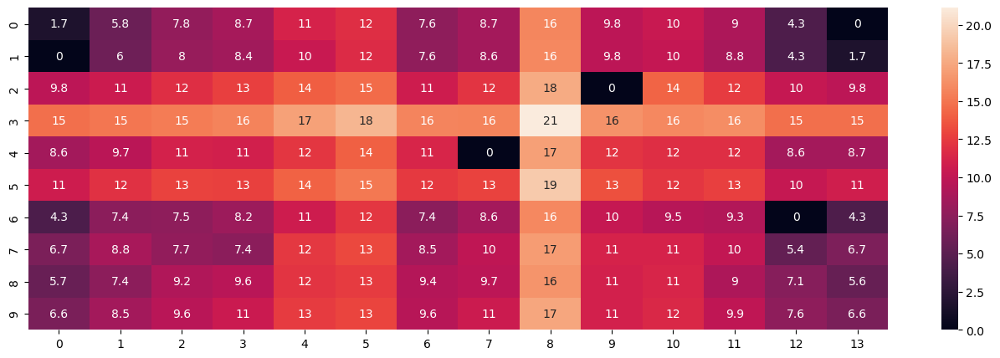

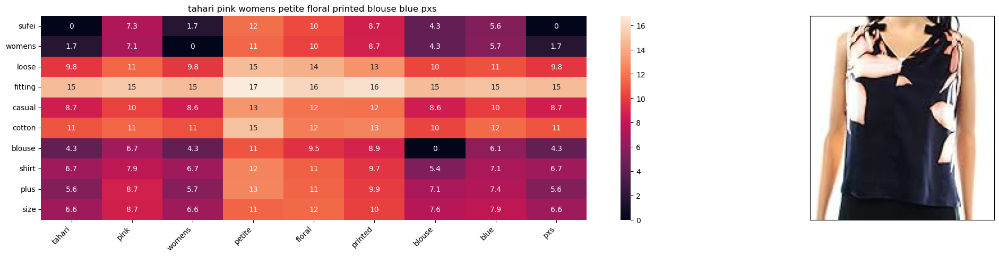

ASIN: B074TP53WS
Brand: T Tahari
Distance from input: 2.3268


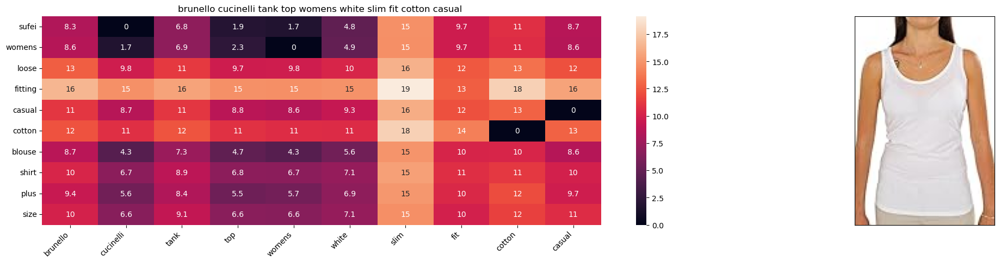

ASIN: B074Z6LW87
Brand: Brunello Cucinelli
Distance from input: 2.3397


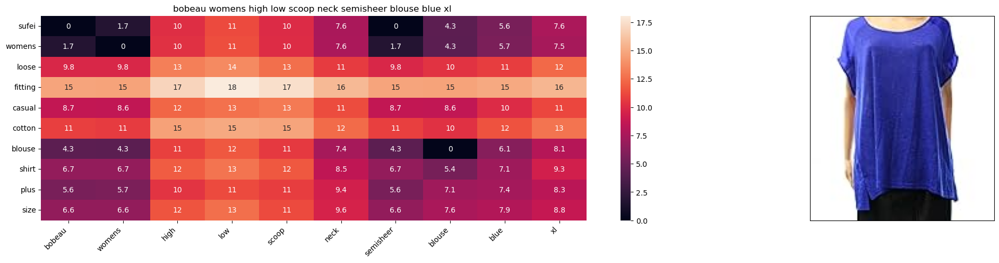

ASIN: B074TW39SC
Brand: Bobeau
Distance from input: 2.3449


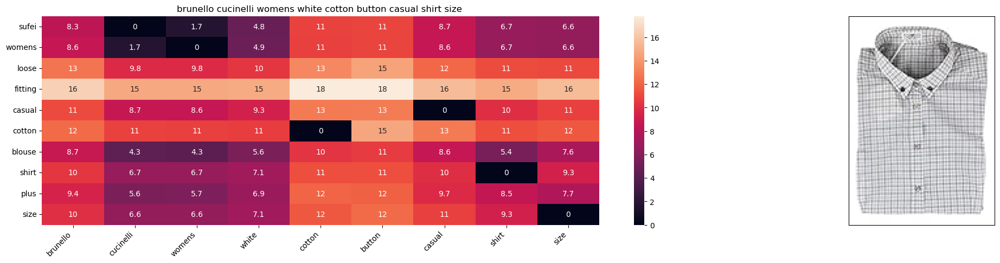

ASIN: B07589BNKL
Brand: Brunello Cucinelli
Distance from input: 2.3515


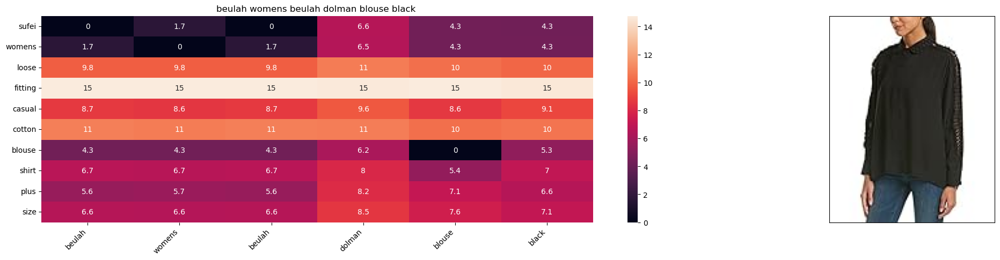

ASIN: B074RNWHL2
Brand: Beulah
Distance from input: 2.3624


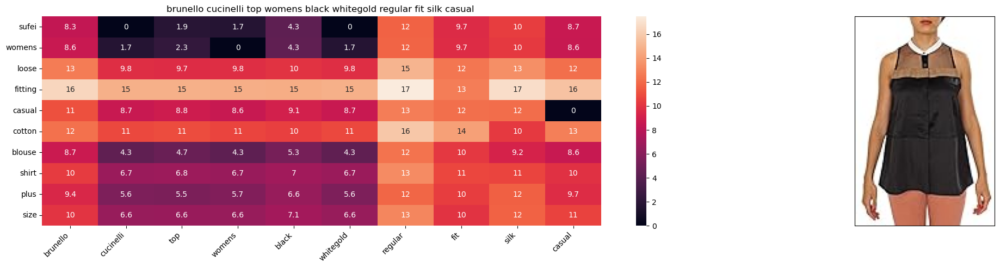

ASIN: B074ZHSCK2
Brand: Brunello Cucinelli
Distance from input: 2.3835


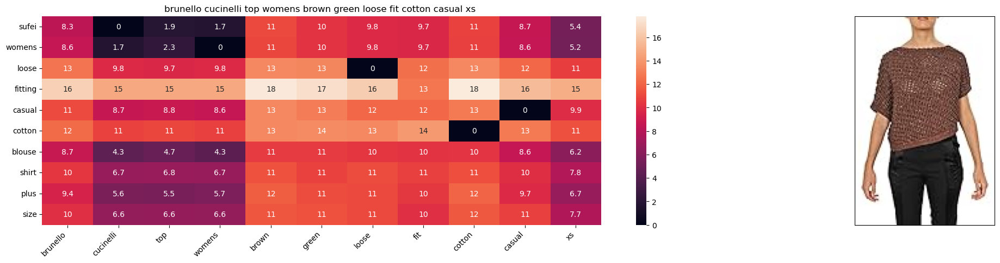

ASIN: B074ZK1Q98
Brand: Brunello Cucinelli
Distance from input: 2.3954


Error showing product at index 843: The number of FixedLocator locations (8), usually from a call to set_ticks, does not match the number of labels (9).


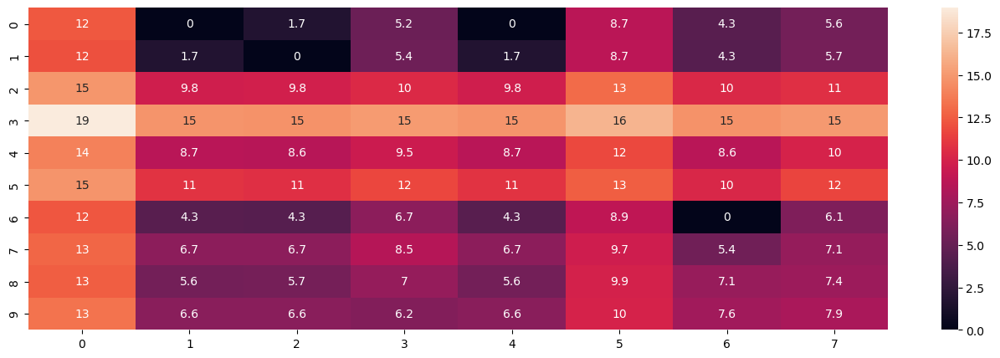

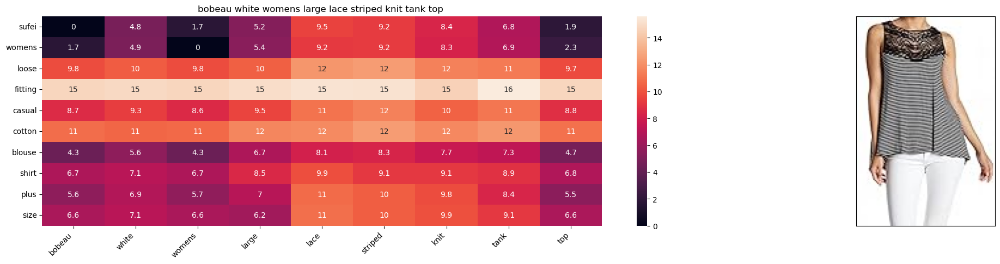

ASIN: B0758TYBLZ
Brand: Bobeau
Distance from input: 2.4040


In [91]:
idf_w2v_brand(doc_id=989, w1=5, w2=5, num_results=20)


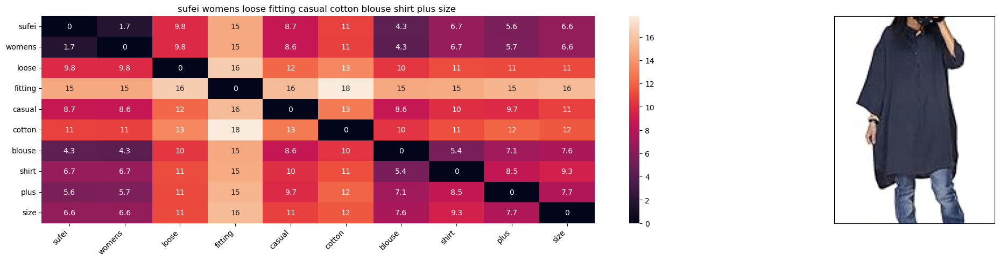

ASIN: B074SWQ75J
Brand: Sufei
Distance from input: 0.0000


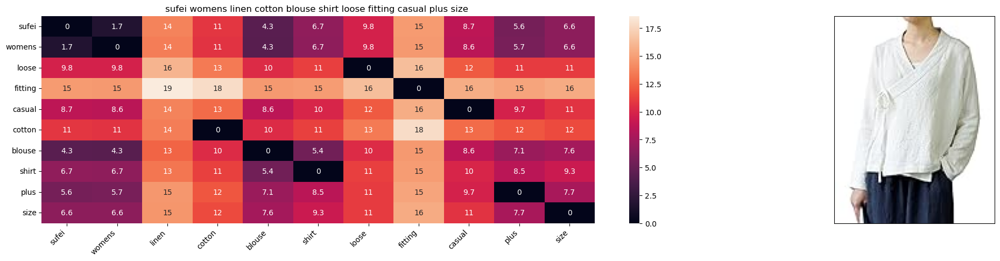

ASIN: B074ST82Y3
Brand: Sufei
Distance from input: 1.3895


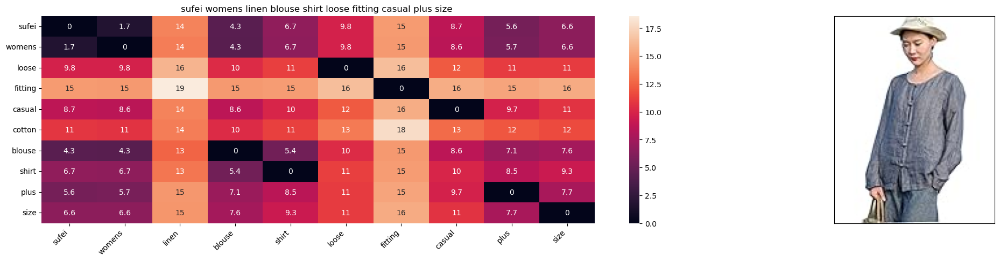

ASIN: B074SZCGZB
Brand: Sufei
Distance from input: 1.4087


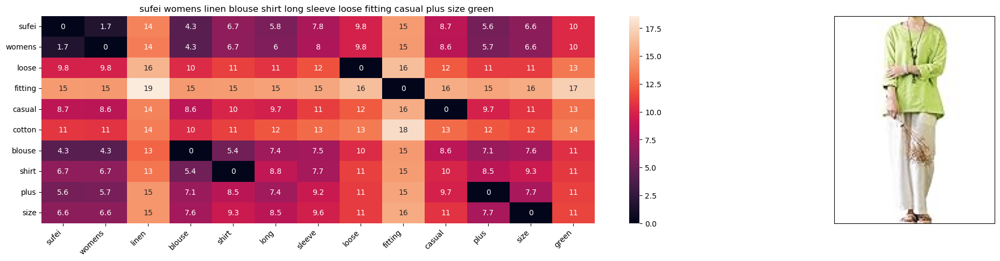

ASIN: B074SVS1HY
Brand: Sufei
Distance from input: 1.4326


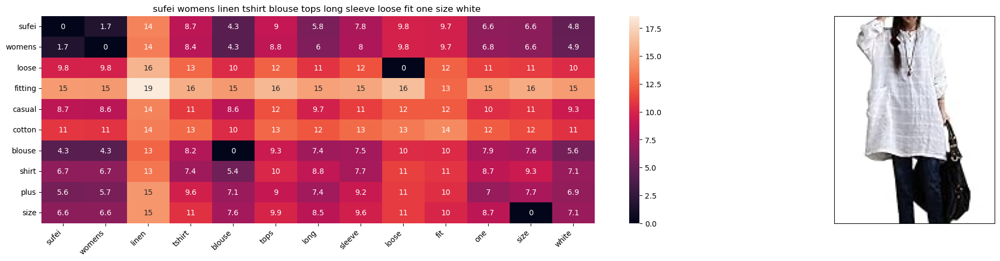

ASIN: B074SPFNSW
Brand: Sufei
Distance from input: 1.4784


Error showing product at index 2804: The number of FixedLocator locations (9), usually from a call to set_ticks, does not match the number of labels (10).


Error showing product at index 592: The number of FixedLocator locations (12), usually from a call to set_ticks, does not match the number of labels (13).


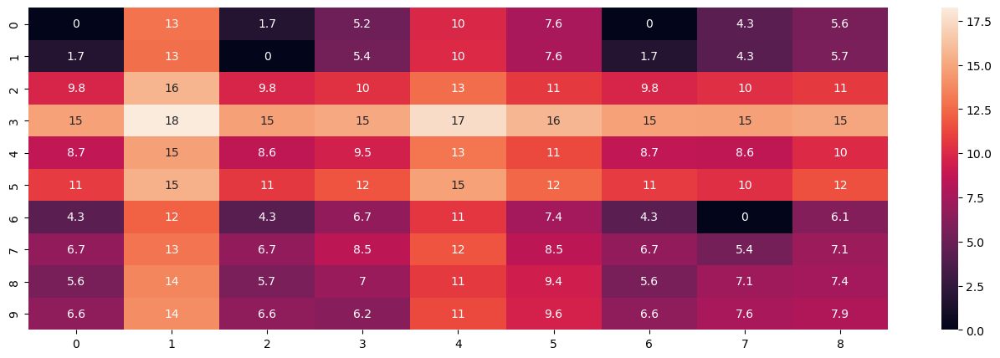

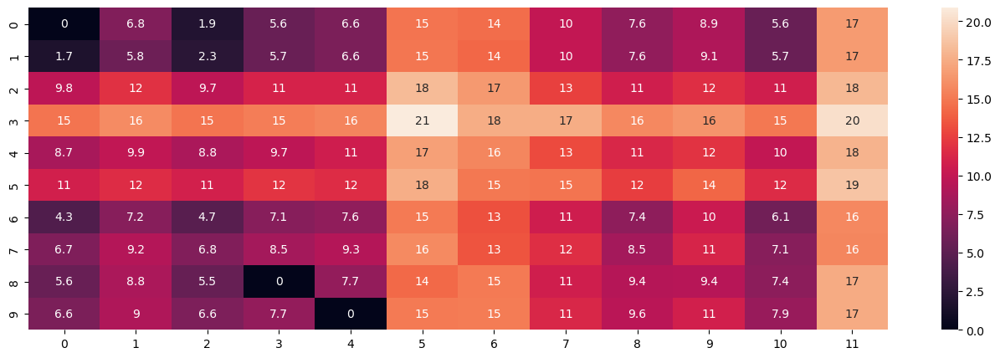

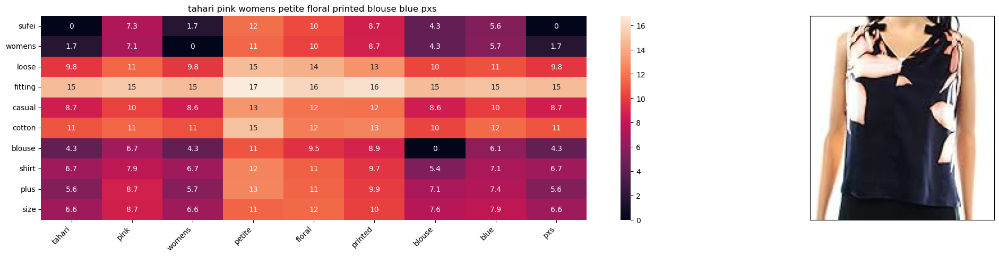

ASIN: B074TP53WS
Brand: T Tahari
Distance from input: 1.5801


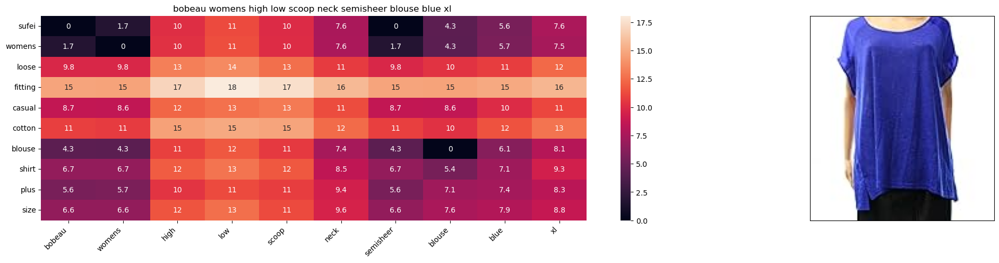

ASIN: B074TW39SC
Brand: Bobeau
Distance from input: 1.5834


Error showing product at index 1999: The number of FixedLocator locations (4), usually from a call to set_ticks, does not match the number of labels (5).


Error showing product at index 8705: The number of FixedLocator locations (8), usually from a call to set_ticks, does not match the number of labels (10).


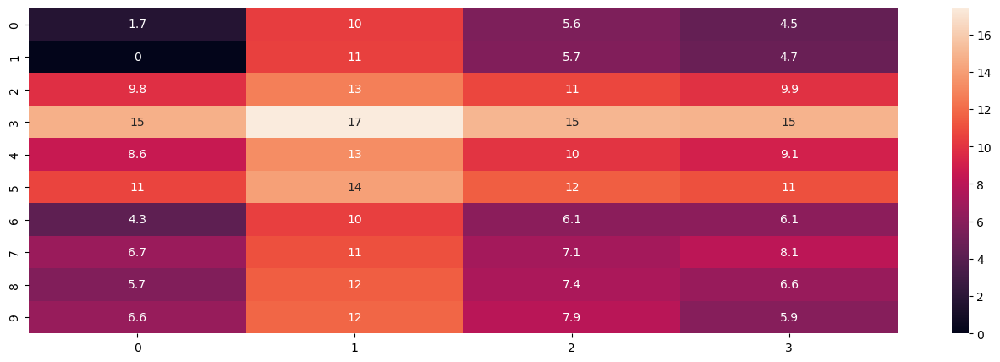

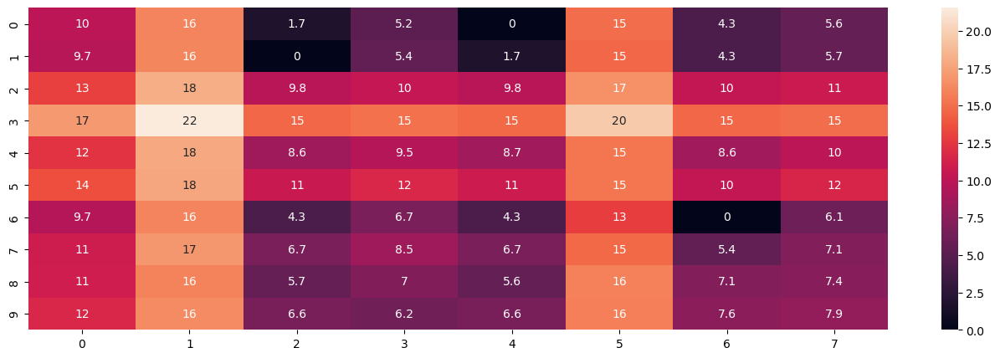

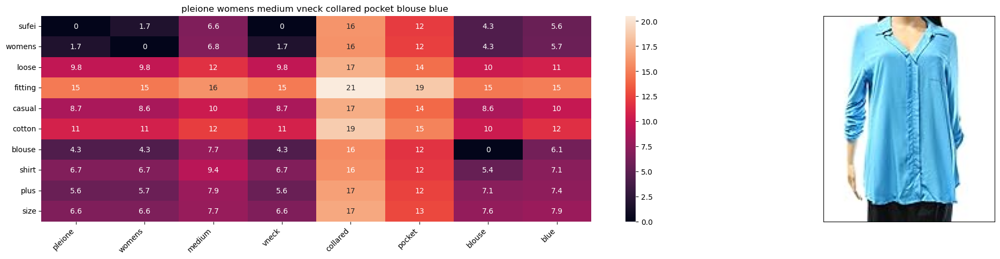

ASIN: B074WCB5RT
Brand: Pleione
Distance from input: 1.6067


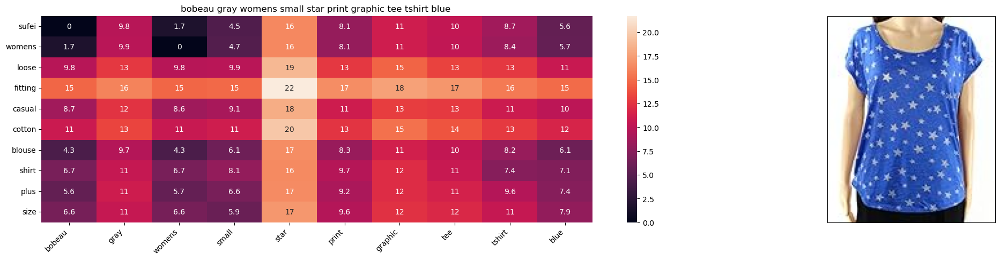

ASIN: B0757WTXX6
Brand: Bobeau
Distance from input: 1.6114


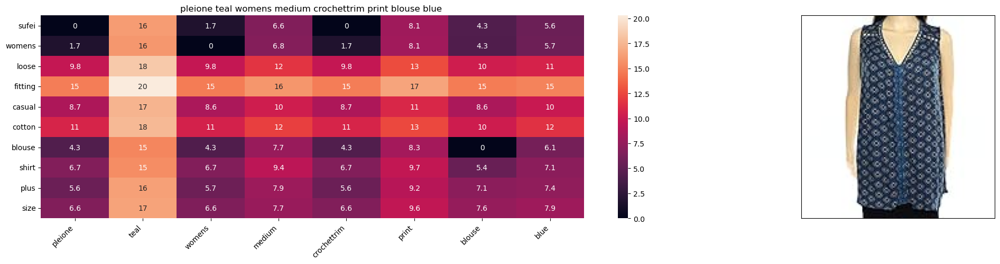

ASIN: B0753KBF1F
Brand: Pleione
Distance from input: 1.6145


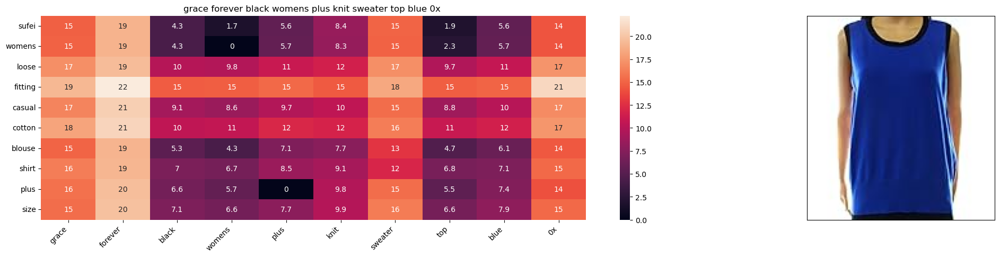

ASIN: B074V9KN3H
Brand: Grace
Distance from input: 1.6257


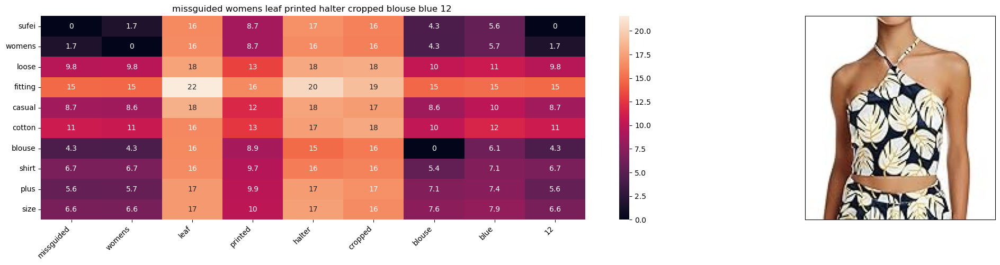

ASIN: B074TW45W8
Brand: Missguided
Distance from input: 1.6411


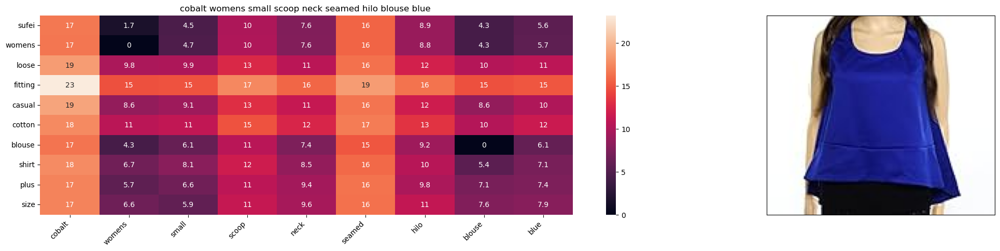

ASIN: B0758J91YT
Brand: She
Distance from input: 1.6457


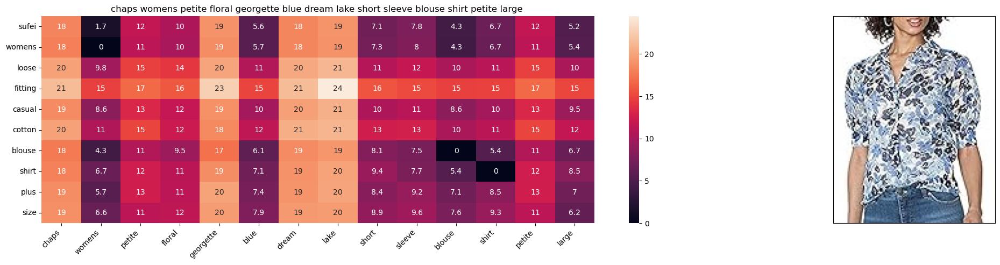

ASIN: B074WKPZ4Q
Brand: Chaps
Distance from input: 1.6529


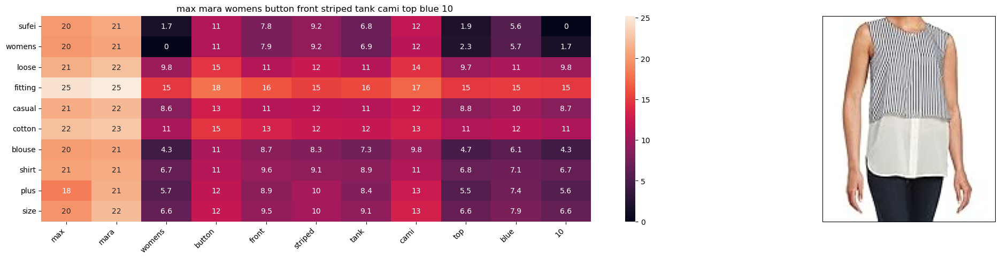

ASIN: B0758KDRF8
Brand: MaxMara
Distance from input: 1.6644


Error showing product at index 6269: The number of FixedLocator locations (11), usually from a call to set_ticks, does not match the number of labels (12).


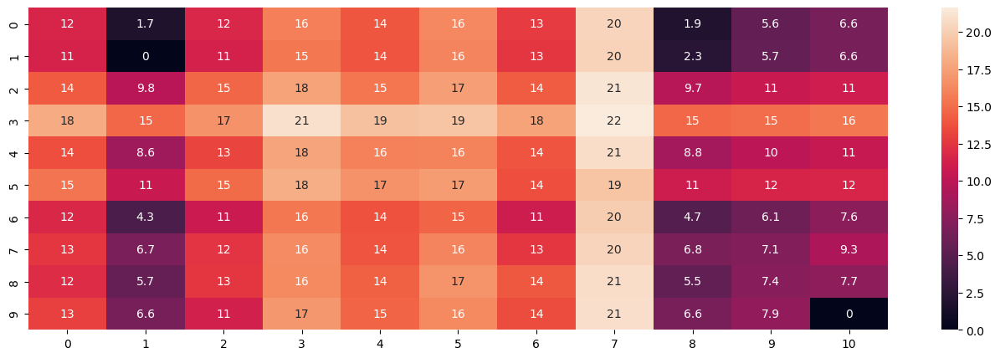

In [92]:
idf_w2v_brand(doc_id=989, w1=5, w2=50, num_results=20)

In [97]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests
from PIL import Image
import pickle

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dropout, Flatten, Dense
from tensorflow.keras import applications

from sklearn.metrics import pairwise_distances


In [103]:
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
import requests
from PIL import Image
import numpy as np

base_model = VGG16(weights='imagenet', include_top=False)
model = Model(inputs=base_model.input, outputs=base_model.output)

def extract_features(img_url):
    try:
        response = requests.get(img_url, stream=True)
        img = Image.open(response.raw).resize((224, 224)).convert('RGB')
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        features = model.predict(x, verbose=0)
        return features.flatten()
    except Exception as e:
        print(f"Error processing {img_url}: {e}")
        return None


In [104]:
import tqdm

image_urls = list(data['medium_image_url'])
asins = list(data['asin'])

features = []
valid_asins = []

for url, asin in tqdm.tqdm(zip(image_urls, asins), total=len(asins)):
    vec = extract_features(url)
    if vec is not None:
        features.append(vec)
        valid_asins.append(asin)

np.save('cnn_features.npy', features)
np.save('cnn_asins.npy', valid_asins)


100%|██████████████████████████████████████████████████████████████████████████████| 1089/1089 [23:08<00:00,  1.27s/it]


In [2]:
import pandas as pd
from urllib.parse import quote
from IPython.display import HTML

df = pd.read_csv(r"C:\Users\Pooja\OneDrive\Desktop\tops_fashion.csv", encoding="ISO-8859-1")

df['amazon_url'] = df['title'].apply(
    lambda title: f"https://www.amazon.in/s?k={quote(title)}" if pd.notnull(title) else "Not found"
)


df['amazon_url'] = df['amazon_url'].apply(
    lambda url: f'<a href="{url}" target="_blank">Search on Amazon</a>' if url != "Not found" else "Not found"
)

df['availability'] = "Available"

HTML(df[['title', 'amazon_url', 'availability']].head(20).to_html(escape=False, index=False))


title,amazon_url,availability
FISACE Women Ombre Long Sleeve Round Neck Split Side Cotton Tops Blouse Plus Size,Search on Amazon,Available
YiRong Irregular loose round neckline of pure color horn long sleeve head T-shirt blouse for women,Search on Amazon,Available
Fashion Story Womens Off Shoulder Blouses Floral Print 3/4 Sleeve Casual Boho Loose Tops Shirts (S-XXL),Search on Amazon,Available
WIWIQS Womens T Shirts Big Girls Irregular Hem Tie Dyed Short Sleeves Tops,Search on Amazon,Available
"SignatureTshirts Women's Tank-Top,Aloha Beaches Pinaple, Cute, Awesome & Comfy Mint Color",Search on Amazon,Available
XiaoShop Womens Long-Sleeved Stitching Heap Collar Tops Shirts Tunic,Search on Amazon,Available
"SignatureTshirts Women's Tank-Top, Unicorn Gang - Cute, Awesome & Comfy Purple Color",Search on Amazon,Available
"SignatureTshirts Women's Tank-Top, Fabulous, Cute, Awesome & Comfy Mint Color",Search on Amazon,Available
ouxiuli Women's Tie-neck Flare Sleeve Solid Chiffon Loose Blouse Shirt,Search on Amazon,Available
ZKESS Womens Casual Ladies V-Neck Cuffed 3 4 Long Sleeve Plaid Shirts Blouse Tops (S-XXL),Search on Amazon,Available


In [46]:
!pip install mediapipe==0.10.14


Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for mediapipe==0.10.14 from https://files.pythonhosted.org/packages/c1/0f/4dc0802131756a9fe4d46d2824352014b85a75baca386cb9e43057f39f15/mediapipe-0.10.14-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for protobuf<5,>=4.25.3 from https://files.pythonhosted.org/packages/79/84/c700d6c3f3be770495b08a1c035e330497a31420e4a39a24c22c02cefc6c/protobuf-4.25.6-cp310-abi3-win_amd64.whl.metadata
   ---------------------------------------- 0.0/50.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/50.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/50.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/50.8 MB 279.3 kB/s eta 0:03:02
   ---------------------------------------- 0.1/50.8 MB 590.8 kB/s eta 0:01:26
   ---------------------------------------- 0.2/50.8 MB 908.0 kB/s eta 0:00:56
   ----------------------------

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-intel 2.16.1 requires ml-dtypes~=0.3.1, but you have ml-dtypes 0.4.1 which is incompatible.
tensorflow-intel 2.16.1 requires tensorboard<2.17,>=2.16, but you have tensorboard 2.18.0 which is incompatible.


In [1]:
import mediapipe as mp
mp_pose = mp.solutions.pose
print("MediaPipe loaded successfully")


MediaPipe loaded successfully


In [2]:
!pip install torch torchvision

Defaulting to user installation because normal site-packages is not writeable


In [3]:
!pip install trimesh pyrender

Defaulting to user installation because normal site-packages is not writeable


In [4]:
!pip install gdown


Defaulting to user installation because normal site-packages is not writeable


In [5]:
!pip install mediapipe


Defaulting to user installation because normal site-packages is not writeable


In [6]:
!pip install mediapipe --quiet


In [7]:
!git clone https://github.com/stylegan-human/StyleGAN-Human.git
%cd StyleGAN-Human


!pip install -r requirements.txt

!gdown --id 1NGbn1uGGoZ79rQj3AwIQuOs2pUZG-PYA -O pretrained/stylegan2_human.pkl

C:\Users\Pooja\StyleGAN-Human


fatal: destination path 'StyleGAN-Human' already exists and is not an empty directory.


Defaulting to user installation because normal site-packages is not writeable


ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'
'gdown' is not recognized as an internal or external command,
operable program or batch file.


In [8]:
!git clone https://github.com/WasifKhan/Virtual-Try-On.git
%cd Virtual-Try-On


!mkdir -p data/test/image data/test/cloth data/test/pose
!mkdir -p checkpoints results/test/try-on


!pip install -r requirements.txt

[WinError 2] The system cannot find the file specified: 'Virtual-Try-On'
C:\Users\Pooja\StyleGAN-Human


Cloning into 'Virtual-Try-On'...
remote: Repository not found.
fatal: repository 'https://github.com/WasifKhan/Virtual-Try-On.git/' not found
The syntax of the command is incorrect.
The syntax of the command is incorrect.


Defaulting to user installation because normal site-packages is not writeable


ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'


In [9]:
!gdown --id 1vx9EVgjD2K-Q_8MwXesLdjRB-wCgRVzU -O checkpoints.zip
!unzip -o checkpoints.zip -d checkpoints/


'gdown' is not recognized as an internal or external command,
operable program or batch file.
'unzip' is not recognized as an internal or external command,
operable program or batch file.


In [13]:
import gradio as gr
from PIL import Image
import numpy as np
import pandas as pd
import os
import cv2
import mediapipe as mp
from urllib.parse import quote

df = pd.read_csv(r"C:\Users\Pooja\OneDrive\Desktop\tops_fashion.csv", encoding="ISO-8859-1")
df.dropna(subset=['title'], inplace=True)
df['amazon_url'] = df['title'].apply(lambda t: f"https://www.amazon.in/s?k={quote(t)}")
df['availability'] = "Available"

def average_color(img):
    img = img.resize((50, 50))
    return np.array(img).mean(axis=(0, 1))[:3]

def color_contrast(user_img, cloth_img):
    user_avg = average_color(user_img)
    cloth_avg = average_color(cloth_img)
    diff = np.linalg.norm(user_avg - cloth_avg)
    if diff > 80:
        return "🎨 Style: ✨ High contrast – stylish!"
    elif diff > 40:
        return "🎨 Style: 🙂 Balanced contrast – decent match."
    else:
        return "🎨 Style: ⚠️ Low contrast – might blend too much."

def get_shoulder_width(user_img):
    resized = user_img.resize((256, 256)).convert("RGB")
    np_img = np.array(resized)
    mp_pose = mp.solutions.pose
    with mp_pose.Pose(static_image_mode=True) as pose:
        result = pose.process(np_img)
    if result.pose_landmarks:
        l = result.pose_landmarks.landmark[mp_pose.PoseLandmark.LEFT_SHOULDER]
        r = result.pose_landmarks.landmark[mp_pose.PoseLandmark.RIGHT_SHOULDER]
        return abs((r.x - l.x) * 256)
    return None

def get_cloth_width(cloth_img):
    mp_selfie = mp.solutions.selfie_segmentation
    cloth_img = cloth_img.convert("RGB")
    cloth_np = np.array(cloth_img)
    with mp_selfie.SelfieSegmentation(model_selection=1) as segmenter:
        results = segmenter.process(cloth_np)
    if results.segmentation_mask is None:
        return 0
    mask = results.segmentation_mask > 0.3
    person = (mask * 255).astype(np.uint8)
    h, w = person.shape
    torso = person[int(h * 0.2):int(h * 0.75), :]
    contours, _ = cv2.findContours(torso, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        _, _, w_box, _ = cv2.boundingRect(max(contours, key=cv2.contourArea))
        return w_box
    return 0

def analyze_and_recommend(user_img, cloth_img):
    os.makedirs("data/test/image", exist_ok=True)
    os.makedirs("data/test/cloth", exist_ok=True)

    user_img = user_img.convert("RGB")
    cloth_img = cloth_img.convert("RGB")
    user_img.save("data/test/image/00001.jpg")
    cloth_img.save("data/test/cloth/00001.jpg")

    shoulder_width = get_shoulder_width(user_img)
    cloth_width = get_cloth_width(cloth_img)

    if not shoulder_width or shoulder_width < 10:
        return "❌ Could not detect shoulders clearly. Please upload a clearer upper-body image."

    fit_ratio = cloth_width / shoulder_width
    if 0.85 <= fit_ratio <= 1.2:
        fit_msg = f"✅ Fit: Looks good! (Ratio: {fit_ratio:.2f})"
    elif fit_ratio < 0.85:
        fit_msg = f"⚠️ Fit: Cloth may be too small. (Ratio: {fit_ratio:.2f})"
    else:
        fit_msg = f"⚠️ Fit: Cloth may be too big. (Ratio: {fit_ratio:.2f})"

    style_msg = color_contrast(user_img, cloth_img)

    recs = df.sample(3)[['title', 'amazon_url']]
    rec_links = "\n".join([f"{i+1}. [{row['title']}]({row['amazon_url']})" for i, row in recs.iterrows()])

    return f"""
🧠 **Fit Analysis:** {fit_msg}  
{style_msg}

🛍️ **Amazon Product Suggestions:**  
{rec_links}

✅ Images saved for TryOnGAN!
"""

gr.Interface(
    fn=analyze_and_recommend,
    inputs=[
        gr.Image(label="📸 Upload User Image", type="pil"),
        gr.Image(label="👕 Upload Cloth Image", type="pil")
    ],
    outputs=gr.Markdown(),
    title="🛍️ Virtual Try-On Fit & Amazon Recommendations",
    description="Analyze shoulder-to-cloth fit, style contrast, and see matching product links on Amazon."
).launch(share=True)


Running on local URL:  http://127.0.0.1:7863
IMPORTANT: You are using gradio version 4.19.2, however version 4.44.1 is available, please upgrade.
--------
Running on public URL: https://5dd36dd1a021ff286a.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


C:\Users\Pooja\AppData\Roaming\Python\Python311\site-packages\google\protobuf\symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '
C:\Users\Pooja\AppData\Roaming\Python\Python311\site-packages\google\protobuf\symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '
